<div style="background-color:#0a2b45; color:white; padding:25px; border-radius:10px; 
            text-align:center; font-family:'Segoe UI', sans-serif;">

  <h1 style="margin-bottom:8px;">Amazing International Airlines Inc. ✈️</h1>
  <h3 style="margin-top:0; font-style:italic; font-weight:normal; color:#aad8e6;">
     Exploratory Data Analysis
  </h3>

  <hr style="width:60%; border:1px solid #2fa6c9; margin:15px auto;">

  <p style="margin:5px 0; font-size:15px;">
    <b>Group 4</b> - Data Mining Project (2025/2026)
  </p>
  <p style="margin:0; font-size:13px; color:#b5c6d0;">
    Master in Data Science and Advanced Analytics - Nova Information Management School
  </p>
</div>

<br>

<div style="background-color:#132e3e; color:#e2e8f0; padding:15px 20px; border-left:5px solid #2fa6c9; 
            border-radius:6px; font-family:'Segoe UI', sans-serif; font-size:14px;">
  <b>👩‍💻 Project Authors</b><br>
  Pedro Santos - 20250399 - <a href="mailto:20250399@novaims.unl.pt" style="color:#80d0e0;">20250399@novaims.unl.pt</a><br>
  Miguel Correia - 20250381 - <a href="mailto:20250381@novaims.unl.pt" style="color:#80d0e0;">20250381@novaims.unl.pt</a><br>
  Pedro Fernandes - 20250418 - <a href="mailto:20250418@novaims.unl.pt" style="color:#80d0e0;">20250418@novaims.unl.pt</a><br>
  Tiago Duarte - 20250360 - <a href="mailto:20250360@novaims.unl.pt" style="color:#80d0e0;">20250360@novaims.unl.pt</a>
</div>


We are consultants for Amazing International Airlines Inc. (AIAI), an international airline seeking to enhance the personalization of its loyalty program. Our objective is to analyze three years of customer and flight activity data to develop a data-driven segmentation strategy encompassing three complementary perspectives — value-based, behavioral, and demographic — aimed at supporting AIAI in designing targeted marketing actions, optimizing service offerings, and increasing customer retention.

#### Metadata

**CustomerDB:**
| **Variable** | **Description** |
|---------------|----------------|
| **Loyalty#** | Unique customer identifier for loyalty program members |
| **First Name** | Customer's first name |
| **Last Name** | Customer's last name |
| **Customer Name** | Customer's full name (concatenated) |
| **Country** | Customer's country of residence |
| **Province or State** | Customer's province or state |
| **City** | Customer's city of residence |
| **Latitude** | Geographic latitude coordinate of customer location |
| **Longitude** | Geographic longitude coordinate of customer location |
| **Postal code** | Customer's postal/ZIP code |
| **Gender** | Customer's gender |
| **Education** | Customer's highest education level (Bachelor, College, etc.) |
| **Location Code** | Urban/Suburban/Rural classification of customer residence |
| **Income** | Customer's annual income |
| **Marital Status** | Customer's marital status (Married, Single, Divorced) |
| **LoyaltyStatus** | Current tier status in loyalty program (Star > Nova > Aurora) |
| **EnrollmentDateOpening** | Date when customer joined the loyalty program |
| **CancellationDate** | Date when customer left the program |
| **Customer Lifetime Value** | Total calculated monetary value of customer relationship |
| **EnrollmentType** | Method of joining loyalty program |

**FlightsDB:**
| **Variable** | **Description** |
|---------------|----------------|
| **Loyalty#** | Unique customer identifier linking to *CustomerDB* |
| **Year** | Year of flight activity record |
| **Month** | Month of flight activity record (1–12) |
| **YearMonthDate** | First day of the month for the activity period |
| **NumFlights** | Total number of flights taken by customer in the month |
| **NumFlightsWithCompanions** | Number of flights where customer traveled with companions |
| **DistanceKM** | Total distance traveled in kilometers for the month |
| **PointsAccumulated** | Loyalty points earned by customer during the month |
| **PointsRedeemed** | Loyalty points spent/redeemed by customer during the month |
| **DollarCostPointsRedeemed** | Dollar value of points redeemed during the month |

# 1. Importing Libraries and Loading Data

## 1.1. Importing Libraries

In [1]:
import pandas as pd
from sklearn.impute import KNNImputer
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from math import ceil
import math
import folium
from ydata_profiling import ProfileReport

#to ommit warnings
import warnings
warnings.filterwarnings('ignore')

#For better resolution plots
%config InlineBackend.figure_format = 'retina'
sns.set_style("whitegrid")
sns.set_palette("deep")  


## 1.2. Loading Data

In [19]:
customer = pd.read_csv('data/DM_AIAI_CustomerDB.csv')
flights = pd.read_csv('data/DM_AIAI_FlightsDB.csv')
pd.set_option('display.max_columns', None) #To be able too see all columns

In [20]:
customer.head(5)

,Unnamed: 0,Loyalty#,First Name,Last Name,Customer Name,Country,Province or State,City,Latitude,Longitude,Postal code,Gender,Education,Location Code,Income,Marital Status,LoyaltyStatus,EnrollmentDateOpening,CancellationDate,Customer Lifetime Value,EnrollmentType
0,0,480934,Cecilia,Householder,Cecilia Householder,Canada,Ontario,Toronto,43.653225,-79.383186,M2Z 4K1,female,Bachelor,Urban,70146.0,Married,Star,2/15/2019,NaN,3839.14,Standard
1,1,549612,Dayle,Menez,Dayle Menez,Canada,Alberta,Edmonton,53.544388,-113.490930,T3G 6Y6,male,College,Rural,0.0,Divorced,Star,3/9/2019,NaN,3839.61,Standard
2,2,429460,Necole,Hannon,Necole Hannon,Canada,British Columbia,Vancouver,49.282730,-123.120740,V6E 3D9,male,College,Urban,0.0,Single,Star,7/14/2017,1/8/2021,3839.75,Standard
3,3,608370,Queen,Hagee,Queen Hagee,Canada,Ontario,Toronto,43.653225,-79.383186,P1W 1K4,male,College,Suburban,0.0,Single,Star,2/17/2016,NaN,3839.75,Standard
4,4,530508,Claire,Latting,Claire Latting,Canada,Quebec,Hull,45.428730,-75.713364,J8Y 3Z5,male,Bachelor,Suburban,97832.0,Married,Star,10/25/2017,NaN,3842.79,2021 Promotion


In [21]:
customer.tail(5)

,Unnamed: 0,Loyalty#,First Name,Last Name,Customer Name,Country,Province or State,City,Latitude,Longitude,Postal code,Gender,Education,Location Code,Income,Marital Status,LoyaltyStatus,EnrollmentDateOpening,CancellationDate,Customer Lifetime Value,EnrollmentType
16916,15,100012,Ethan,Thompson,Ethan Thompson,Canada,Quebec,Quebec City,46.759733,-71.141009,Y0C 7D6,male,Bachelor,Suburban,NaN,Single,Star,2/27/2019,2/27/2019,NaN,Standard
16917,16,100013,Layla,Young,Layla Young,Canada,Alberta,Edmonton,53.524829,-113.546357,L3S 9Y3,female,Bachelor,Rural,NaN,Married,Star,9/20/2017,9/20/2017,NaN,Standard
16918,17,100014,Amelia,Bennett,Amelia Bennett,Canada,New Brunswick,Moncton,46.051866,-64.825428,G2S 2B6,male,Bachelor,Rural,NaN,Married,Star,11/28/2020,11/28/2020,NaN,Standard
16919,18,100015,Benjamin,Wilson,Benjamin Wilson,Canada,Quebec,Quebec City,46.862970,-71.133444,B1Z 8T3,female,College,Urban,NaN,Married,Star,4/9/2020,4/9/2020,NaN,Standard
16920,19,100016,Emma,Martin,Emma Martin,Canada,British Columbia,Dawson Creek,55.720562,-120.160090,M4A 1E4,female,Master,Suburban,NaN,Single,Star,7/21/2020,7/21/2020,NaN,Standard


In [22]:
# Keep a copy of the original dataset (because we are applying some preprocessing)
customer_original = customer.copy()

Doing the same for the flightsDB:

In [23]:
flights.head(5)

,Loyalty#,Year,Month,YearMonthDate,NumFlights,NumFlightsWithCompanions,DistanceKM,PointsAccumulated,PointsRedeemed,DollarCostPointsRedeemed
0,413052,2021,12,12/1/2021,2.0,2.0,9384.0,938.0,0.0,0.0
1,464105,2021,12,12/1/2021,0.0,0.0,0.0,0.0,0.0,0.0
2,681785,2021,12,12/1/2021,10.0,3.0,14745.0,1474.0,0.0,0.0
3,185013,2021,12,12/1/2021,16.0,4.0,26311.0,2631.0,3213.0,32.0
4,216596,2021,12,12/1/2021,9.0,0.0,19275.0,1927.0,0.0,0.0


In [24]:
flights.tail(5)

,Loyalty#,Year,Month,YearMonthDate,NumFlights,NumFlightsWithCompanions,DistanceKM,PointsAccumulated,PointsRedeemed,DollarCostPointsRedeemed
608431,999902,2019,12,12/1/2019,7.2,0.0,30766.5,3076.65,0.0,0.0
608432,999911,2019,12,12/1/2019,0.0,0.0,0.0,0.00,0.0,0.0
608433,999940,2019,12,12/1/2019,14.4,0.9,18261.0,1826.10,0.0,0.0
608434,999982,2019,12,12/1/2019,0.0,0.0,0.0,0.00,0.0,0.0
608435,999986,2019,12,12/1/2019,0.0,0.0,0.0,0.00,0.0,0.0


In [25]:
flights_original = flights.copy()

# 2. Inicial Analysis

## 2.1 CustomerDB

In [26]:
customer.shape

(16921, 21)

In [27]:
customer.columns

Index(['Unnamed: 0', 'Loyalty#', 'First Name', 'Last Name', 'Customer Name',
       'Country', 'Province or State', 'City', 'Latitude', 'Longitude',
       'Postal code', 'Gender', 'Education', 'Location Code', 'Income',
       'Marital Status', 'LoyaltyStatus', 'EnrollmentDateOpening',
       'CancellationDate', 'Customer Lifetime Value', 'EnrollmentType'],
      dtype='object')

In [28]:
customer.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16921 entries, 0 to 16920
Data columns (total 21 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Unnamed: 0               16921 non-null  int64  
 1   Loyalty#                 16921 non-null  int64  
 2   First Name               16921 non-null  object 
 3   Last Name                16921 non-null  object 
 4   Customer Name            16921 non-null  object 
 5   Country                  16921 non-null  object 
 6   Province or State        16921 non-null  object 
 7   City                     16921 non-null  object 
 8   Latitude                 16921 non-null  float64
 9   Longitude                16921 non-null  float64
 10  Postal code              16921 non-null  object 
 11  Gender                   16921 non-null  object 
 12  Education                16921 non-null  object 
 13  Location Code            16921 non-null  object 
 14  Income                

In [29]:
# Missing values summary: count and percentage
missing_summary = (
    customer.isnull()
    .agg(['sum', 'mean'])
    .T
    .rename(columns={'sum': 'Missing Count', 'mean': 'Missing %'})
)

missing_summary['Missing %'] = missing_summary['Missing %'] * 100
missing_summary = missing_summary.sort_values('Missing %', ascending=False)

display(missing_summary.style.format({'Missing %': '{:.2f}%'}))

,Missing Count,Missing %
CancellationDate,14611.000000,86.35%
Customer Lifetime Value,20.000000,0.12%
Income,20.000000,0.12%
Unnamed: 0,0.000000,0.00%
Gender,0.000000,0.00%
EnrollmentDateOpening,0.000000,0.00%
LoyaltyStatus,0.000000,0.00%
Marital Status,0.000000,0.00%
Location Code,0.000000,0.00%
Education,0.000000,0.00%


In [30]:
customer.duplicated().sum()
# no duplicated lines

np.int64(0)

In [31]:
print(customer["Loyalty#"].duplicated().sum())   

164


In [32]:
print(len(customer["Longitude"].unique()))
print(len(customer["Latitude"].unique()))
print(len(customer["City"].unique()))
print(len(customer["Province or State"].unique()))
print(len(customer["Postal code"].unique()))

49
49
29
11
75


**Initial Analysis**

- The dataset consists of 16 921 records across 19 features.

- There are no duplicated lines in this dataset.

- The following variables contain **missing values**: *'CancellationDate' (86,35%)* , *'Customer Lifetime Value' (0,12%)* and *'Income' (0,12%).*

- 'Unnamed: 0' : This column is going to be discarded as it holds no meaningful information and is not listed in the provided metadata.

- Every value in the Longitude column has exactly 1 unique latitude and every value in the Latitude column has exactly 1 unique longitude. This means that these coordinates represent discrete regional centroids rather than continuous spatial measures. Only 49 unique coordinate pairs exist across 16,921 customers, consistent with city-level data aggregation.

- There are 164 duplicated Loyalty#. As this is the ID column and will be used to merge datasets, there can't be duplicated values. This will be solved later.

- **Data Type** Issues:
    - *'EnrollmentDateOpening'* and *'CancellationDate'*: are objects, but should be datetime, in order to make it possible to calculate time differences and other operations

In [33]:
# EnrollmentDateOpening and CancellationDate to datetime
customer["EnrollmentDateOpening"] = pd.to_datetime(
    customer["EnrollmentDateOpening"], errors="coerce"
)

customer["CancellationDate"] = pd.to_datetime(
    customer["CancellationDate"], errors="coerce"
)

#Drop "Unnamed : 0"
customer.drop(columns=['Unnamed: 0'], inplace=True)

### 2.1.1 Descriptive Statistics

#### 2.1.1.1 Numeric Features

In [34]:
customer.describe().T

,count,mean,min,25%,50%,75%,max,std
Loyalty#,16921.0,550197.393771,100011.0,326823.0,550896.0,772438.0,999999.0,259251.503597
Latitude,16921.0,47.1745,42.984924,44.231171,46.087818,49.28273,60.721188,3.307971
Longitude,16921.0,-91.814768,-135.05684,-120.23766,-79.383186,-74.596184,-52.712578,22.242429
Income,16901.0,37758.0384,0.0,0.0,34161.0,62396.0,99981.0,30368.992499
EnrollmentDateOpening,16921,2018-10-05 09:50:05.567046912,2015-01-27 00:00:00,2017-01-17 00:00:00,2018-10-31 00:00:00,2020-07-09 00:00:00,2021-12-30 00:00:00,NaN
CancellationDate,2308,2019-12-14 06:51:09.670710528,2015-01-27 00:00:00,2019-01-29 18:00:00,2020-01-12 00:00:00,2021-02-13 00:00:00,2021-12-30 00:00:00,NaN
Customer Lifetime Value,16901.0,7990.460188,1898.01,3979.72,5780.18,8945.69,83325.38,6863.173093


- *'Income'* : The mean is left skewed by high-income customers and therefore not representative of the overall population. The median offers a more robust measure (not sensitive to outliers), but it still overlooks the group with zero income. Approximately 25% of records report “0” income, indicating that these likely correspond to missing or unreported values rather than actual income. The maximum value (99981) may represent a system cap, as it is unusually low for the upper income range in Canada. The high standard deviation confirms substantial economic disparity across the customer base. <br>

- *'Customer Lifetime Value'* : CLV distribution is highly right skewed, with a few very valuable customers driving most of the total value. It’s essential to check whether customers with Income = 0 also have systematically lower CLV, which could reveal a link between incomplete demographic data and lower engagement

| **Variable** | **Observations** |
|---------------|------------------|
| **Loyalty#** | - This variable should represent the unique identifier of the dataset. However, there are 164 repeated values.<br>- Only one record per index should be maintained. |
| **Latitude** | - There are only 49 records, combined with 49 mappings to *Longitude*, for all customers.<br>- Since we do not expect all 16,921 customers to live under the same 49 roofs, this feature should be interpreted as a centroid representing customers in the same area. |
| **Longitude** | - The same context as above.<br>- Redundant field: provides the same information as *Latitude*, since one *Latitude* corresponds to one *Longitude* and vice versa — no new information is added.<br>- We should analyse all **location-related features** to determine which one offers the most insightful information. |
| **EnrollmentDateOpening** | - The dates spread from 2015 to 2021.<br>- This variable might be interesting to measure churn and customer retention over time, especially when analysed alongside the *CancellationDate*. |
| **CancellationDate** | - There are only 2,308 records with this date.<br>- We assume that only customers who cancelled their plan have this date populated, while all others are still active.<br>- This feature might be very useful to identify patterns among churned customers and help prevent future cancellations. |
| **Income** | - The income ranges from 0 to **99,981**.<br>- Approximately 25% of records report an income of 0.<br>- This pattern likely represents a case of Missing Not At Random (MNAR), where customers may choose not to disclose their income.<br>- This issue will be addressed in detail later in the analysis. |
| **Customer Lifetime Value (CLV)** | - The CLV ranges from 1,898 to 83,325.38.<br>- The distribution is highly right-skewed, with a small group of customers accounting for a disproportionately large share of total spending.<br>- These high-value customers should be analysed more carefully, as they provide significant value to the company. |



#### 2.1.1.2 Non Numeric Features

In [35]:
customer.describe(include=["object"]).T

,count,unique,top,freq
First Name,16921,4941,Deon,13
Last Name,16921,15404,Salberg,4
Customer Name,16921,16921,Cecilia Householder,1
Country,16921,1,Canada,16921
Province or State,16921,11,Ontario,5468
City,16921,29,Toronto,3390
Postal code,16921,75,V6E 3D9,917
Gender,16921,2,female,8497
Education,16921,5,Bachelor,10586
Location Code,16921,3,Suburban,5716


- *'Country'* : Every entry belongs to the country Canada, which has no value for clustering. This column should be dropped.
- *'Postal code'* : 75 unique entries - can be reduced to capture metropolitan zones, by using only the first 3 digits. Will be explored later.
- *'Customer Name'* , *'First Name'* and *'Last Name'* : These have no real value in clustering. Must be dropped.

The majority of people are married, suburban located and hold a bachelor's.
<br>Only 2310 cancelations means that the program has a high fidelization, which can be good to be used to create different rewarding programs.

In [36]:
# Unique values for all variables
object_columns = customer.select_dtypes(include=["object"]).columns

for object in object_columns:
    print(object)
    print(customer[object].unique())
    print()

First Name
['Cecilia' 'Dayle' 'Necole' ... 'Juliann' 'Olivia' 'Liam']

Last Name
['Householder' 'Menez' 'Hannon' ... 'Bennett' 'Wilson' 'Martin']

Customer Name
['Cecilia Householder' 'Dayle Menez' 'Necole Hannon' ... 'Amelia Bennett'
 'Benjamin Wilson' 'Emma Martin']

Country
['Canada']

Province or State
['Ontario' 'Alberta' 'British Columbia' 'Quebec' 'Yukon' 'New Brunswick'
 'Manitoba' 'Nova Scotia' 'Saskatchewan' 'Newfoundland'
 'Prince Edward Island']

City
['Toronto' 'Edmonton' 'Vancouver' 'Hull' 'Whitehorse' 'Trenton' 'Montreal'
 'Dawson Creek' 'Quebec City' 'Moncton' 'Fredericton' 'Ottawa' 'Tremblant'
 'Calgary' 'Whistler' 'Thunder Bay' 'Peace River' 'Winnipeg' 'Sudbury'
 'West Vancouver' 'Halifax' 'London' 'Victoria' 'Regina' 'Kelowna'
 "St. John's" 'Kingston' 'Banff' 'Charlottetown']

Postal code
['M2Z 4K1' 'T3G 6Y6' 'V6E 3D9' 'P1W 1K4' 'J8Y 3Z5' 'Y2K 6R0' 'P5S 6R4'
 'K8V 4B2' 'H2Y 2W2' 'M8Y 4K8' 'U5I 4F1' 'G1B 3L5' 'H4G 3T4' 'M2M 7K8'
 'M2M 6J7' 'E1A 2A7' 'E3B 2H2' 'M1R 4K3

| **Variable** | **Observations** |
|---------------|------------------|
| **First Name** | - Large number of unique entries, one per customer (as expected).<br>- No analytical relevance for clustering. |
| **Last Name** | - Large number of unique entries, just like the above one.<br>- Can be dropped after integrity verification. |
| **Customer Name** | - Concatenation of first and last names.<br>- Redundant field: offers no new information.<br>- Remove after validation. |
| **Country** | - Single value “Canada”.<br>- Confirms dataset is country-specific.<br>- No variance: should also be excluded from analysis. |
| **Province or State** | - 11 provinces represented across Canada.<br>- Reflects useful regional diversity. |
| **City** | - 29 distinct cities identified.<br>- Provides geographic granularity but high sparsity
| **Postal Code** |- Serves only for geolocation checks.<br>- No analytical contribution to segmentation. |
| **Gender** | - Two categories: *male* and *female*.<br>- Relevant variable.<br>- Balanced distribution expected, encode as binary. |
| **Education** | - Five ordered levels: High School → Doctor.<br>- Ordinal variable that reflects  status.<br>- May correlate with income, loyalty tier or costumer lifetime value |
| **Location Code** | - Three types: Urban, Suburban, Rural.<br>- Indicates density and accessibility of customer location.<br>- Potentially influences travel frequency (must be checked later). |
| **Marital Status** | - Categories: Single, Married, Divorced.<br>- May shape travel purpose (solo, family, or leisure).<br>- Keep for behavioral segmentation. |
| **LoyaltyStatus** | - Three tiers: Star -> Nova -> Aurora.<br>- Represents customer loyalty level and value.<br>- Critical for value-based segmentation. |
| **EnrollmentDateOpening** | - Membership start date.<br>- Enables calculation of membership duration (using cancellation date).<br>- Useful for loyalty lifecycle analysis. |
| **CancellationDate** | - Contains valid dates and missing values.<br>- Missing = active customers.<br>- Allows creation of `IsActive`. |
| **EnrollmentType** | - Two categories: Standard, 2021 Promotion.<br>- Reflects different acquisition channels.<br>- May indicate differences in retention or engagement.<br>- If there are a higher retention rate or a higher costumer value from the ones who enrolled with promotion, a new one should be considered. |


## 2.2 FlightsDB

In [37]:
flights.shape

(608436, 10)

In [38]:
flights.columns

Index(['Loyalty#', 'Year', 'Month', 'YearMonthDate', 'NumFlights',
       'NumFlightsWithCompanions', 'DistanceKM', 'PointsAccumulated',
       'PointsRedeemed', 'DollarCostPointsRedeemed'],
      dtype='object')

In [39]:
flights.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 608436 entries, 0 to 608435
Data columns (total 10 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Loyalty#                  608436 non-null  int64  
 1   Year                      608436 non-null  int64  
 2   Month                     608436 non-null  int64  
 3   YearMonthDate             608436 non-null  object 
 4   NumFlights                608436 non-null  float64
 5   NumFlightsWithCompanions  608436 non-null  float64
 6   DistanceKM                608436 non-null  float64
 7   PointsAccumulated         608436 non-null  float64
 8   PointsRedeemed            608436 non-null  float64
 9   DollarCostPointsRedeemed  608436 non-null  float64
dtypes: float64(6), int64(3), object(1)
memory usage: 46.4+ MB


In [40]:
# Missing values summary: count and percentage
missing_summary = (
    flights.isnull()
    .agg(['sum', 'mean'])
    .T
    .rename(columns={'sum': 'Missing Count', 'mean': 'Missing %'})
)

missing_summary['Missing %'] = missing_summary['Missing %'] * 100
missing_summary = missing_summary.sort_values('Missing %', ascending=False)

display(missing_summary.style.format({'Missing %': '{:.2f}%'}))

,Missing Count,Missing %
Loyalty#,0.000000,0.00%
Year,0.000000,0.00%
Month,0.000000,0.00%
YearMonthDate,0.000000,0.00%
NumFlights,0.000000,0.00%
NumFlightsWithCompanions,0.000000,0.00%
DistanceKM,0.000000,0.00%
PointsAccumulated,0.000000,0.00%
PointsRedeemed,0.000000,0.00%
DollarCostPointsRedeemed,0.000000,0.00%


In [41]:
flights.duplicated().sum()

np.int64(2903)

In [42]:
(flights["NumFlights"] < flights["NumFlightsWithCompanions"]).sum()

np.int64(0)

In [43]:
((flights["NumFlights"] == 0.0) & (flights["DistanceKM"] > 0.0)).sum()

np.int64(5901)

**Initial Analysis**

- The dataset consists of 608436 records across 9 features.

- There are 2903 duplicated lines in this dataset.

- No variables contain missing values.

- The combination of Loyalty#, Year, and Month form a unique key. So here, we don't have repeated Loyalty#.

- There are 5,901 months where the customer did not travel, yet the record shows a distance greater than 0 km.

- **Data Type** Issues:
    - *'NumFlights'* and *'NumFlightsWithCompanion'*: are floats, but should be int, since a person can't fly 2.6 times
    - *'YearMonthDate'* is stored as object and should be converted to datetime for temporal analysis.

### 2.2.1 Descriptive Statistics

#### 2.2.1.1 Numeric Features

In [44]:
flights.describe().T

,count,mean,std,min,25%,50%,75%,max
Loyalty#,608436.0,550037.873084,258935.180575,100018.0,326961.00,550834.000,772194.0000,999986.0
Year,608436.0,2020.000000,0.816497,2019.0,2019.00,2020.000,2021.0000,2021.0
Month,608436.0,6.500000,3.452055,1.0,3.75,6.500,9.2500,12.0
NumFlights,608436.0,3.908107,5.057889,0.0,0.00,0.000,7.2000,21.0
NumFlightsWithCompanions,608436.0,0.983944,2.003785,0.0,0.00,0.000,0.9000,11.0
DistanceKM,608436.0,7939.341419,10260.421873,0.0,0.00,856.400,15338.1750,42040.0
PointsAccumulated,608436.0,793.777781,1025.918521,0.0,0.00,85.275,1533.7125,4204.0
PointsRedeemed,608436.0,235.251678,983.233374,0.0,0.00,0.000,0.0000,7496.0
DollarCostPointsRedeemed,608436.0,2.324835,9.725168,0.0,0.00,0.000,0.0000,74.0


- *'NumFlights'* : The mean of 3.9 flights per month is skewed to the left by a small group of highly active travelers, while the median of 0 shows that most members are inactive in a typical month. The high standard deviation (≈5.06) confirms the presence of extreme variability, indicating the coexistence of occasional and frequent flyers within the customer base. <br>

- *'NumFlightsWithCompanions'* : The mean of 0.98 and median of 0 suggest that most customers travel alone, though a few individuals fly frequently with companions (maximum = 11). <br>

- *'DistanceKM'* : The mean monthly distance of 7,939 km reveals a strong right skew, with 75% of customers traveling under 15,000 km and a few reaching 42,000 km. These long-haul flyers likely represent high-value or business segments. <br>

- *'PointsAccumulated'* : The mean of 793 points is influenced by a minority of heavy users, while the median of 86 points shows low earning activity for most members. The gap between quartiles (IQR ≈1,447) indicates heterogeneous engagement with the loyalty program. <br>

- *'PointsRedeemed'* : The distribution is extremely skewed, with a median of 0 and maximum near 7,500, implying that most members rarely redeem points. Occasional large redemptions suggest episodic engagement peaks, possibly linked to reward thresholds. <br>

- *'DollarCostPointsRedeemed'* : The mean of 2.32 and maximum of 74 reveal that redemptions translating directly into monetary value are uncommon. The predominance of zeros (75% of records) implies limited cash-equivalent usage of loyalty points. <br>

| **Variable** | **Observations** |
|---------------|------------------|
| **Loyalty#** | - This variable uniquely identifies each customer per month and per year within the dataset.<br>- It serves as the primary key for linking customer activity over time. |
| **Year** | - Spredding from 2019 to 2021, this might be usefull to compare diferences year-over-year |
| **Month** | - This variable might be usefull to access travel diferences during the year |
| **NumFlights** | - Represents the number of flights taken by a customer in a given month.<br>- Most months show zero flights, which is logical for customers who travel primarily during vacation periods. |
| **NumFlightsWithCompanions** | - Indicates the number of flights taken with companions.<br>- This variable provides insight into behavioral segmentation, distinguishing between solo and social travelers.<br>- The data shows that most customers tend to travel alone. |
| **DistanceKM** | - Represents the total distance traveled (in kilometers) during a given month.<br>- Useful for distinguishing short-haul versus long-haul travelers, which can inform customer segmentation and help identify potential high-value business travelers. |
| **PointsAccumulated** | - Indicates the total loyalty points earned by the customer within the period.<br>- Should be analyzed in correlation with DistanceKM and LoyaltyStatus to determine whether high earners correspond to premium tiers.<br>- Consider normalizing by distance or number of flights to evaluate point-earning efficiency. |
| **PointsRedeemed** | - Represents the total loyalty points redeemed by the customer.<br>- A useful derived metric is the Redemption Ratio = *PointsRedeemed / PointsAccumulated*, which quantifies engagement and helps identify inactive or low-engagement customers. |
| **DollarCostPointsRedeemed** | - Represents the monetary value (in dollars) associated with the points redeemed by each customer.<br>- Should be analyzed alongside PointsRedeemed to assess a possible correlation. |


#### 2.2.1.2 Non Numeric Features

In [45]:
flights.describe(include=["object"]).T

,count,unique,top,freq
YearMonthDate,608436,36,12/1/2021,16901


- The only non numeric feature is YearMonthDate, and the variable contains 36 unique values, which aligns perfectly with a 3-year dataset recorded on a monthly basis.

| **Variable** | **Observations** |
|---------------|------------------|
| **YearMonthDate** | - This variable is redundante, since we already have columns 'Year' and 'Month', which are also easier to access. It should be dropped |


# 3. Data Visualization

In [47]:
# --- CustomerDB ---
non_metric_features_customer = [
    "Country", "Province or State",
    "City", "Postal code", "Gender", "Education", "Location Code", 
    "Marital Status", "LoyaltyStatus", "EnrollmentType"
]

metric_features_customer = (
    customer.columns
    .drop(non_metric_features_customer + ["Loyalty#", "First Name", "Last Name", "Customer Name", "EnrollmentDateOpening", "CancellationDate"], errors="ignore")
    .to_list()
)

# --- FlightsDB ---
non_metric_features_flights = ["YearMonthDate"]

metric_features_flights = (
    flights.columns
    .drop(non_metric_features_flights + ["Loyalty#"], errors="ignore")
    .to_list()
)


## 3.1 CustomerDB

### 3.1.1. Numerical Variables' Univariate Analysis

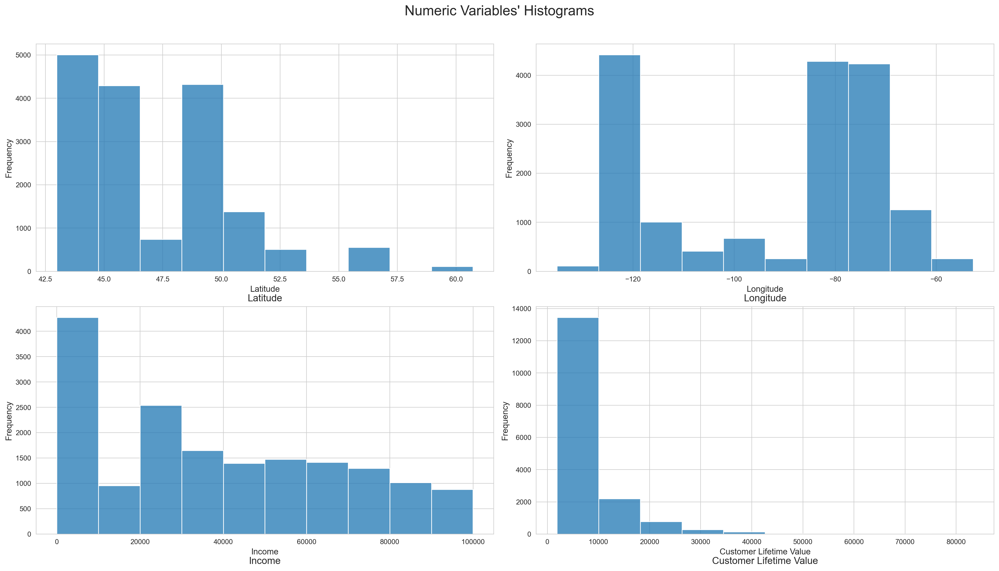

In [126]:
sp_rows = 2
sp_cols = ceil(len(metric_features_customer) / sp_rows)

fig, axes = plt.subplots(
    sp_rows,
    sp_cols,
    figsize=(20, 11),
    tight_layout=True
)

for ax, feat in zip(axes.flatten(), metric_features_customer):
    data = pd.to_numeric(customer[feat], errors="coerce").dropna()
    
    sns.histplot(data, ax=ax, bins=10)
    
    ax.set_title(feat, fontsize=14, y=-0.15)
    ax.set_xlabel(feat, fontsize=12)
    ax.set_ylabel("Frequency", fontsize=12)
    ax.tick_params(axis="both", which="major", labelsize=10)

plt.suptitle(
    "Numeric Variables' Histograms",
    fontsize=20,
    y=1.02
)
plt.show()

- *'Latitude'* and *'Longitude'*: Knowing that there are 49 unique latitude and longitude points, it can be seen that there are clear peaks in some points.

- *'Income'* : As was expected, very right skewed with many zeros. A wide dispersion among the valid entries suggests income heterogeneity.

- *'Customer Lifetime Value'* : Highly skewed, and also has lower frequency values that are not shown in the plot. To address this, a logarithmic histogram will be used to be able to see all values.

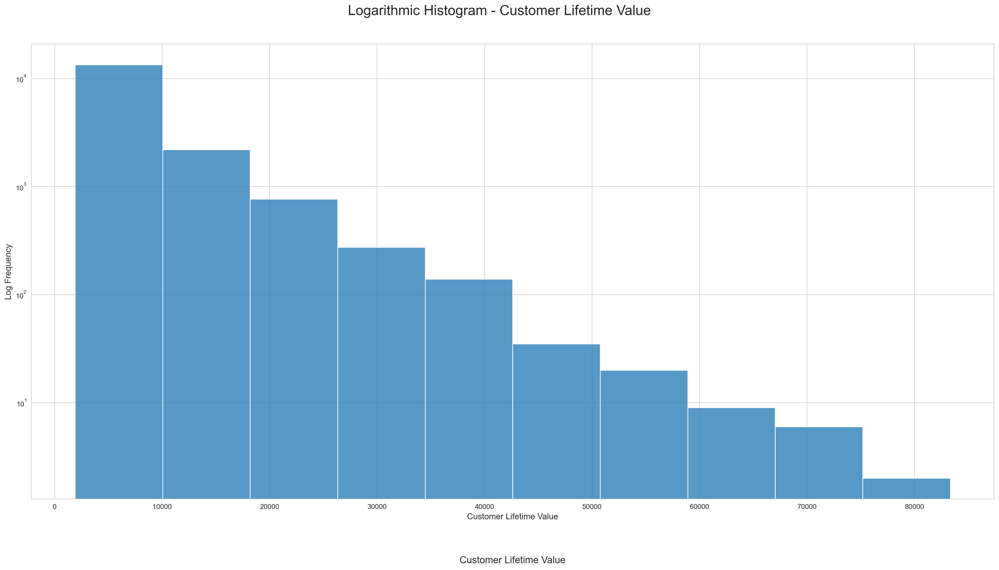

In [124]:
data = pd.to_numeric(
    customer["Customer Lifetime Value"], errors="coerce"
).dropna()


fig, ax = plt.subplots(figsize=(20, 11), tight_layout=True)

sns.histplot(data, ax=ax, bins=10)
ax.set_yscale("log")

ax.set_title("Customer Lifetime Value", fontsize=14, y=-0.15)
ax.set_xlabel("Customer Lifetime Value", fontsize=12)
ax.set_ylabel("Log Frequency", fontsize=12)
ax.tick_params(axis='both', which='major', labelsize=10)

plt.suptitle(
    "Logarithmic Histogram - Customer Lifetime Value",
    fontsize=20,
    y=1.02
)
plt.show()

The logarithmic histogram shows a strong positive skew, meaning that most customers contribute a relatively low lifetime value, while a small group accounts for substantially higher figures. The steep decline across the x-axis and the compression of frequencies on the logarithmic y-scale indicate a distribution where a minority of customers generates the majority of total value.

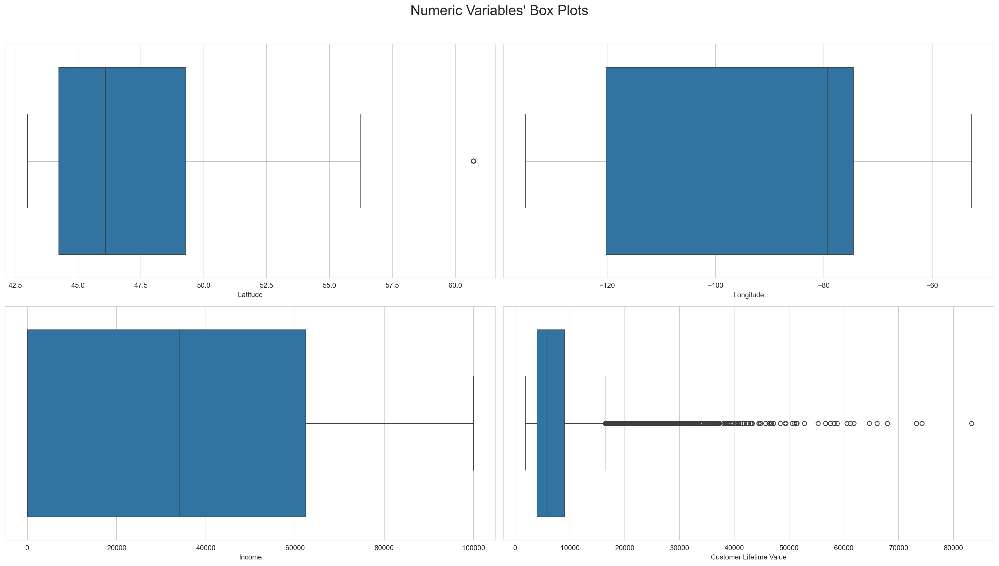

In [127]:
fig, axes = plt.subplots(sp_rows, 
                         sp_cols, 
                         figsize=(20, 11),
                         tight_layout=True)

for ax, feat in zip(axes.flatten(), metric_features_customer):
    data = pd.to_numeric(customer[feat], errors='coerce').dropna()
    sns.boxplot(x=data, ax=ax)
    ax.tick_params(axis='both', which='major', labelsize=10)

plt.suptitle("Numeric Variables' Box Plots", fontsize=20, y=1.02)

plt.show()

- *'Latitude'* : Most customers are concentrated within a latitude range, which suggests that the majority live around a few main regions of Canada. Only a few points appear further away, probably corresponding to northern or less populated areas.

- *'Longitude'* : The values are more spread out, showing that the customers are distributed across the country from east to west.

- *'Income'* : The boxplot revelals a large spread in values, with more customers reporting lower income and only a few reporting high values. This reveals some economic differences among customers (which can affect travel frequency and loyalty behaviour).

- *Customer Lifetime Value'* : The distribution is uneven, with most costumers generating low lifetime value and a small number generating high value (as seen before). A logarithmic transformation will be used once again, to help reduss the skewness.

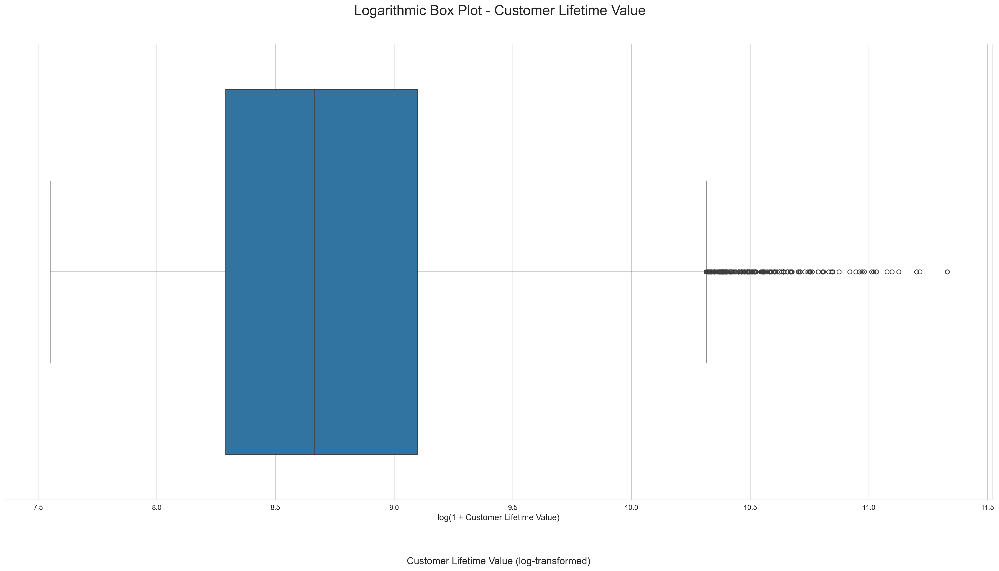

In [128]:
fig, ax = plt.subplots(figsize=(20, 11), tight_layout=True)

data = pd.to_numeric(customer["Customer Lifetime Value"], errors='coerce').dropna()
data_log = np.log1p(data)  
sns.boxplot(x=data_log, ax=ax)

ax.set_title("Customer Lifetime Value (log-transformed)", fontsize=14, y=-0.15)
ax.set_xlabel("log(1 + Customer Lifetime Value)", fontsize=12)
ax.tick_params(axis='both', which='major', labelsize=10)

plt.suptitle("Logarithmic Box Plot - Customer Lifetime Value", fontsize=20, y=1.02)
plt.show()

After applying the logarithmic transformation, the distribution becomes much more balanced, and the scale compresses extreme values that were previously dominant. The boxplot now shows a clearer concentration of customers around the median, while still displaying several outliers on the upper end. These points represent customers whose lifetime value remains significantly higher than the majority, even after the transformation.

This pattern suggests that most customers generate similar moderate levels of value, while a smaller group contributes substantially more to the company’s total revenue. The transformation effectively reduces skewness, making the variable more suitable for clustering and other statistical analyses.

#### 3.1.1.1 Latitude

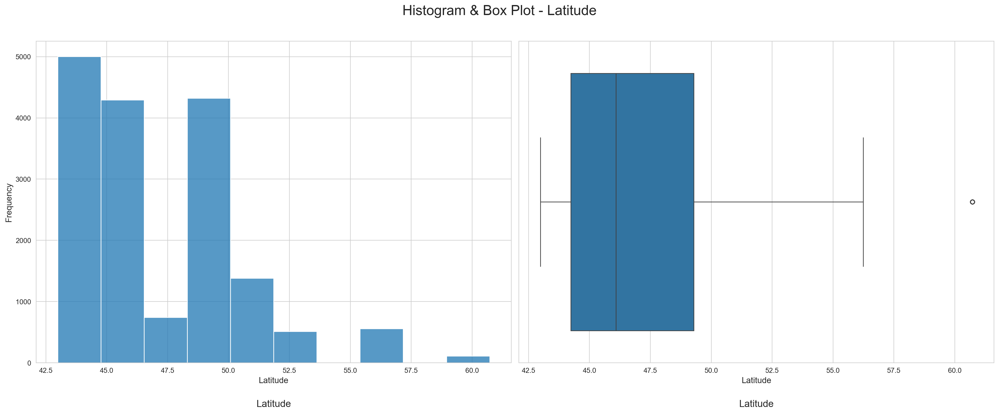

In [129]:
data = pd.to_numeric(customer["Latitude"], errors="coerce").dropna()

fig, axes = plt.subplots(1, 2, figsize=(20, 8), tight_layout=True)

sns.histplot(data, ax=axes[0], bins=10)
axes[0].set_title("Latitude", fontsize=14, y=-0.15)
axes[0].set_xlabel("Latitude", fontsize=12)
axes[0].set_ylabel("Frequency", fontsize=12)
axes[0].tick_params(axis='both', which='major', labelsize=10)

sns.boxplot(x=data, ax=axes[1])
axes[1].set_title("Latitude", fontsize=14, y=-0.15)
axes[1].set_xlabel("Latitude", fontsize=12)
axes[1].tick_params(axis='both', which='major', labelsize=10)

plt.suptitle("Histogram & Box Plot - Latitude", fontsize=20, y=1.02)
plt.show()

#### 3.1.1.2 Longitude

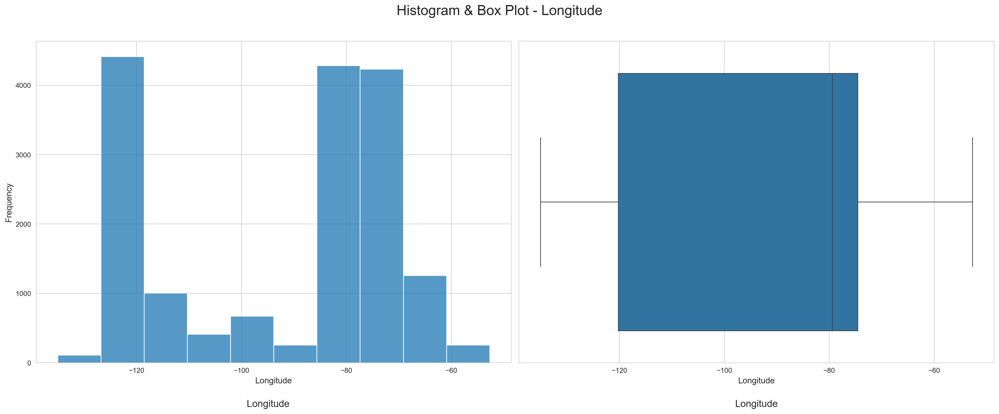

In [130]:
data = pd.to_numeric(customer["Longitude"], errors="coerce").dropna()

fig, axes = plt.subplots(1, 2, figsize=(20, 8), tight_layout=True)

sns.histplot(data, ax=axes[0], bins=10)
axes[0].set_title("Longitude    ", fontsize=14, y=-0.15)
axes[0].set_xlabel("Longitude", fontsize=12)
axes[0].set_ylabel("Frequency", fontsize=12)
axes[0].tick_params(axis='both', which='major', labelsize=10)

sns.boxplot(x=data, ax=axes[1])
axes[1].set_title("Longitude", fontsize=14, y=-0.15)
axes[1].set_xlabel("Longitude", fontsize=12)
axes[1].tick_params(axis='both', which='major', labelsize=10)

plt.suptitle("Histogram & Box Plot - Longitude", fontsize=20, y=1.02)
plt.show()

#### 3.1.1.3 Income

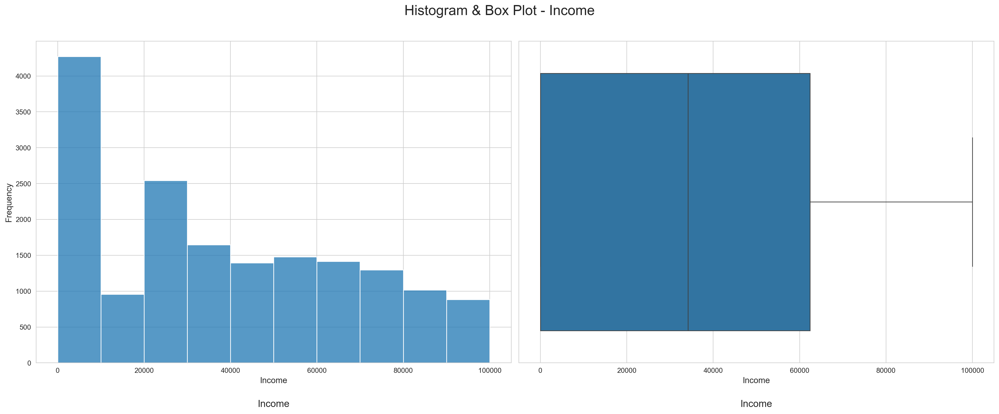

In [131]:
data = pd.to_numeric(customer["Income"], errors="coerce").dropna()

fig, axes = plt.subplots(1, 2, figsize=(20, 8), tight_layout=True)

sns.histplot(data, ax=axes[0], bins=10)
axes[0].set_title("Income", fontsize=14, y=-0.15)
axes[0].set_xlabel("Income", fontsize=12)
axes[0].set_ylabel("Frequency", fontsize=12)
axes[0].tick_params(axis='both', which='major', labelsize=10)

sns.boxplot(x=data, ax=axes[1])
axes[1].set_title("Income", fontsize=14, y=-0.15)
axes[1].set_xlabel("Income", fontsize=12)
axes[1].tick_params(axis='both', which='major', labelsize=10)

plt.suptitle("Histogram & Box Plot - Income", fontsize=20, y=1.02)
plt.show()

#### 3.1.1.4 Customer Lifetime Value

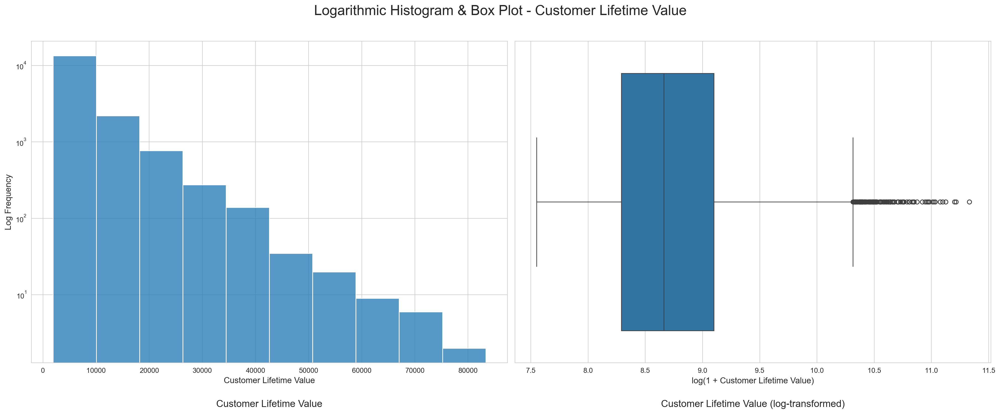

In [132]:
data = pd.to_numeric(customer["Customer Lifetime Value"], errors="coerce").dropna()

fig, axes = plt.subplots(1, 2, figsize=(20, 8), tight_layout=True)

sns.histplot(data, ax=axes[0], bins=10)
axes[0].set_yscale("log")
axes[0].set_title("Customer Lifetime Value", fontsize=14, y=-0.15)
axes[0].set_xlabel("Customer Lifetime Value", fontsize=12)
axes[0].set_ylabel("Log Frequency", fontsize=12)
axes[0].tick_params(axis='both', which='major', labelsize=10)

sns.boxplot(x=data_log, ax=axes[1])
axes[1].set_title("Customer Lifetime Value (log-transformed)", fontsize=14, y=-0.15)
axes[1].set_xlabel("log(1 + Customer Lifetime Value)", fontsize=12)
axes[1].tick_params(axis='both', which='major', labelsize=10)

plt.suptitle(
    "Logarithmic Histogram & Box Plot - Customer Lifetime Value",
    fontsize=20,
    y=1.02
)
plt.show()

### 3.1.2 Categorical Variables' Univariate Analysis

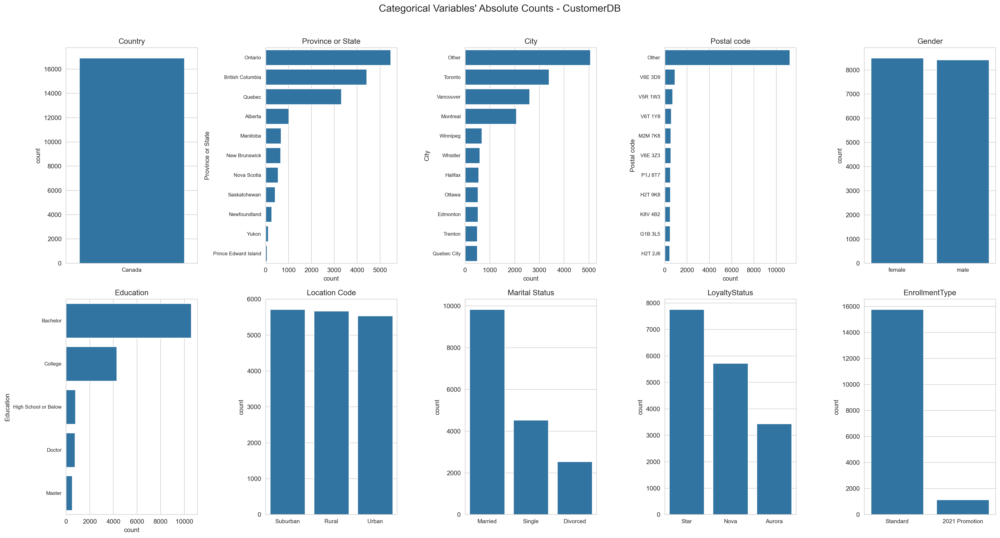

In [135]:
top_cap = {"City": 10, "Postal code": 10}
force_horizontal = {"Province or State", "Education"}

fig, axes = plt.subplots(
    2,
    ceil(len(non_metric_features_customer) / 2),
    figsize=(22, 12)
)

for ax, feat in zip(axes.flatten(), non_metric_features_customer):
    s = customer[feat].astype(str)

    if feat in top_cap or feat in force_horizontal:
        vc = s.value_counts(dropna=False)
        keep = vc.nlargest(top_cap.get(feat, len(vc))).index
        s = s.where(s.isin(keep), "Other")
        sns.countplot(y=s, ax=ax, order=s.value_counts().index)
        ax.set_ylabel(feat)
        ax.set_xlabel("count")
        ax.tick_params(axis='y', labelsize=8)
    else:
        sns.countplot(x=s, ax=ax, order=s.value_counts().index)
        rotate = 45 if s.nunique() > 8 else 0
        ax.tick_params(axis='x', labelrotation=rotate, labelsize=9)
        ax.set_xlabel("")
        ax.set_ylabel("count")

    ax.set_title(feat, fontsize=12)

plt.suptitle("Categorical Variables' Absolute Counts - CustomerDB", fontsize=16, y=0.98)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

#### 3.1.2.1 Country

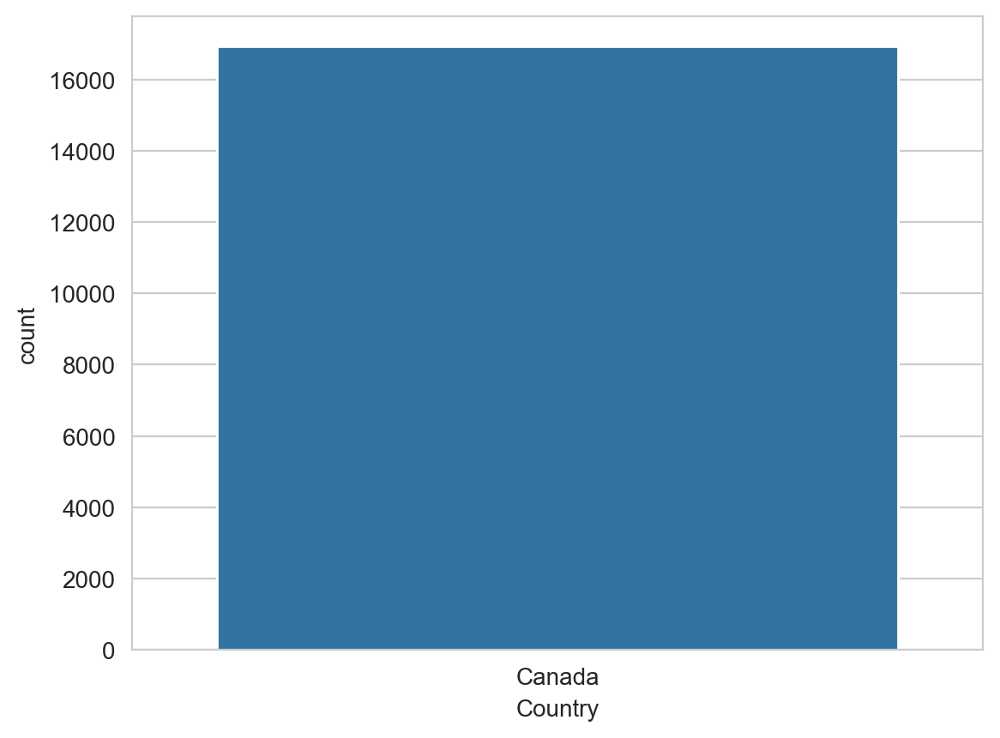

In [136]:
sns.countplot(x=customer["Country"])
plt.show()

- Confirms that every entry of the dataset is from Canada.

#### 3.1.2.2 Province or State

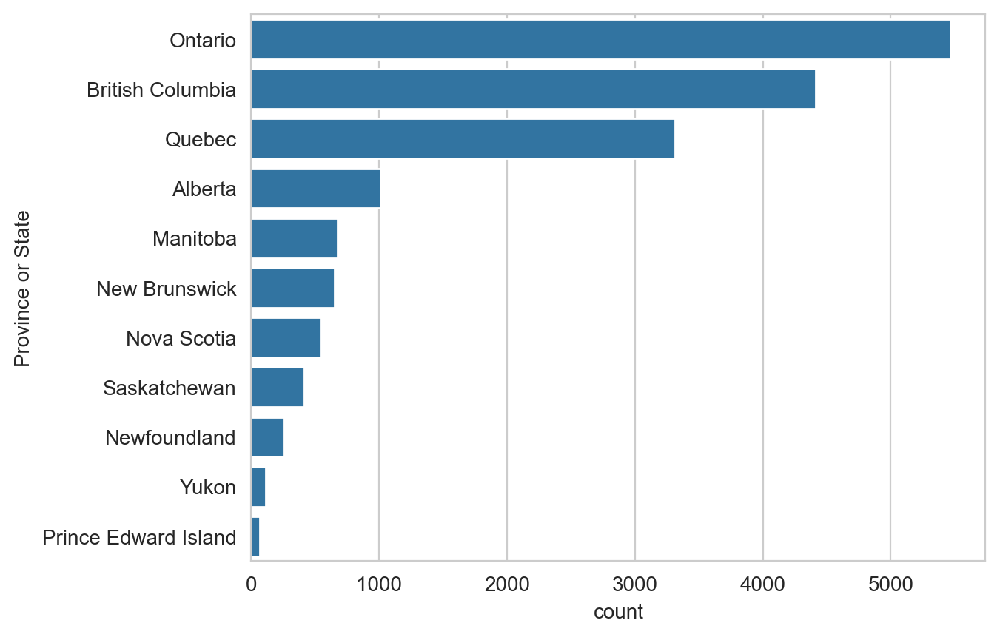

In [137]:
sns.countplot(y=customer["Province or State"],
              order=customer["Province or State"].value_counts().index
             )
plt.show()

- The most represented provinces in the dataset are Ontario, British Columbia, and Quebec, which together include most of the customers. This shows that the loyalty program is mainly concentrated in the most populated and economically active regions of Canada.

- Smaller provinces such as Yukon, Prince Edward Island, and Newfoundland appear with very low counts, which may reflect lower population density or limited market presence.

- The distribution is quite unbalanced, with only a few provinces dominating the customer base. This could influence the clustering analysis, as customers from these areas might drive most of the patterns found.

#### 3.1.2.3 City

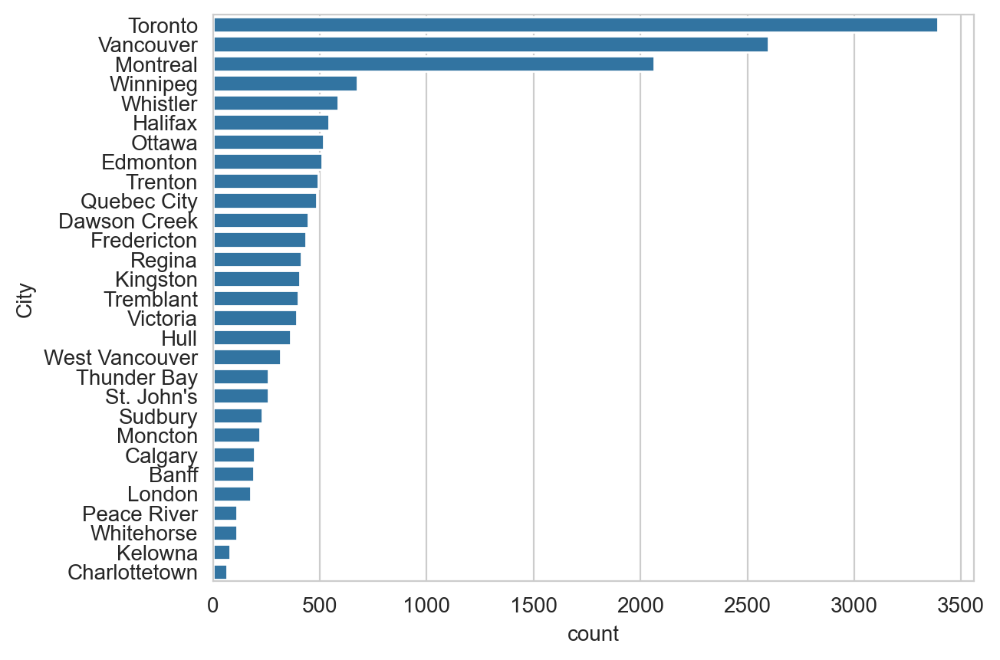

In [138]:
sns.countplot(y=customer["City"],
              order=customer["City"].value_counts().index
             )
plt.show()

- The cities with the largest number of customers are Toronto, Vancouver, and Montreal, which are also the main economic and travel hubs in Canada. This pattern is expected, as these cities concentrate the country’s busiest airports and highest population densities.

- Mid-sized cities like Winnipeg, Whistler, Halifax, and Ottawa still show a relevant presence, suggesting that the loyalty program also reaches secondary urban markets.

- Several smaller cities such as Kelowna, Charlottetown, or Whitehorse have very few customers, which indicates a limited market penetration in more remote regions.

- The distribution is highly skewed, meaning that most of the customer base comes from a few large metropolitan areas. For clustering, this could lead to results dominated by urban profiles unless normalization or regional balancing is considered.

#### 3.1.2.4 Postal Code

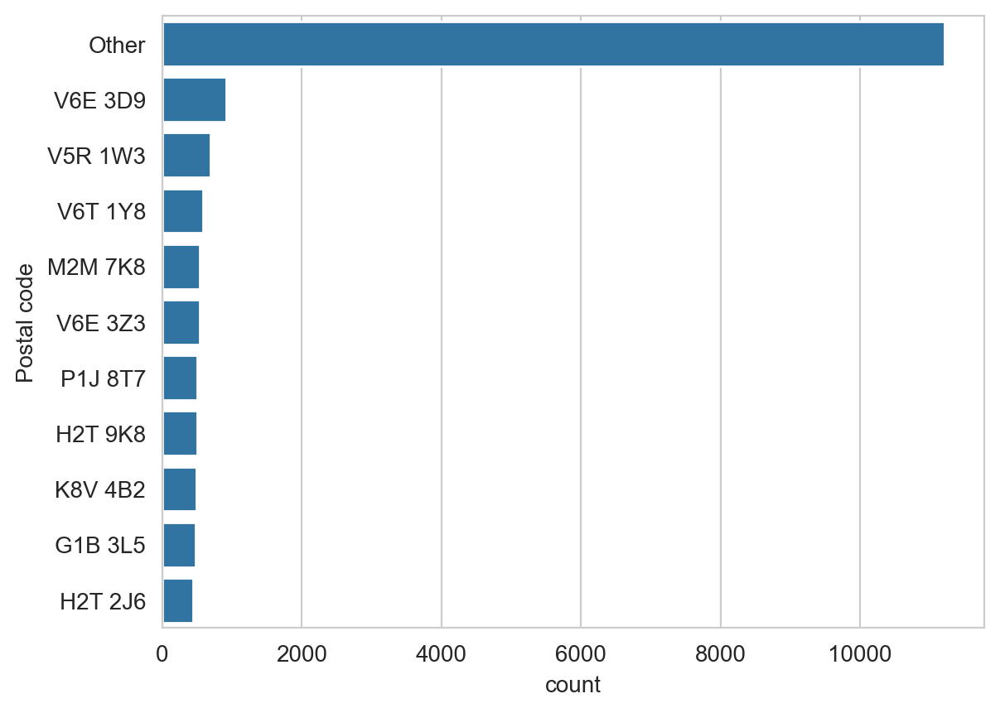

In [142]:
top_cap = 10

# Select Top 25 postal codes and group the rest as 'Other'
postal_series = customer["Postal code"].astype(str)
vc = postal_series.value_counts()
keep = vc.nlargest(top_cap).index
postal_series = postal_series.where(postal_series.isin(keep), "Other")

# Plot
sns.countplot(y=postal_series,
              order=postal_series.value_counts().index)
plt.show()


- The *‘Postal code’* variable is highly fragmented, with most entries grouped under “Other.”

- A few urban codes dominate, likely from major cities.

- Overall, it’s too granular for clustering and should be aggregated into broader regions.

#### 3.1.2.5 Gender

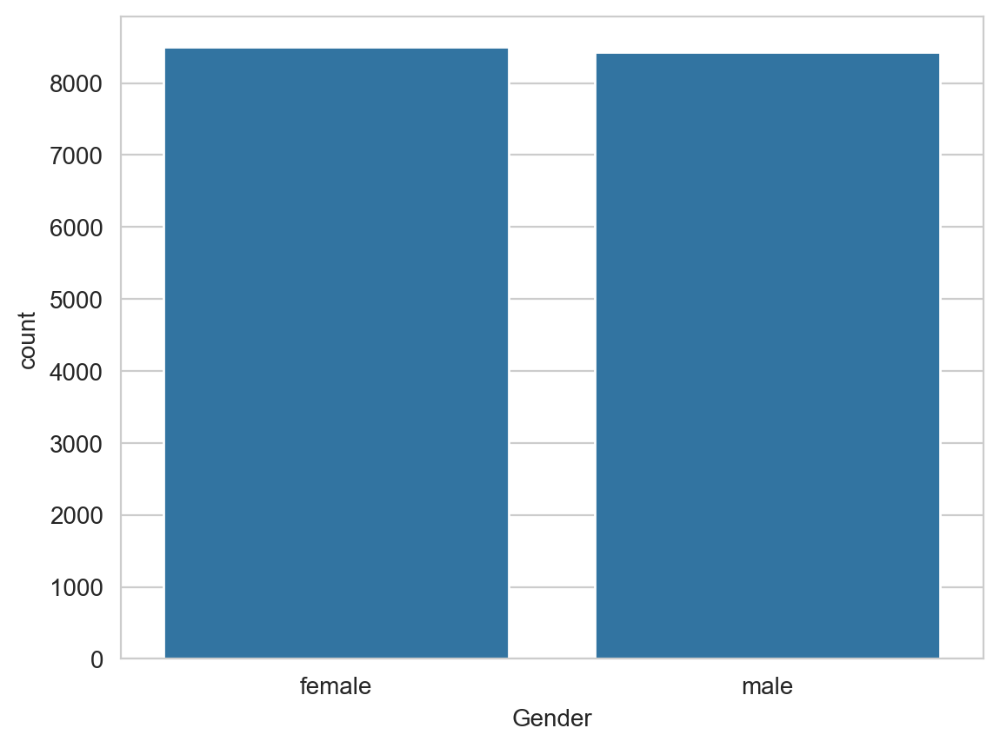

In [143]:
sns.countplot(x=customer["Gender"],
              order=customer["Gender"].value_counts().index
             )
plt.show()

- The *‘Gender’* variable is almost perfectly balanced between female and male, with no visible bias.

#### 3.1.2.6 Education

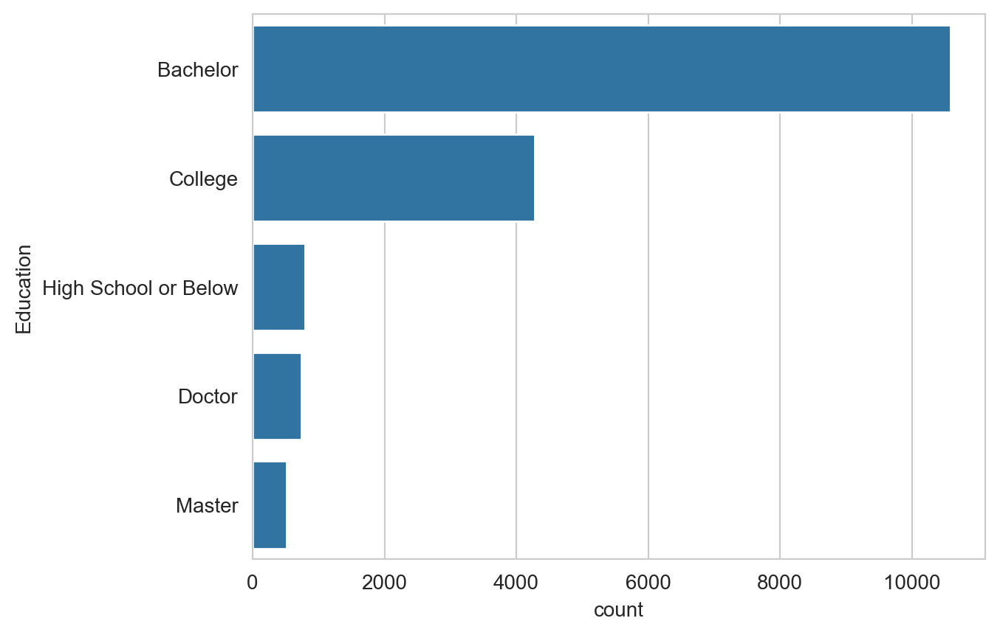

In [144]:
sns.countplot(y=customer["Education"],
              order=customer["Education"].value_counts().index
             )
plt.show()

- Most customers hold a Bachelor’s degree, followed by College graduates, while advanced degrees (Master, Doctor) and lower education levels are much less common.

- This indicates that the customer base is well-educated, possibly associated with higher income levels and greater purchasing power.

- The limited variation at the lower end suggests that education could help identify premium-oriented customer clusters.

#### 3.1.2.7 Location Code

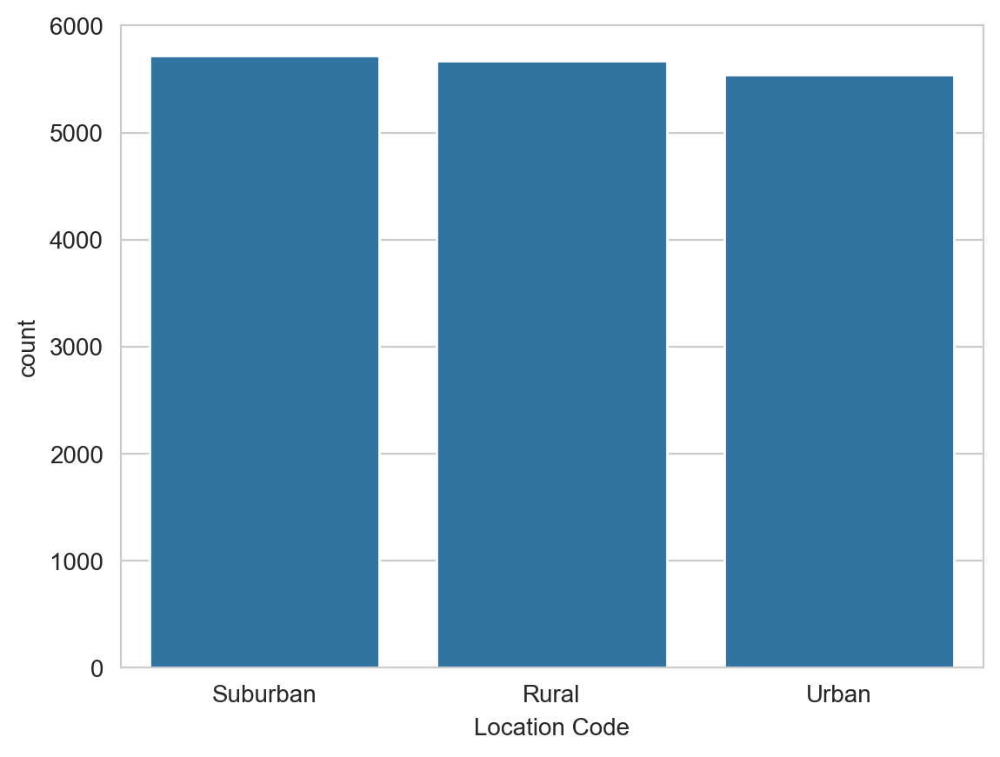

In [145]:
sns.countplot(x=customer["Location Code"],
              order=customer["Location Code"].value_counts().index
             )
plt.show()

- The *‘Location Code’* variable is quite balanced across Suburban, Rural, and Urban categories, with only minor differences in counts.

- This balance suggests a diverse customer base in terms of residential environment, which may help capture lifestyle differences during clustering.

#### 3.1.2.8 Marital Status

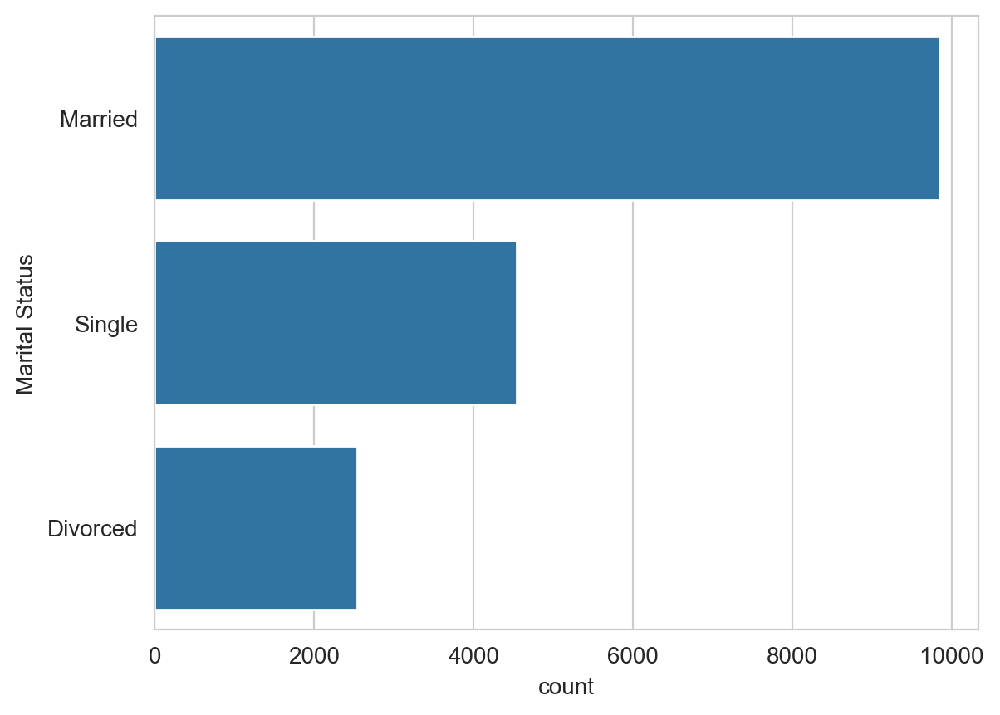

In [146]:

sns.countplot(y=customer["Marital Status"],
              order=customer["Marital Status"].value_counts().index)
plt.show()

- The vast majority of customers are married, followed by single and divorced individuals.

- This distribution suggests a family-oriented customer base, which might influence travel patterns such as group or companion flights (to check when merged datasets).

- The variable could provide useful segmentation insights when combined with behavioral factors like flight frequency or loyalty status.

#### 3.1.2.9 LoyaltyStatus

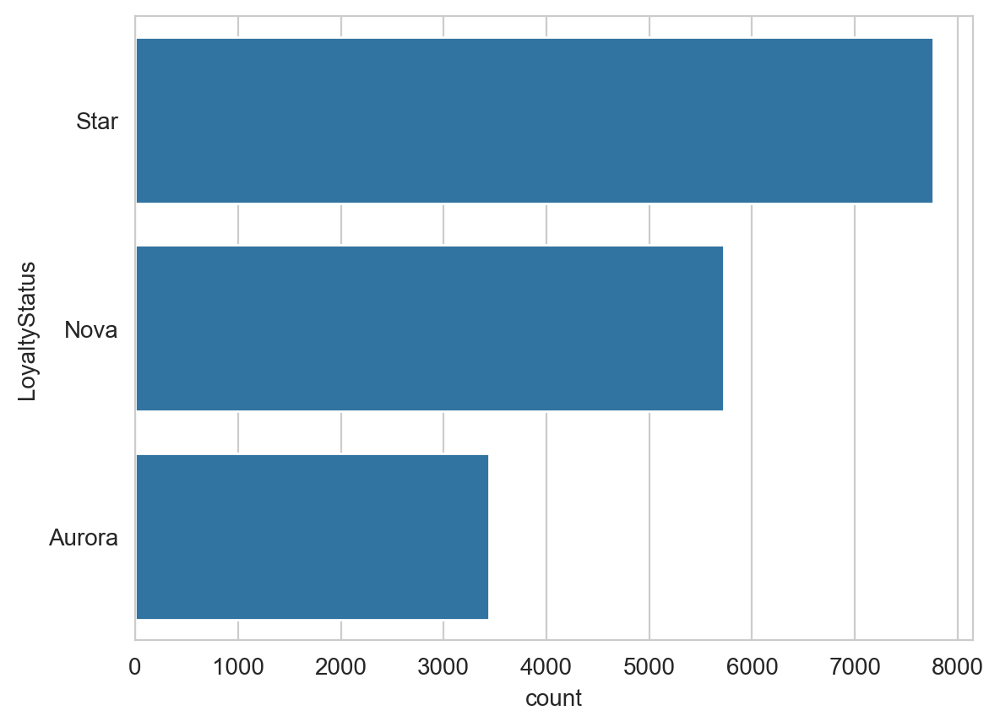

In [147]:
sns.countplot(y=customer["LoyaltyStatus"],
              order=customer["LoyaltyStatus"].value_counts().index
             )
plt.show()

- The ‘LoyaltyStatus’ variable shows that most customers belong to the Star tier, followed by Nova and Aurora. It is expected that higher loyalty tiers contain fewer customers, as progression to these levels typically requires greater engagement, spending, and tenure within the loyalty program - so it is safe to assume that Aurora is the last tier.

- This indicates a mature and engaged loyalty program, with a large proportion of customers already in higher tiers.

- It may also suggest that retention strategies are working well, although further analysis is needed to confirm whether Star (Aurora?) members contribute more value or simply remain enrolled longer.

#### 3.1.2.10 EnrollmentType

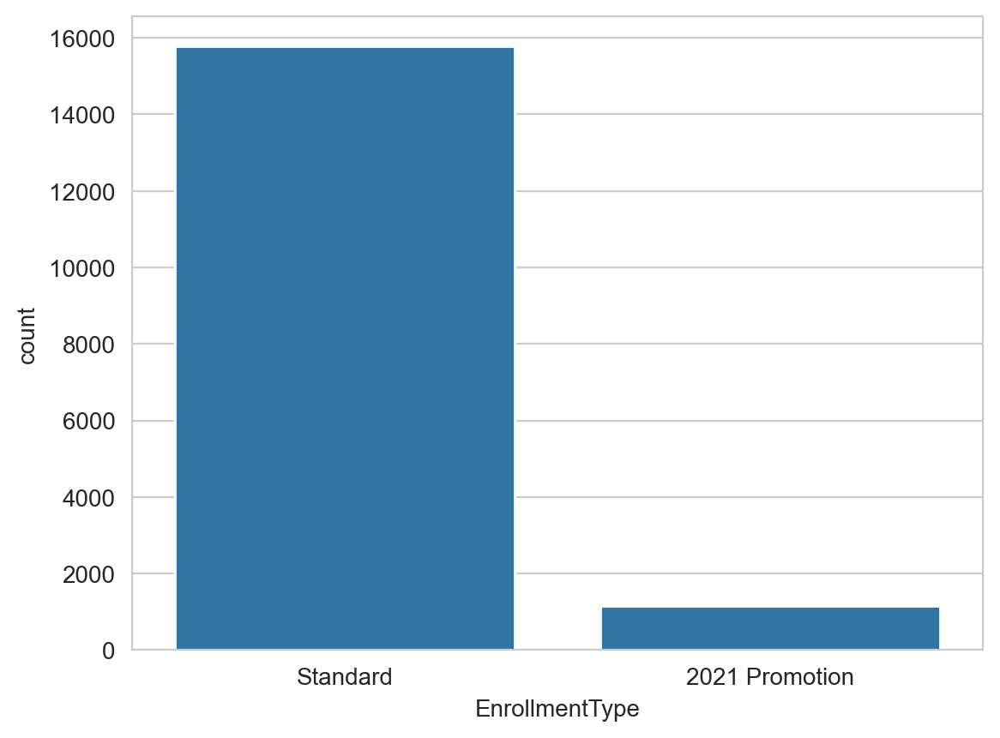

In [148]:
sns.countplot(x=customer["EnrollmentType"],
              order=customer["EnrollmentType"].value_counts().index
             )
plt.show()

- Most customers joined through Standard enrollment, while only a small fraction enrolled via the 2021 Promotion.

- This suggests that promotional campaigns had limited reach or short duration.

- It could be useful to compare retention or spending behavior between the two groups to assess promotion effectiveness.

### 3.1.3 Numerical Variables' Bivariate Analysis

#### 3.1.3.1 Metric Variables' Correlation Matrix

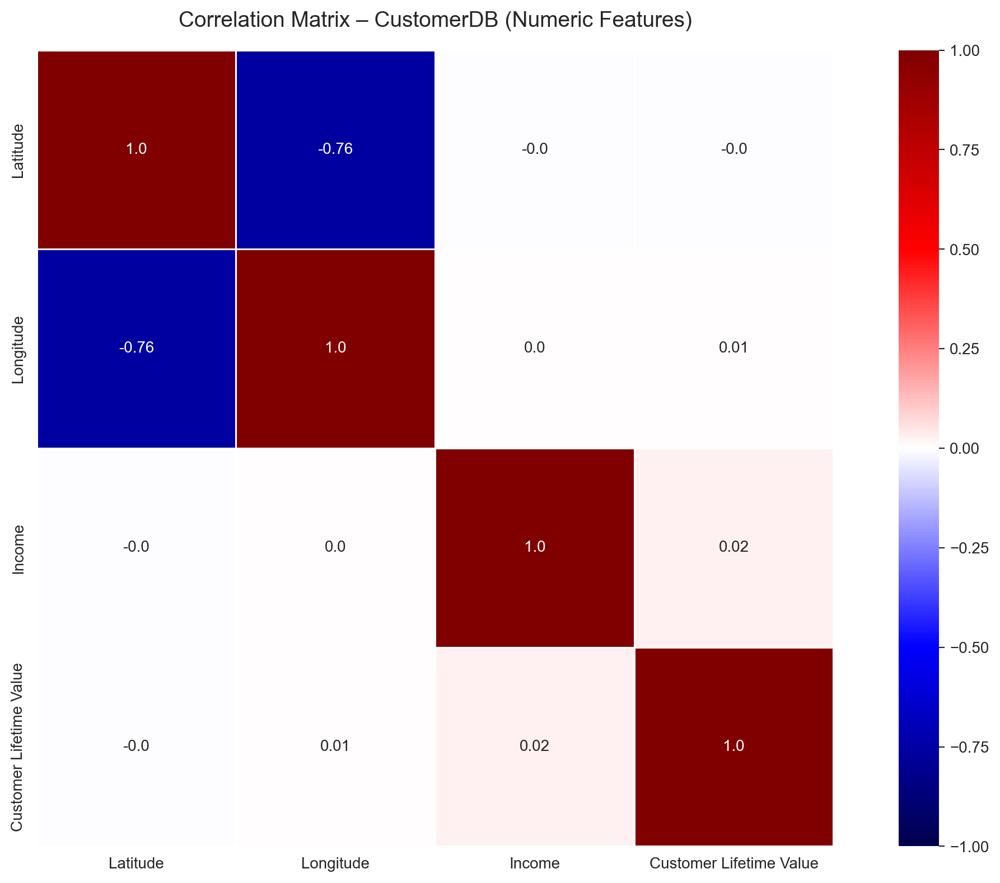

In [149]:
num_customer = customer.select_dtypes(include=[np.number]).drop(columns=['Loyalty#'])

corr = num_customer.corr(method='pearson')

annot = corr.round(2).astype(str)

plt.figure(figsize=(12, 8))

sns.heatmap(data=corr,
            annot=annot,
            fmt='s',
            vmin=-1, vmax=1,
            center=0,
            square=True,
            linewidths=.5,
            cmap='seismic')

plt.title('Correlation Matrix – CustomerDB (Numeric Features)', fontsize=14, pad=15)
plt.tight_layout()

plt.show()

- The correlation matrix shows no strong linear relationships between the numerical variables in **CustomerDB**, except for the negative correlation between **Latitude** and **Longitude** (–0.76), which is expected due to their geographic relation (and pair latitude-longitude relationship observer earlier).

- Other variables, such as **Income** and **Customer Lifetime Value**, have almost no correlation with each other, meaning that customer economic value is not related to income.

#### 3.1.3.2 Income vs Customer Lifetime Value

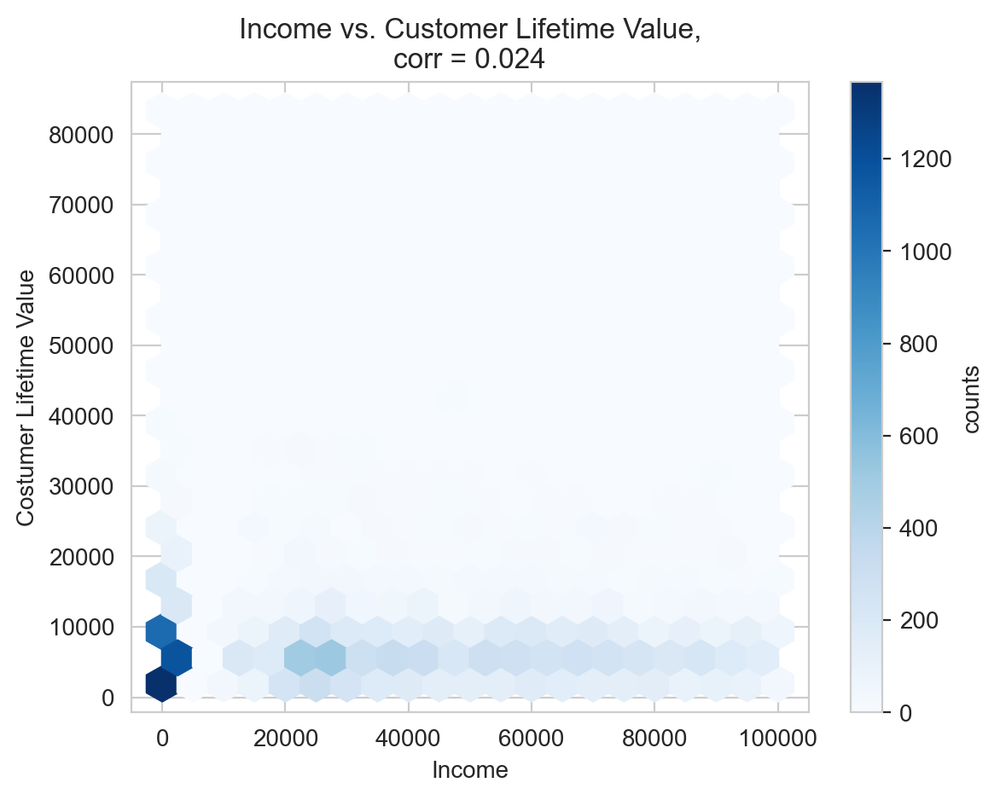

In [150]:
fig, ax = plt.subplots()

hb = ax.hexbin(customer['Income'], customer['Customer Lifetime Value'], 
               gridsize=20,
               cmap='Blues'
              )

ax.set_title(f"Income vs. Customer Lifetime Value,\ncorr = {np.round(customer[['Income','Customer Lifetime Value']].corr().values[0,1],4)}")

ax.set_xlabel("Income")
ax.set_ylabel("Costumer Lifetime Value")

cb = fig.colorbar(hb, ax=ax, label='counts')

plt.show()

The idea of doing this hexbin plot was to check if, even with no correlation between these variables (0.024), interesting things could be discovered.

The hexbin plot shows a clear concentration of customers in the low-income and low-lifetime-value region. There is no visible trend or gradient, confirming the near-zero correlation between Income and Customer Lifetime Value. This indicates that higher income does not necessarily translate into higher economic contribution to the airline. Therefore, behavioral variables such as flight activity or points redemption may offer stronger insights for segmentation.

### 3.1.4 Categorical Variables' Bivariate Analysis

#### 3.1.4.1 Check for the relevancy of 'Province or State' or 'City'

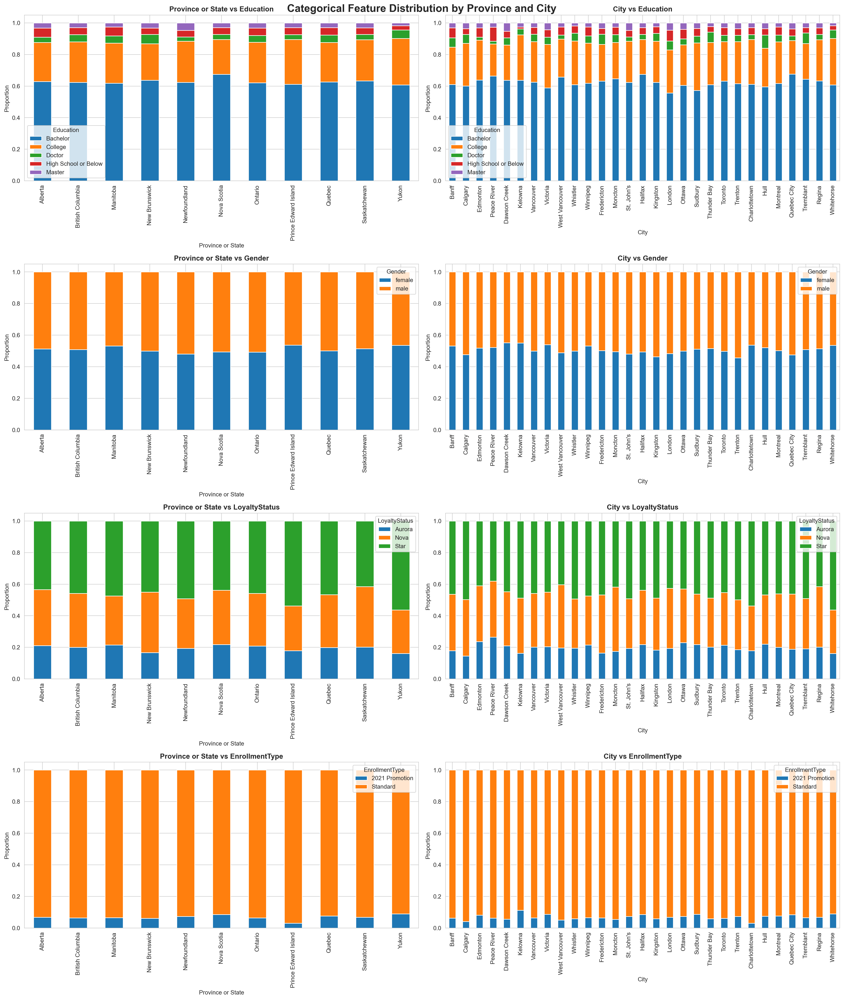

In [151]:
categorical_features = ['Education', 'Gender', 'LoyaltyStatus', 'EnrollmentType']

fig, axes = plt.subplots(len(categorical_features), 2, 
                         figsize=(20, 6 * len(categorical_features)))

for idx, feature in enumerate(categorical_features):
    province_data = pd.crosstab(customer["Province or State"], 
                                customer[feature], normalize='index')
    province_data.plot(kind="bar", stacked=True, ax=axes[idx, 0])
    axes[idx, 0].set_title(f"Province or State vs {feature}", fontweight='bold')
    axes[idx, 0].set_ylabel("Proportion")
    
    ordered_cities = (customer.groupby(['Province or State', 'City'])
                      .size().reset_index()
                      .sort_values(['Province or State', 'City'])['City'].unique())
    city_data = pd.crosstab(customer["City"], customer[feature], 
                           normalize='index').reindex(ordered_cities)
    city_data.plot(kind="bar", stacked=True, ax=axes[idx, 1])
    axes[idx, 1].set_title(f"City vs {feature}", fontweight='bold')
    axes[idx, 1].set_ylabel("Proportion")

plt.suptitle("Categorical Feature Distribution by Province and City", 
             fontsize=18, fontweight='bold')
plt.tight_layout()
plt.show()

- The visualizations reveal that 'Province or State' and 'City' follow consistent trends across all four categorical features (Education, Gender, LoyaltyStatus, and EnrollmentType). However, 'City' introduces additional noise due to its finer granularity. Given this redundancy, we will use 'Province or State' as it provides a clearer signal while maintaining geographic information.

#### 3.1.4.2 Check the other categorical

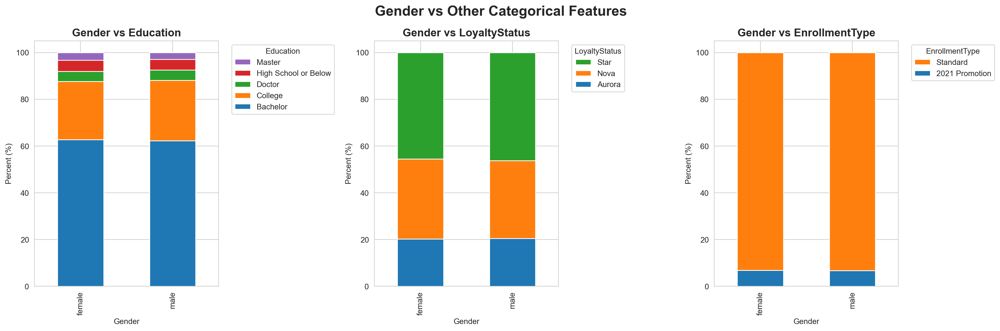

In [152]:
categorical_features = ['Education', 'LoyaltyStatus', 'EnrollmentType']
pairs = [("Gender", col) for col in categorical_features]

cols = 3
rows = ceil(len(pairs) / cols)

fig, axes = plt.subplots(rows, cols, figsize=(18, 6 * rows))
axes = axes.flatten()

for idx, (col1, col2) in enumerate(pairs):
    ax = axes[idx]
    
    ct = pd.crosstab(customer[col1], customer[col2], normalize='index') * 100
    ct.plot(kind="bar", stacked=True, ax=ax)
    
    ax.set_title(f"{col1} vs {col2}", fontsize=14, fontweight='bold')
    ax.set_xlabel(col1)
    ax.set_ylabel("Percent (%)")
    
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles[::-1], labels[::-1], title=col2, 
              bbox_to_anchor=(1.05, 1), loc="upper left")

plt.suptitle("Gender vs Other Categorical Features", 
             fontsize=18, fontweight='bold')
plt.tight_layout()
plt.show()

- We observe that not only are the male and female subsets similar in size, but they are also equally distributed across education, enrollment type, and loyalty status.

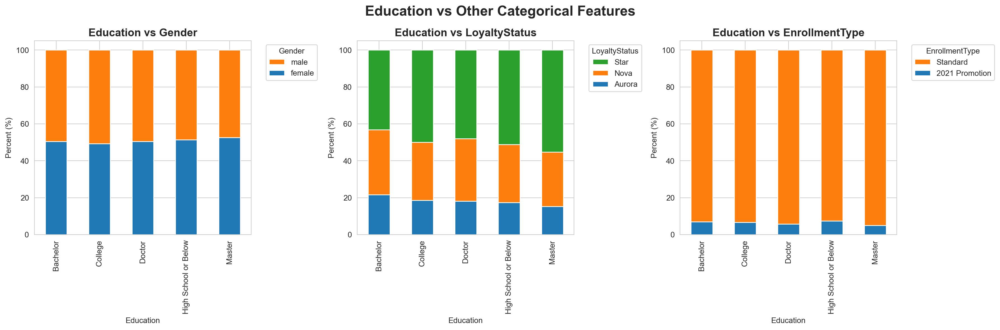

In [153]:
categorical_features = ['Gender', 'LoyaltyStatus', 'EnrollmentType']
pairs = [("Education", col) for col in categorical_features]

cols = 3
rows = ceil(len(pairs) / cols)

fig, axes = plt.subplots(rows, cols, figsize=(18, 6 * rows))
axes = axes.flatten()

for idx, (col1, col2) in enumerate(pairs):
    ax = axes[idx]
    
    ct = pd.crosstab(customer[col1], customer[col2], normalize='index') * 100
    ct.plot(kind="bar", stacked=True, ax=ax)
    
    ax.set_title(f"{col1} vs {col2}", fontsize=14, fontweight='bold')
    ax.set_xlabel(col1)
    ax.set_ylabel("Percent (%)")
    
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles[::-1], labels[::-1], title=col2, 
              bbox_to_anchor=(1.05, 1), loc="upper left")

plt.suptitle("Education vs Other Categorical Features", 
             fontsize=18, fontweight='bold')
plt.tight_layout()
plt.show()

- We observe that when normalizing by education level, the distributions of enrollment type, gender, and loyalty status remain consistent across all education categories.

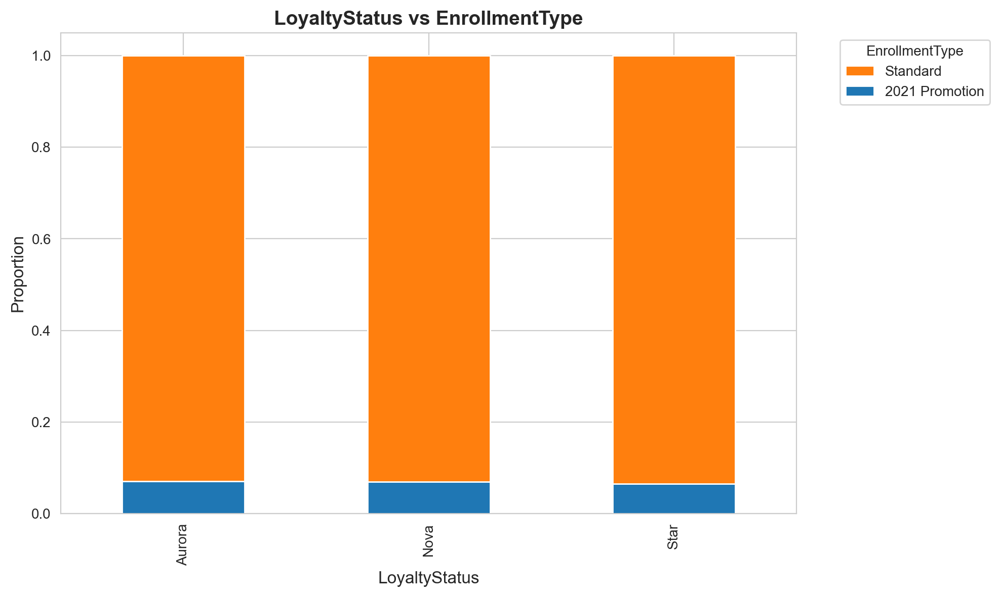

In [154]:
fig, ax = plt.subplots(figsize=(10, 6))

# Crosstab normalizado
ct = pd.crosstab(customer['LoyaltyStatus'], customer['EnrollmentType'], normalize='index')

# Stacked bar plot
ct.plot(kind="bar", stacked=True, ax=ax)

ax.set_title("LoyaltyStatus vs EnrollmentType", fontsize=14, fontweight='bold')
ax.set_xlabel("LoyaltyStatus", fontsize=12)
ax.set_ylabel("Proportion", fontsize=12)

handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], title='EnrollmentType', 
          bbox_to_anchor=(1.05, 1), loc="upper left")

plt.tight_layout()
plt.show()

- Finally, we also observe that the EnrollmentType did not affect the LoyaltyStatus

### 3.1.5 Categorical / Numerical Variables' Bivariate Analysis

#### 3.1.5.1 Income vs Education Level

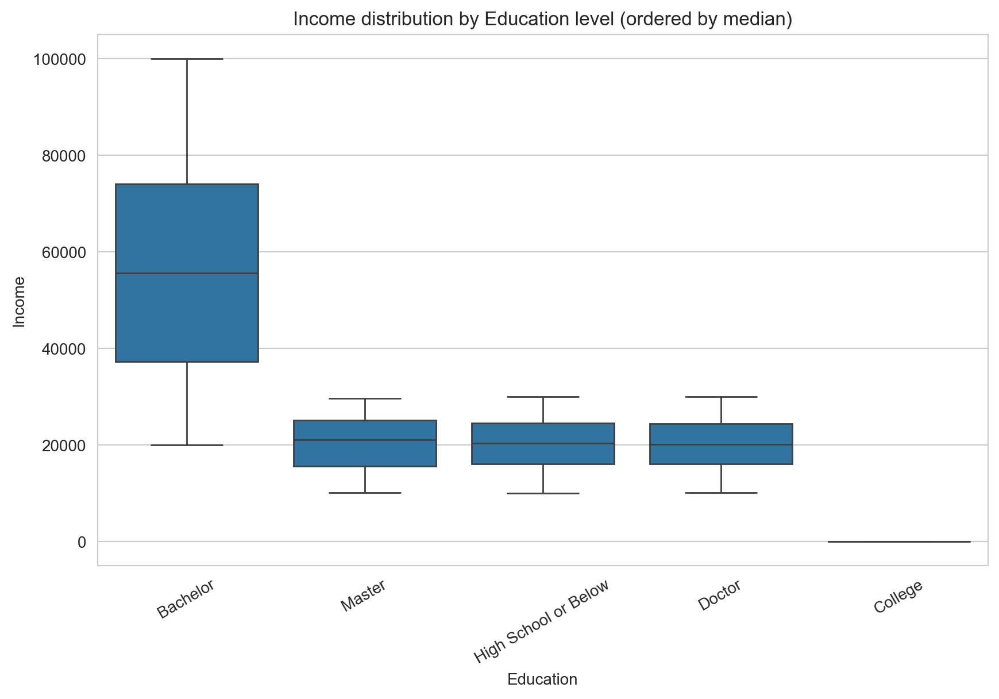

In [155]:
order = (
    customer.groupby("Education")["Income"]
    .median()
    .sort_values(ascending=False)
    .index
)

plt.figure(figsize=(10,6))
sns.boxplot(
    data=customer,
    x="Education",
    y="Income",
    order=order
)
plt.title("Income distribution by Education level (ordered by median)")
plt.xticks(rotation=30)
plt.show()


- This reveals a counterintuitive result: Bachelor's degree holders earn more than those with Master's or Doctoral degrees. Plus, all the entries with income = 0 relates to College.

In [156]:
# Income = 0
num_income_zero = customer[customer['Income'] == 0].shape[0]

# Education = College
num_college = customer[customer['Education'].str.lower() == 'college'].shape[0]

# Ambas as condições
num_both = customer[(customer['Income'] == 0) & (customer['Education'].str.lower() == 'college')].shape[0]

print(f"Number of customers with Income = 0: {num_income_zero}")
print(f"Number of customers with Education = 'College': {num_college}")
print(f"Number of customers with both Income = 0 and Education = 'College': {num_both}")


Number of customers with Income = 0: 4273
Number of customers with Education = 'College': 4283
Number of customers with both Income = 0 and Education = 'College': 4273


The data shows that nearly all customers labeled with “College” education have an income recorded as zero. While it is possible that some customers with zero income and “College” education are dependents or students, the near-perfect overlap between these two variables, combined with the business logic of loyalty program membership, strongly suggests a data quality issue rather than a true demographic phenomenon, as stated earlier.

#### 3.1.5.2 Income vs Gender

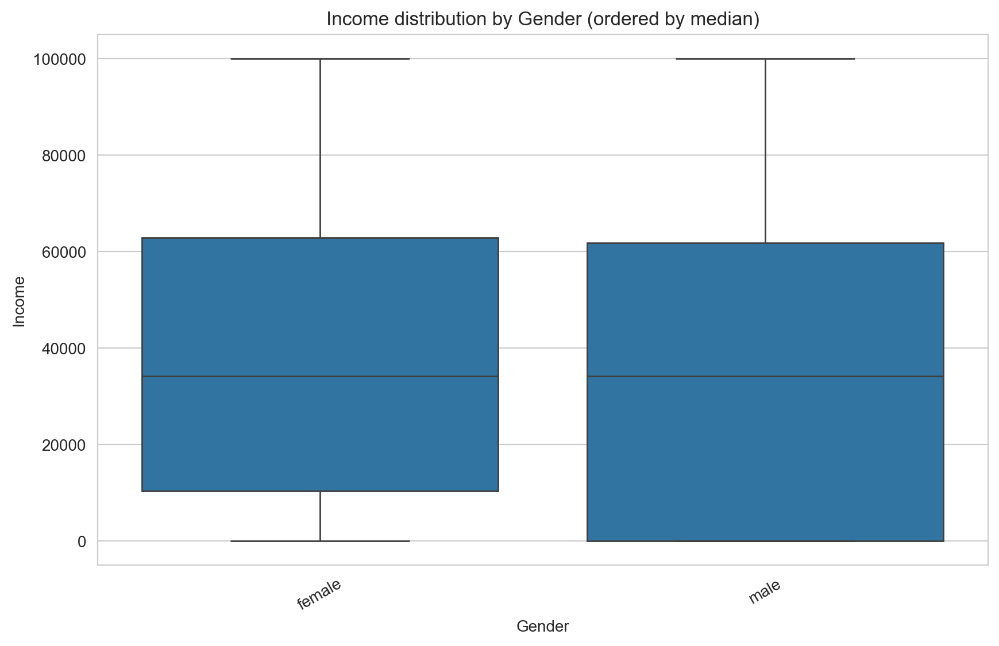

In [157]:
order = (
    customer.groupby("Gender")["Income"]
    .median()
    .sort_values(ascending=False)
    .index
)

plt.figure(figsize=(10,6))
sns.boxplot(
    data=customer,
    x="Gender",
    y="Income",
    order=order
)
plt.title("Income distribution by Gender (ordered by median)")
plt.xticks(rotation=30)
plt.show()


The data was analyzed to test the hypothesis that male customers earn higher incomes than female customers within the loyalty program. However, the boxplot shows that the median income levels between genders are nearly identical, and both distributions share a similar range and spread. Although males display a slightly higher upper quartile, the difference is minimal and not indicative of a substantial gender-based income disparity.

Therefore, the hypothesis that males earn significantly more than females is not supported by the data. The similarity in distributions suggests that, within AIAI’s customer base, income differences are likely driven more by other factors.

#### 3.1.5.3 Income vs Marital Status

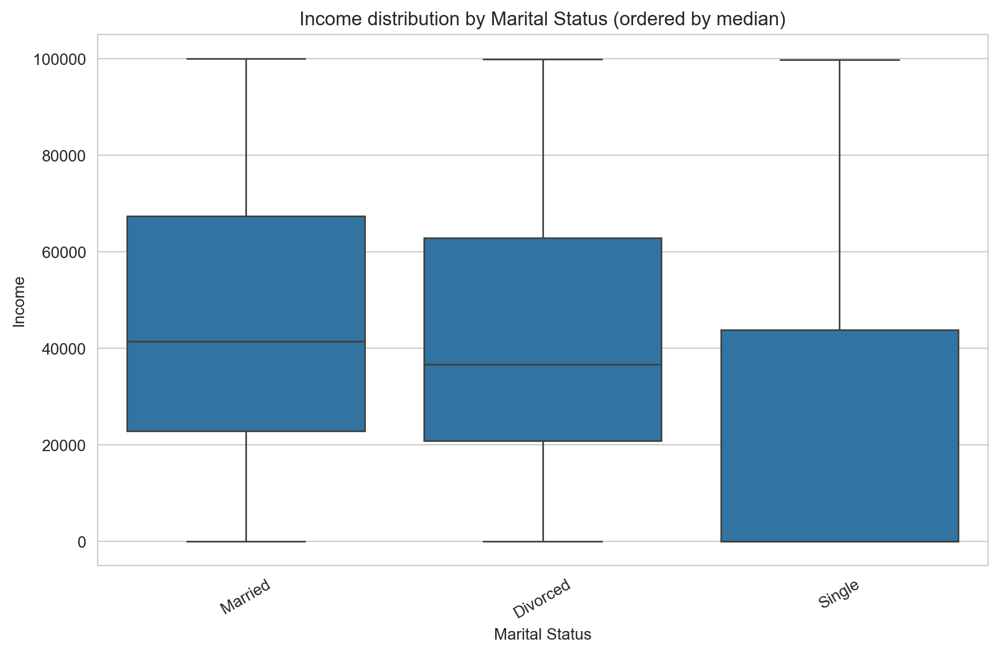

In [158]:
order = (
    customer.groupby("Marital Status")["Income"]
    .median()
    .sort_values(ascending=False)
    .index
)

plt.figure(figsize=(10,6))
sns.boxplot(
    data=customer,
    x="Marital Status",
    y="Income",
    order=order
)
plt.title("Income distribution by Marital Status (ordered by median)")
plt.xticks(rotation=30)
plt.show()


The boxplot reveals that married customers have the highest median income, followed by divorced and then single individuals, who show both the lowest median and the narrowest distribution. This gradient aligns with expected life-stage effects, where shared or accumulated household income increases economic capacity. Such differences suggest that marital status may serve as a meaningful differentiator in value-based segmentation, with married customers representing a higher-income cluster within the loyalty progra

#### 3.1.5.4 Income vs Suburban Code

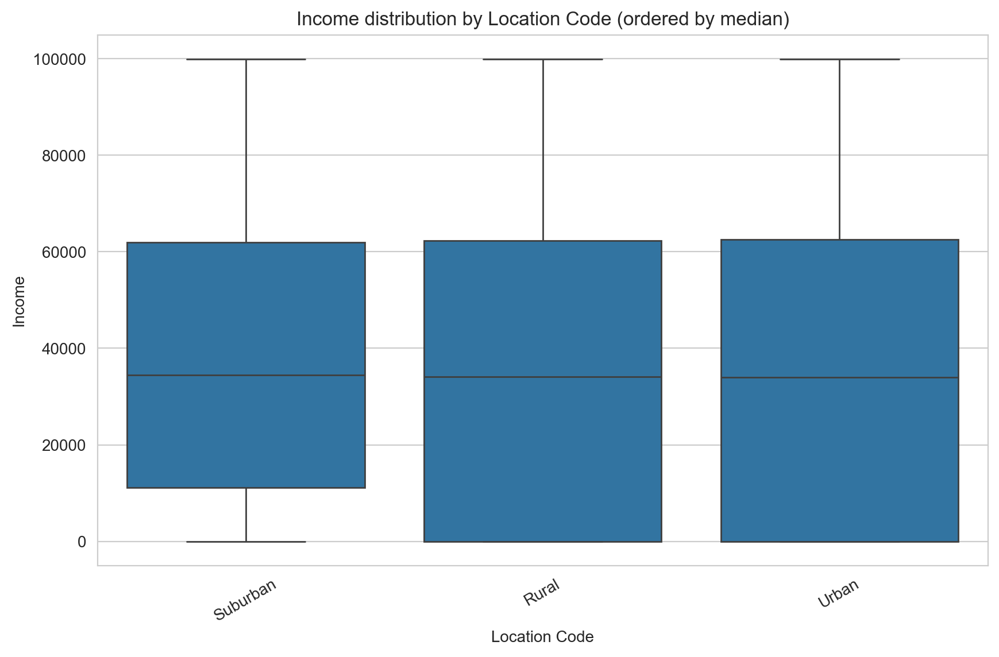

In [159]:
order = (
    customer.groupby("Location Code")["Income"]
    .median()
    .sort_values(ascending=False)
    .index
)

plt.figure(figsize=(10,6))
sns.boxplot(
    data=customer,
    x="Location Code",
    y="Income",
    order=order
)
plt.title("Income distribution by Location Code (ordered by median)")
plt.xticks(rotation=30)
plt.show()


Income levels show minimal variation across suburban, rural, and urban customers, with comparable medians and dispersion. This uniformity indicates that location type does not meaningfully separate customers by income within the loyalty program, suggesting that geographic context alone may have limited explanatory power for value segmentation and should be analyzed in combination with other demographic or behavioral factors.

#### 3.1.5.5 Income vs Loyalty Status

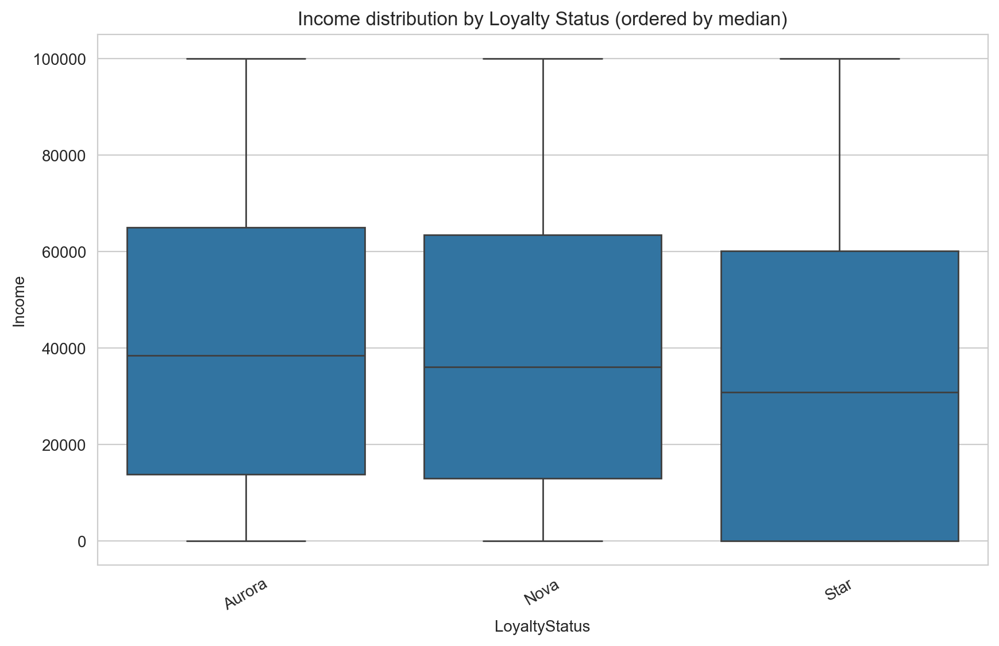

In [160]:
order = (
    customer.groupby("LoyaltyStatus")["Income"]
    .median()
    .sort_values(ascending=False)
    .index
)

plt.figure(figsize=(10,6))
sns.boxplot(
    data=customer,
    x="LoyaltyStatus",
    y="Income",
    order=order
)
plt.title("Income distribution by Loyalty Status (ordered by median)")
plt.xticks(rotation=30)
plt.show()


Income distributions appear relatively similar across loyalty tiers, with Aurora members showing a slightly higher median income compared to Nova and Star. The lack of a clear upward trend from lower to higher tiers suggests that income alone does not determine loyalty status, implying that engagement level or flight frequency may be stronger drivers of tier progression than pure economic capacity.

#### 3.1.5.6 Income vs Enrollment Type

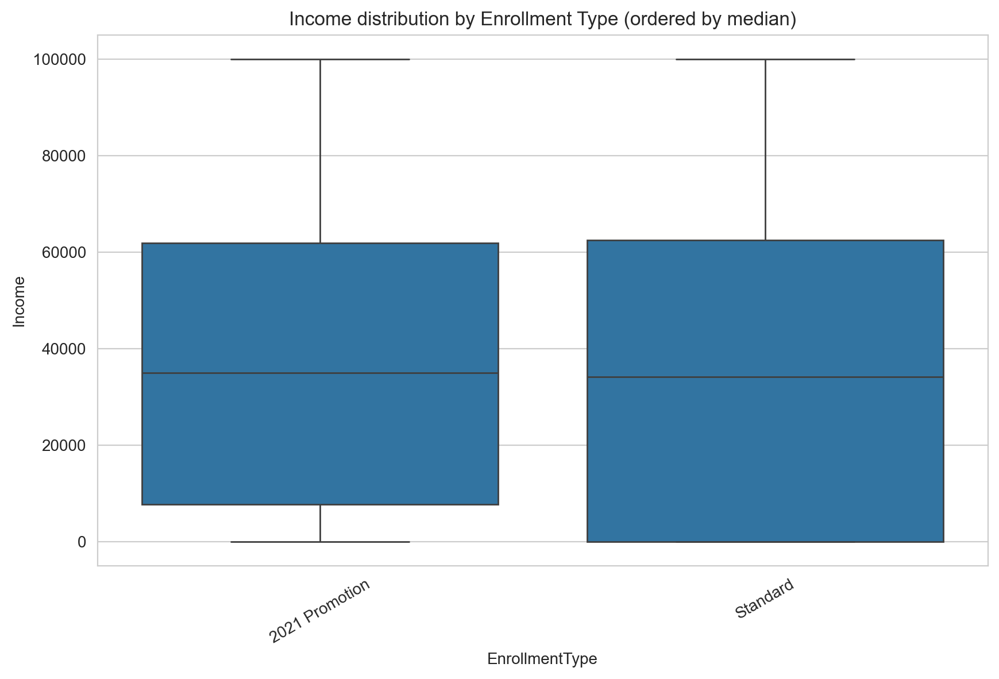

In [161]:
order = (
    customer.groupby("EnrollmentType")["Income"]
    .median()
    .sort_values(ascending=False)
    .index
)

plt.figure(figsize=(10,6))
sns.boxplot(
    data=customer,
    x="EnrollmentType",
    y="Income",
    order=order
)
plt.title("Income distribution by Enrollment Type (ordered by median)")
plt.xticks(rotation=30)
plt.show()


Income distributions between customers who enrolled through the 2021 promotion and those who joined via the standard process are almost identical, with overlapping medians and dispersion. This similarity indicates that promotional enrollment did not significantly attract higher or lower-income customers, suggesting that the campaign’s appeal was broad across income groups rather than targeted toward a specific economic segment.

#### 3.1.5.7 Loyalty Status vs Education

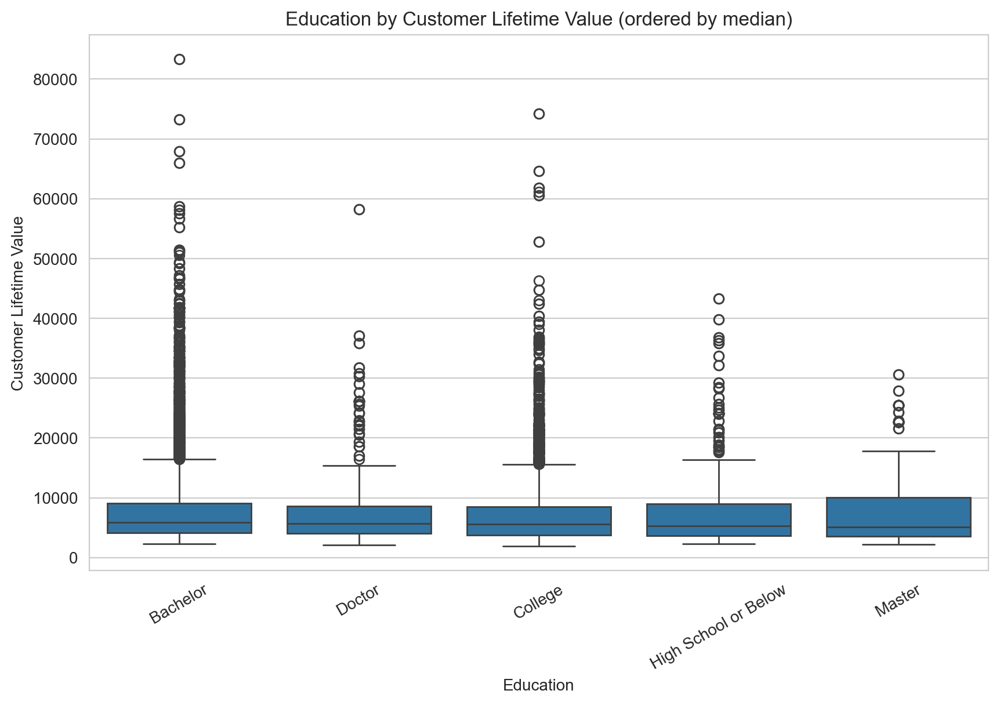

In [162]:
order = (
    customer.groupby("Education")["Customer Lifetime Value"]
    .median()
    .sort_values(ascending=False)
    .index
)

plt.figure(figsize=(10,6))
sns.boxplot(
    data=customer,
    x="Education",
    y="Customer Lifetime Value",
    order=order
)
plt.title("Education by Customer Lifetime Value (ordered by median)")
plt.xticks(rotation=30)
plt.show()


Customer Lifetime Value distributions are relatively similar across education levels, with only minor variations in medians and dispersion. Bachelor degree holders display a slightly higher spread, partly driven by numerous outliers, while other groups remain tightly clustered. The weak differentiation suggests that education does not strongly predict long-term customer value, reinforcing earlier findings that behavioral and loyalty-related factors are more indicative of economic contribution than purely demographic attributes.

#### 3.1.5.8 Loyalty Status vs Customer Lifetime Value

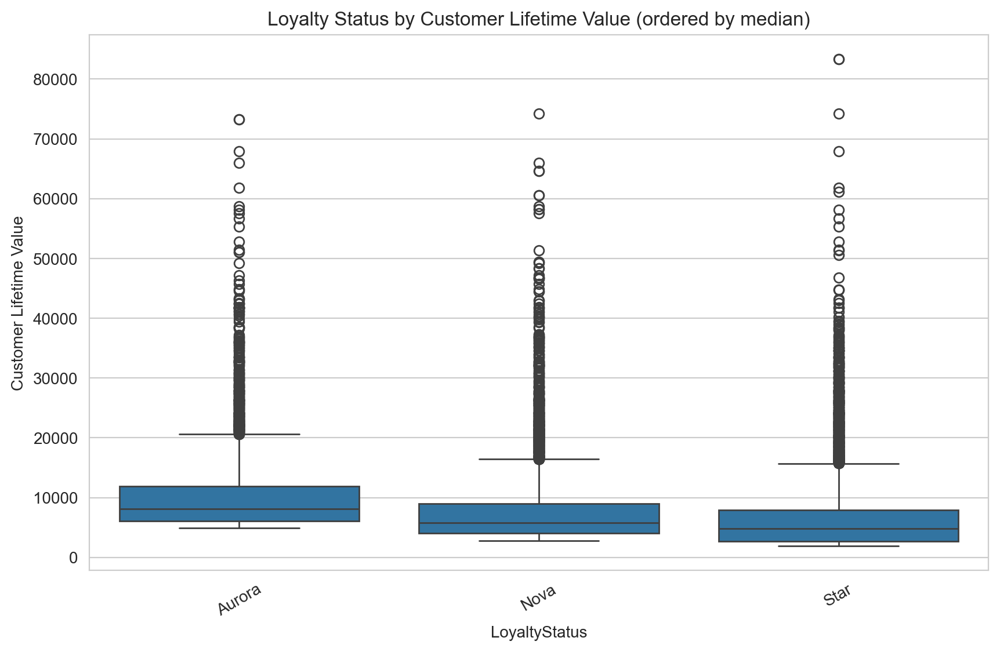

In [163]:
order = (
    customer.groupby("LoyaltyStatus")["Customer Lifetime Value"]
    .median()
    .sort_values(ascending=False)
    .index
)

plt.figure(figsize=(10,6))
sns.boxplot(
    data=customer,
    x="LoyaltyStatus",
    y="Customer Lifetime Value",
    order=order
)
plt.title("Loyalty Status by Customer Lifetime Value (ordered by median)")
plt.xticks(rotation=30)
plt.show()


This chart was made to check if customers with higher Loyalty Status really have a higher Customer Lifetime Value (CLV). Higher-tier members exhibit substantially greater Customer Lifetime Value, which aligns with expectations since elite tiers typically consist of the most profitable and engaged customers within the loyalty program - so it is safe to assume that Aurora is the highest tier.

The data shows that the median CLV is quite similar across all three tiers (Aurora, Nova, Star), with only small differences between them. All groups also have several high-value outliers, meaning a few customers bring in much more value than the rest.

This suggests that loyalty level is not clearly linked to how valuable a customer actually is. It’s possible that tier upgrades depend more on other factors, like the number of flights or time in the program. For the business, this could be a sign that the loyalty system needs some adjustment so that higher tiers truly represent the most valuable customers. This is because, by seeing only this chart, we can't really make conclusions on what is the highest tier of loyalty.

#### 3.1.5.9 EnrollmentType vs Customer Lifetime Value

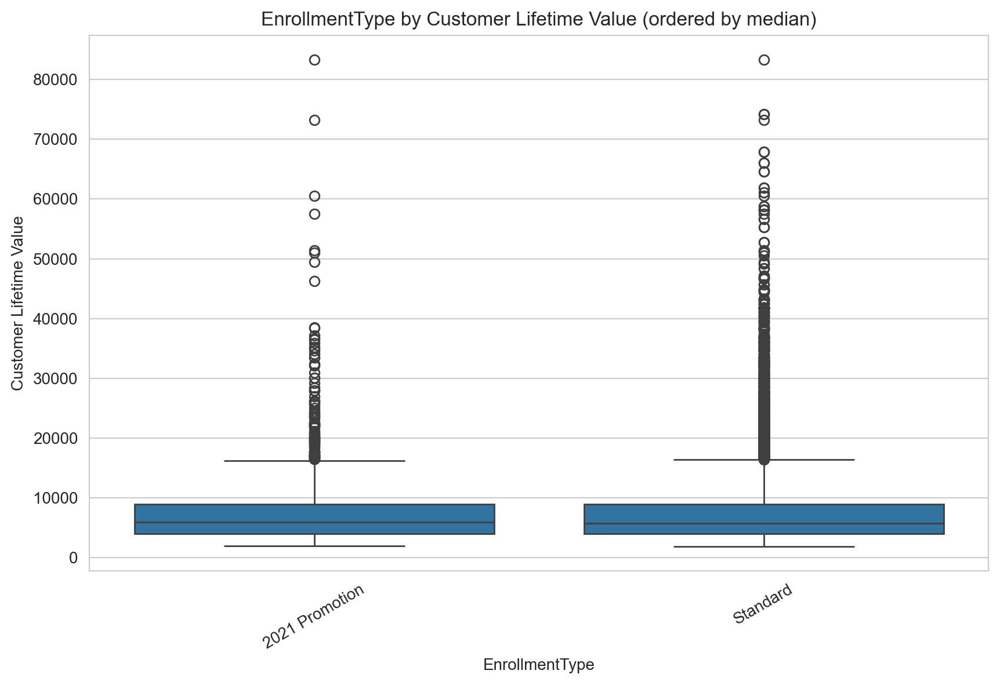

In [100]:
order = (
    customer.groupby("EnrollmentType")["Customer Lifetime Value"]
    .median()
    .sort_values(ascending=False)
    .index
)

plt.figure(figsize=(10,6))
sns.boxplot(
    data=customer,
    x="EnrollmentType",
    y="Customer Lifetime Value",
    order=order
)
plt.title("EnrollmentType by Customer Lifetime Value (ordered by median)")
plt.xticks(rotation=30)
plt.show()


This plot was used to compare whether customers who joined through the 2021 Promotion have a higher Customer Lifetime Value (CLV) than those who enrolled through the Standard process.

The results show that both groups have almost identical distributions, with similar medians and ranges. A few high-value outliers appear in both categories, but they don’t significantly change the overall pattern.

This means that the 2021 promotion did not bring in customers with higher lifetime value compared to regular enrollments. From a business point of view, this suggests that the promotion may have been effective in attracting new members, but not necessarily more profitable or loyal ones.

#### 3.1.5.10 CancellationDate (Yes or No) vs LoyaltyStatus

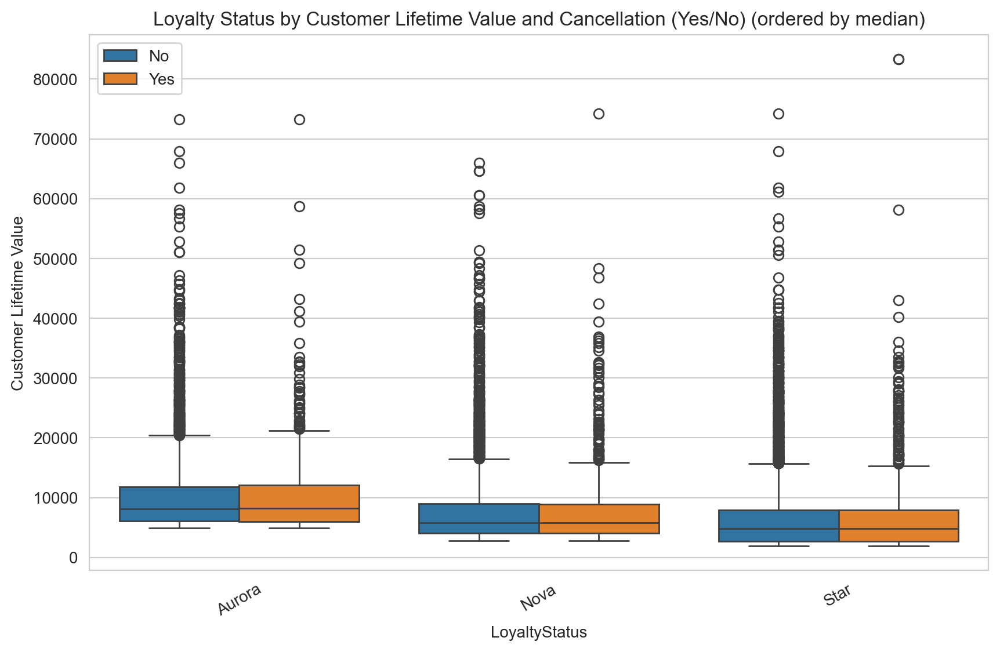

In [101]:
order = (
    customer.groupby("LoyaltyStatus")["Customer Lifetime Value"]
    .median()
    .sort_values(ascending=False)
    .index
)

plt.figure(figsize=(10,6))
sns.boxplot(
    x=customer["LoyaltyStatus"],
    y=customer["Customer Lifetime Value"],
    hue=np.where(customer["CancellationDate"].notna(), "Yes", "No"),
    order=order
)
plt.title("Loyalty Status by Customer Lifetime Value and Cancellation (Yes/No) (ordered by median)")
plt.xticks(rotation=30)
plt.show()

This chart was used to compare Customer Lifetime Value (CLV) between customers who cancelled their membership (“Yes”) and those who remained active (“No”) across different Loyalty Status levels.

The results show that for all three tiers (Aurora, Nova, Star), customers who did not cancel have higher mean CLV and a slightly wider value range. Those who cancelled tend to cluster around lower CLV values, suggesting shorter or less valuable relationships with the airline.

This pattern confirms that cancellations are more common among low-value customers, while higher-value members tend to stay active. From a business perspective, this reinforces the idea that retention strategies should target lower-tier members, as they are more likely to churn and have untapped potential for growth through engagement or tier progression.

#### 3.1.5.11 Check for the relevancy of "Province or State" vs "City"

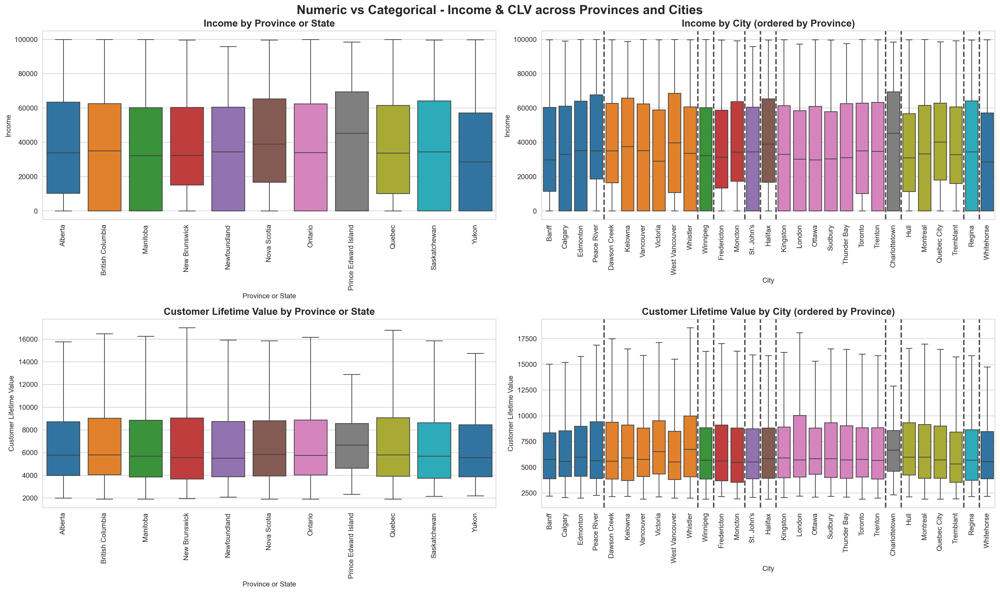

In [104]:
city_order_df = (customer.groupby(['Province or State', 'City'])
                 .size().reset_index()
                 .sort_values(['Province or State', 'City']))
ordered_cities = city_order_df['City'].unique()
city_to_province = customer.groupby('City')['Province or State'].first()

provinces = sorted(customer['Province or State'].dropna().unique())
province_colors = dict(zip(provinces, sns.color_palette("tab10", len(provinces))))

city_colors = [province_colors[city_to_province[city]] for city in ordered_cities]

def add_province_separators(ax, cities, city_province_map):
    prev_prov = None
    for i, city in enumerate(cities):
        curr_prov = city_province_map.get(city)
        if prev_prov and curr_prov != prev_prov:
            ax.axvline(x=i - 0.5, color='black', linewidth=2, 
                      linestyle='--', alpha=0.7)
        prev_prov = curr_prov

fig, axes = plt.subplots(2, 2, figsize=(20, 12))

sns.boxplot(data=customer, x='Province or State', y='Income', 
            order=provinces, palette=province_colors, showfliers=False, ax=axes[0, 0])
axes[0, 0].set_title("Income by Province or State", fontsize=14, fontweight='bold')
axes[0, 0].tick_params(axis='x', rotation=90)

sns.boxplot(data=customer, x='City', y='Income', 
            order=ordered_cities, palette=city_colors, showfliers=False, ax=axes[0, 1])
axes[0, 1].set_title("Income by City (ordered by Province)", fontsize=14, fontweight='bold')
axes[0, 1].tick_params(axis='x', rotation=90)
add_province_separators(axes[0, 1], ordered_cities, city_to_province)

sns.boxplot(data=customer, x='Province or State', y='Customer Lifetime Value', 
            order=provinces, palette=province_colors, showfliers=False, ax=axes[1, 0])
axes[1, 0].set_title("Customer Lifetime Value by Province or State", 
                     fontsize=14, fontweight='bold')
axes[1, 0].tick_params(axis='x', rotation=90)

sns.boxplot(data=customer, x='City', y='Customer Lifetime Value', 
            order=ordered_cities, palette=city_colors, showfliers=False, ax=axes[1, 1])
axes[1, 1].set_title("Customer Lifetime Value by City (ordered by Province)", 
                     fontsize=14, fontweight='bold')
axes[1, 1].tick_params(axis='x', rotation=90)
add_province_separators(axes[1, 1], ordered_cities, city_to_province)

plt.suptitle("Numeric vs Categorical - Income & CLV across Provinces and Cities", 
             fontsize=18, fontweight='bold')
plt.tight_layout()
plt.show()

The province-level analysis shows relatively balanced income distributions across regions, with Ontario and Prince Edward Island presenting slightly higher medians, while Yukon and Manitoba sit at the lower end. Dispersion remains consistent across provinces, suggesting that the airline’s customer base is economically diverse but stable nationwide. At the city level, major urban centers such as Vancouver, Toronto, and Ottawa exhibit higher incomes and broader variability, indicating the concentration of higher-earning customers in metropolitan areas, whereas smaller or more peripheral cities display tighter and lower distributions.

The Customer Lifetime Value (CLV) patterns closely mirror income, reinforcing the connection between financial capacity and long-term engagement with the loyalty program. Provinces and cities with higher income levels also tend to show elevated CLVs, meaning that wealthier urban customers are both more active and more valuable to the airline. This consistent alignment suggests that premium and retention strategies should focus on high-income metropolitan regions while maintaining inclusive loyalty initiatives to preserve participation across all provinces.

### 3.1.6 Multivariate Analysis

#### 3.1.6.1 Latitude - Longitude vs City vs Province or State

In [105]:
df_unique = customer.drop_duplicates(subset=['Latitude', 'Longitude'])
unique_cities = customer[['City', 'Province or State']].drop_duplicates(subset=['City'])

province_colors = {
    'Ontario': '#FF0000',
    'Quebec': '#8B00FF',
    'British Columbia': '#00AA00',
    'Alberta': '#FF8800',
    'Manitoba': '#CC00CC',
    'Saskatchewan': '#8B0000',
    'Nova Scotia': '#5F9EA0',
    'New Brunswick': '#FF69B4',
    'Newfoundland': '#006400',
    'Newfoundland and Labrador': '#006400',
    'Prince Edward Island': '#DC143C',
    'Northwest Territories': '#808080',
    'Yukon': '#00008B',
    'Nunavut': '#F5DEB3'
}

m = folium.Map(location=[56.1304, -106.3468], zoom_start=4, tiles='OpenStreetMap')

customers_fg = folium.FeatureGroup(name="Customers (Coordinates)", show=True).add_to(m)

for _, row in df_unique.iterrows():
    province = row.get('Province or State', '')
    color = province_colors.get(province, '#808080')
    tooltip_html = (
        f"<b>City:</b> {row.get('City', '(no city)')}<br>"
        f"<b>Province:</b> {province}<br>"
        f"<b>Latitude:</b> {float(row['Latitude']):.4f}<br>"
        f"<b>Longitude:</b> {float(row['Longitude']):.4f}"
    )
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,
        color=color,
        fill=True,
        fillColor=color,
        fill_opacity=0.8,
        tooltip=tooltip_html,
        popup=tooltip_html
    ).add_to(customers_fg)

cities_fg = folium.FeatureGroup(name="Cities (from dataset)", show=True).add_to(m)

for _, city_row in unique_cities.iterrows():
    city_name = city_row['City']
    province = city_row['Province or State']
    coords = customer[customer['City'] == city_name][['Latitude', 'Longitude']].iloc[0]
    color = province_colors.get(province, '#808080')
    folium.Marker(
        location=[coords['Latitude'], coords['Longitude']],
        popup=f"<b>{city_name}</b><br>{province}",
        tooltip=city_name,
        icon=folium.Icon(color='black', icon='info-sign')
    ).add_to(cities_fg)

legend_html = '''
<div id="legend-container" style="position: fixed; 
            bottom: 50px; right: 50px; width: 220px; 
            background-color: white; z-index:9999; font-size:14px;
            border:2px solid grey; border-radius: 5px; padding: 0;">
    <div onclick="toggleLegend()" style="
        background-color: #f0f0f0; 
        padding: 10px; 
        cursor: pointer; 
        border-radius: 3px 3px 0 0;
        font-weight: bold;
        display: flex;
        justify-content: space-between;
        align-items: center;">
        <span>Legend</span>
        <span id="legend-toggle" style="font-size: 18px;">−</span>
    </div>
    <div id="legend-content" style="padding: 10px; max-height: 400px; overflow-y: auto;">
        <p style="margin:5px 0; font-weight:bold; font-size:12px;">Customers (Provinces):</p>
'''

used_provinces = sorted(customer['Province or State'].dropna().unique())
for province in used_provinces:
    color = province_colors.get(province, '#808080')
    legend_html += f'''
        <p style="margin:3px 0; font-size:12px;">
            <i style="background:{color}; width:15px; height:15px; 
               display:inline-block; border-radius:50%; margin-right:5px; border:1px solid #333;"></i>
            {province}
        </p>
    '''

legend_html += '''
        <hr style="margin:10px 0;">
        <p style="margin:5px 0; font-weight:bold; font-size:12px;">Other:</p>
        <p style="margin:3px 0; font-size:12px;">
            <i class="fa fa-map-marker" style="color:black; margin-right:5px;"></i>
            City Markers
        </p>
    </div>
</div>
<script>
function toggleLegend() {
    var content = document.getElementById('legend-content');
    var toggle = document.getElementById('legend-toggle');
    if (content.style.display === 'none') {
        content.style.display = 'block';
        toggle.innerHTML = '−';
    } else {
        content.style.display = 'none';
        toggle.innerHTML = '+';
    }
}
</script>
'''

m.get_root().html.add_child(folium.Element(legend_html))
folium.LayerControl(collapsed=True).add_to(m)

m

- We can observe all the coordinate pairs (latitude, longitude), divided per 'Province or Region' with colors. The markers give us the cities in the dataset. 

#### 3.1.6.2 Income vs LoyaltyStatus vs Education

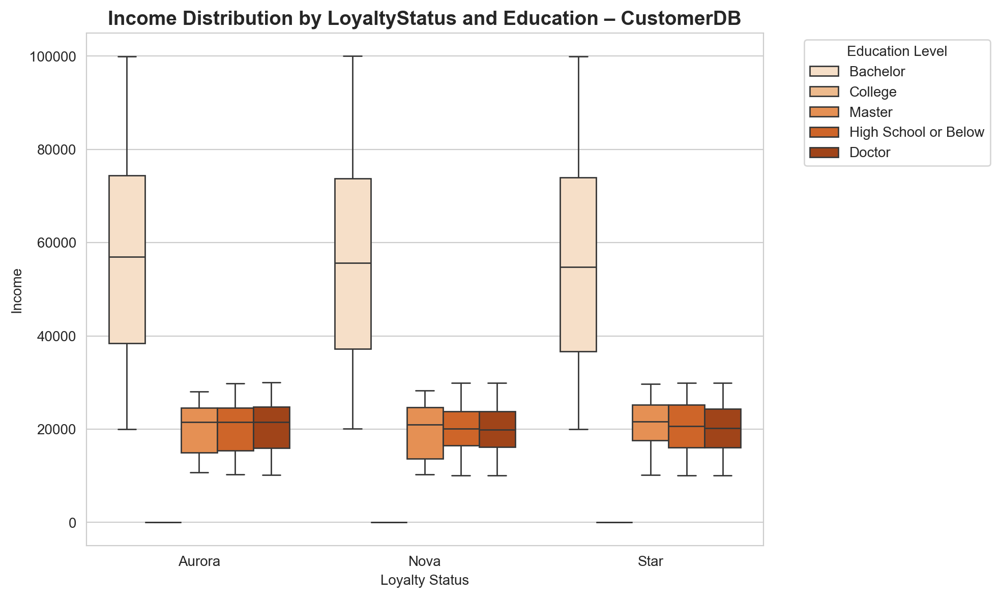

In [165]:
plt.figure(figsize=(10,6))
sns.boxplot(
    data=customer,
    x="LoyaltyStatus",
    y="Income",
    hue="Education",
    order=["Aurora", "Nova", "Star"],
    palette="Oranges"
)

plt.title("Income Distribution by LoyaltyStatus and Education – CustomerDB", fontsize=14, fontweight="bold")
plt.xlabel("Loyalty Status")
plt.ylabel("Income")
plt.legend(title="Education Level", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

The boxplot shows clear income differences by education level across all loyalty tiers. Customers with Bachelor or College degrees consistently earn more, while those with lower education levels remain concentrated in lower income brackets. This pattern is stable across Aurora, Nova, and Star, indicating that education is a stronger driver of income than loyalty status alone.

#### 3.1.6.3 Income vs Gender vs Education vs Location Code

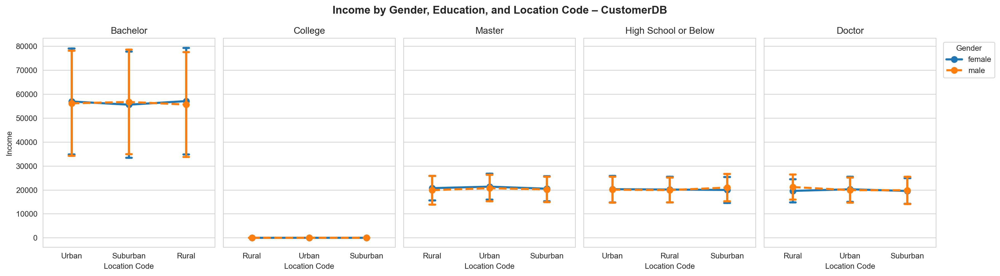

In [ ]:
xfeat, yfeat, huefeat = "Location Code", "Income", "Gender"

df = customer.dropna(subset=[xfeat, yfeat, huefeat, "Education"])

educ_vals = df["Education"].unique()
fig, axes = plt.subplots(
    1, len(educ_vals),
    figsize=(18, 5),
    sharey=True,
    tight_layout=True
)

axes = [axes] if len(educ_vals) == 1 else axes

for ax, educ in zip(axes, educ_vals):
    sns.pointplot(
        data=df[df["Education"] == educ],
        x=xfeat,
        y=yfeat,
        hue=huefeat,
        errorbar="sd",
        capsize=.1,
        linestyles=["-", "--"],
        ax=ax
    )
    ax.set(title=educ, xlabel=xfeat, ylabel=yfeat)
    ax.legend_.remove()

axes[-1].legend(
    title=huefeat,
    loc="upper left",
    bbox_to_anchor=(1.02, 1)
)

fig.suptitle(
    "Income by Gender, Education, and Location Code – CustomerDB",
    fontsize=14,
    fontweight="bold"
)

plt.show()

The plot shows irregularities already mentioned in previous analyses regarding data consistency across education levels. The College group presents income values close to zero for all genders and locations, clearly indicating a data quality issue. This aligns with earlier observations of unexpected zero-income cases and reinforces the need for data validation before using this variable in modeling or clustering.

Additionally, the fact that Bachelor customers appear to earn more than Master or Doctor contradicts normal socioeconomic expectations. Still, the location effect remains consistent, with Urban and Suburban areas showing slightly higher incomes than Rural, and gender differences continuing to be minimal. Overall, education maintains its relevance for segmentation, but any interpretation involving it must consider the underlying data inconsistencies already identified.

#### 3.1.6.4 Customer Lifetime Value vs Gender, Education and LoyaltyStatus

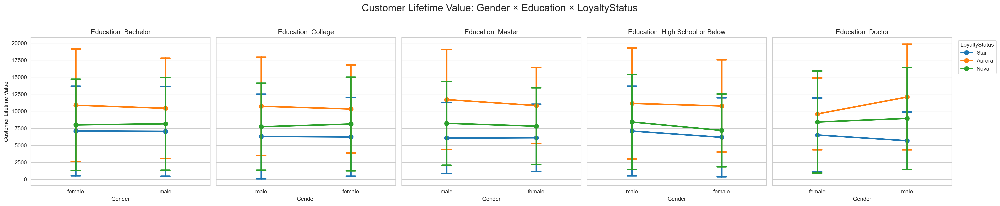

In [ ]:
cat1, cat2, cat3 = "Gender", "Education", "LoyaltyStatus"
yfeat = "Customer Lifetime Value"

df = customer.dropna(subset=[cat1, cat2, cat3, yfeat])

educ_vals = df[cat2].unique()

fig, axes = plt.subplots(
    1, len(educ_vals),
    figsize=(5 * len(educ_vals), 5),
    sharey=True,
    tight_layout=True
)

axes = [axes] if len(educ_vals) == 1 else axes

for ax, educ in zip(axes, educ_vals):
    sns.pointplot(
        data=df[df[cat2] == educ],
        x=cat1,
        y=yfeat,
        hue=cat3,
        errorbar="sd",
        capsize=.1,
        ax=ax
    )
    ax.set(title=f"Education: {educ}", xlabel=cat1)
    ax.legend_.remove()

axes[0].set_ylabel(yfeat)

axes[-1].legend(
    title=cat3,
    loc="upper left",
    bbox_to_anchor=(1.02, 1)
)

fig.suptitle(
    f"{yfeat}: {cat1} × {cat2} × {cat3}",
    fontsize=18,
    y=1.02
)

plt.show()

The chart shows that Aurora members consistently exhibit the highest Customer Lifetime Value across all education levels, followed by Nova and then Star. Gender differences remain negligible, and education introduces only slight variation, confirming that LoyaltyStatus is the primary factor explaining value differences, while other variables play a minimal role.

#### 3.1.6.5 Customer Lifetime Value vs Gender, Location Code and LoyaltyStatus

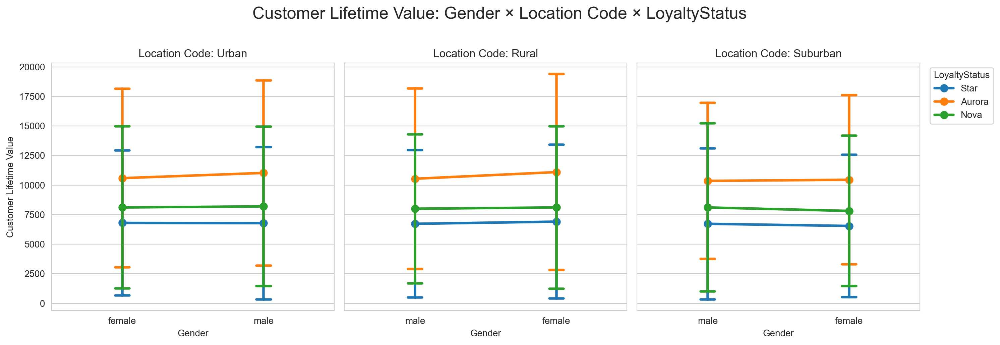

In [170]:
cat1, cat2, cat3 = "Gender", "Location Code", "LoyaltyStatus"
yfeat = "Customer Lifetime Value"

df = customer.dropna(subset=[cat1, cat2, cat3, yfeat])

cat2_vals = df[cat2].unique()

fig, axes = plt.subplots(
    1, len(cat2_vals),
    figsize=(5 * len(cat2_vals), 5),
    sharey=True,
    tight_layout=True
)

axes = [axes] if len(cat2_vals) == 1 else axes

for ax, loc in zip(axes, cat2_vals):
    sns.pointplot(
        data=df[df[cat2] == loc],
        x=cat1,
        y=yfeat,
        hue=cat3,
        errorbar="sd",
        capsize=.1,
        ax=ax
    )
    ax.set(title=f"{cat2}: {loc}", xlabel=cat1)
    ax.legend_.remove()

axes[0].set_ylabel(yfeat)

axes[-1].legend(
    title=cat3,
    loc="upper left",
    bbox_to_anchor=(1.02, 1)
)

fig.suptitle(
    f"{yfeat}: {cat1} × {cat2} × {cat3}",
    fontsize=18,
    y=1.02
)

plt.show()

Across all location categories, Aurora members maintain the highest Customer Lifetime Value, followed by Nova and Star, with this ranking stable across both genders. The lines are nearly flat, indicating negligible gender influence, while differences between Rural, Suburban, and Urban customers are minimal. Overall, LoyaltyStatus remains the key differentiator of CLV, with location and gender contributing little additional variation.

#### 3.1.6.6 Customer Lifetime Value vs Gender, Marital Status and LoyaltyStatus

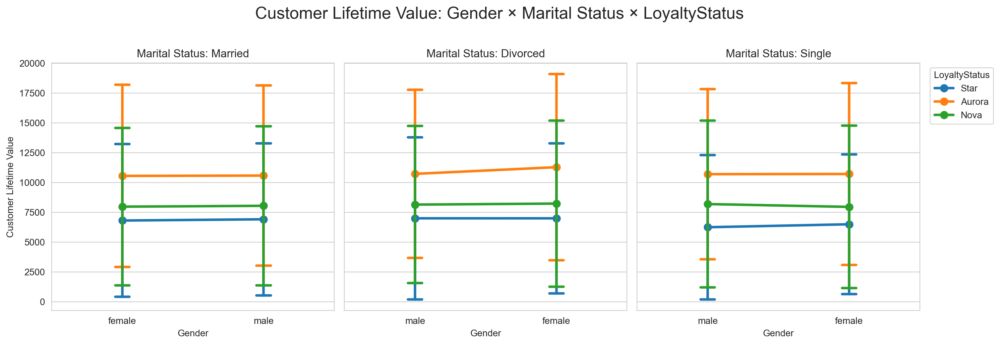

In [171]:
cat1, cat2, cat3 = "Gender", "Marital Status", "LoyaltyStatus"
yfeat = "Customer Lifetime Value"

df = customer.dropna(subset=[cat1, cat2, cat3, yfeat])

cat2_vals = df[cat2].unique()

fig, axes = plt.subplots(
    1, len(cat2_vals),
    figsize=(5 * len(cat2_vals), 5),
    sharey=True,
    tight_layout=True
)

# garante iterável
axes = [axes] if len(cat2_vals) == 1 else axes

for ax, status in zip(axes, cat2_vals):
    sns.pointplot(
        data=df[df[cat2] == status],
        x=cat1,
        y=yfeat,
        hue=cat3,
        errorbar="sd",
        capsize=.1,
        ax=ax
    )
    ax.set(title=f"{cat2}: {status}", xlabel=cat1)
    ax.legend_.remove()

axes[0].set_ylabel(yfeat)

# legenda única
axes[-1].legend(
    title=cat3,
    loc="upper left",
    bbox_to_anchor=(1.02, 1)
)

fig.suptitle(
    f"{yfeat}: {cat1} × {cat2} × {cat3}",
    fontsize=18,
    y=1.02
)

plt.show()

Across all marital status groups, Aurora members maintain the highest Customer Lifetime Value, followed by Nova and Star, with this hierarchy consistent for both genders. The nearly parallel lines indicate minimal gender differences, and the distributions across marital categories are highly similar, confirming that LoyaltyStatus remains the main determinant of CLV regardless of marital status.

#### 3.1.6.7 Customer Lifetime Value vs Education, Location Code and LoyaltyStatus

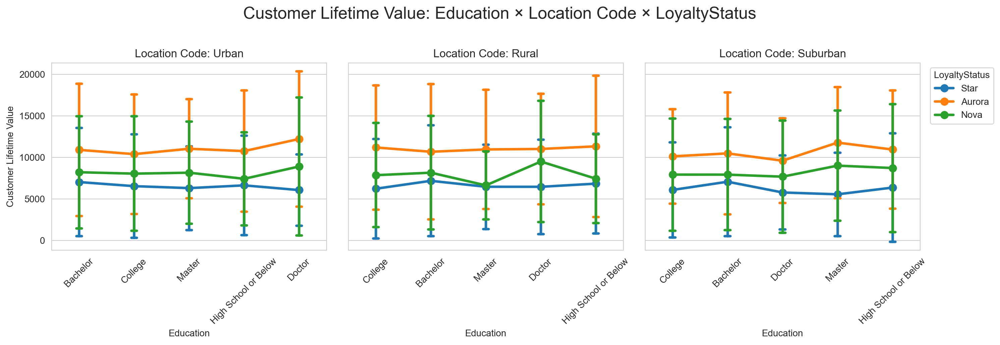

In [ ]:
cat1, cat2, cat3 = "Education", "Location Code", "LoyaltyStatus"
yfeat = "Customer Lifetime Value"

df = customer.dropna(subset=[cat1, cat2, cat3, yfeat])

cat2_vals = df[cat2].unique()

fig, axes = plt.subplots(
    1, len(cat2_vals),
    figsize=(5 * len(cat2_vals), 5),
    sharey=True,
    tight_layout=True
)

axes = [axes] if len(cat2_vals) == 1 else axes

for ax, loc in zip(axes, cat2_vals):
    sns.pointplot(
        data=df[df[cat2] == loc],
        x=cat1,
        y=yfeat,
        hue=cat3,
        errorbar="sd",
        capsize=.1,
        ax=ax
    )
    ax.set(title=f"{cat2}: {loc}", xlabel=cat1)
    ax.tick_params(axis="x", rotation=45)
    ax.legend_.remove()

axes[0].set_ylabel(yfeat)

axes[-1].legend(
    title=cat3,
    loc="upper left",
    bbox_to_anchor=(1.02, 1)
)

fig.suptitle(
    f"{yfeat}: {cat1} × {cat2} × {cat3}",
    fontsize=18,
    y=1.02
)

plt.show()

Across all location types, Aurora members consistently achieve the highest Customer Lifetime Value, followed by Nova and Star, with this order stable across education levels. CLV differences between education groups are minor and show no clear trend, while the three locations display very similar patterns, reinforcing that LoyaltyStatus remains the dominant explanatory factor and that neither education nor location significantly alters customer value.

#### 3.1.6.8 Customer Lifetime Value vs Education, Marital Status and Loyalty Status

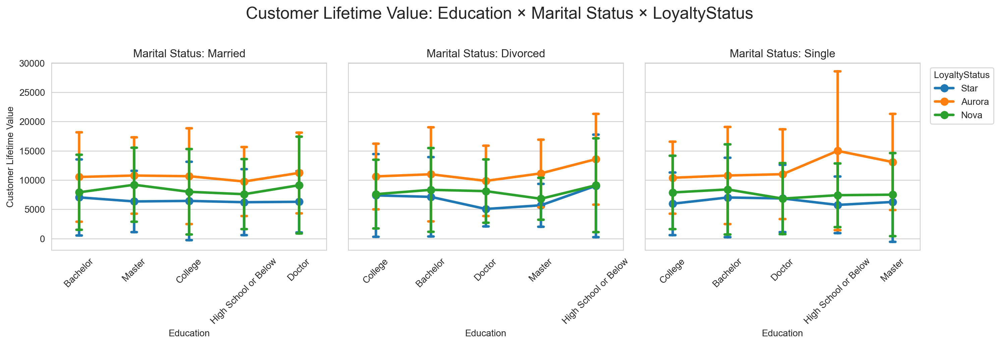

In [174]:
cat1, cat2, cat3 = "Education", "Marital Status", "LoyaltyStatus"
yfeat = "Customer Lifetime Value"

df = customer.dropna(subset=[cat1, cat2, cat3, yfeat])

cat2_vals = df[cat2].unique()

fig, axes = plt.subplots(
    1, len(cat2_vals),
    figsize=(5 * len(cat2_vals), 5),
    sharey=True,
    tight_layout=True
)

axes = [axes] if len(cat2_vals) == 1 else axes

for ax, status in zip(axes, cat2_vals):
    sns.pointplot(
        data=df[df[cat2] == status],
        x=cat1,
        y=yfeat,
        hue=cat3,
        errorbar="sd",
        capsize=.1,
        ax=ax
    )
    ax.set(title=f"{cat2}: {status}", xlabel=cat1)
    ax.tick_params(axis="x", rotation=45)
    ax.legend_.remove()

axes[0].set_ylabel(yfeat)

axes[-1].legend(
    title=cat3,
    loc="upper left",
    bbox_to_anchor=(1.02, 1)
)

fig.suptitle(
    f"{yfeat}: {cat1} × {cat2} × {cat3}",
    fontsize=18,
    y=1.02
)

plt.show()

Across all marital status groups, Aurora members maintain the highest Customer Lifetime Value, followed by Nova and Star, with this hierarchy consistent across education levels. While CLV varies slightly within education categories, no clear trend emerges, and the patterns across marital statuses are nearly identical, confirming that LoyaltyStatus remains the primary determinant of customer value, whereas education and marital status exert only marginal influence.

## 3.2 FlightsDB

### 3.2.1. Numerical Variables' Univariate Analysis

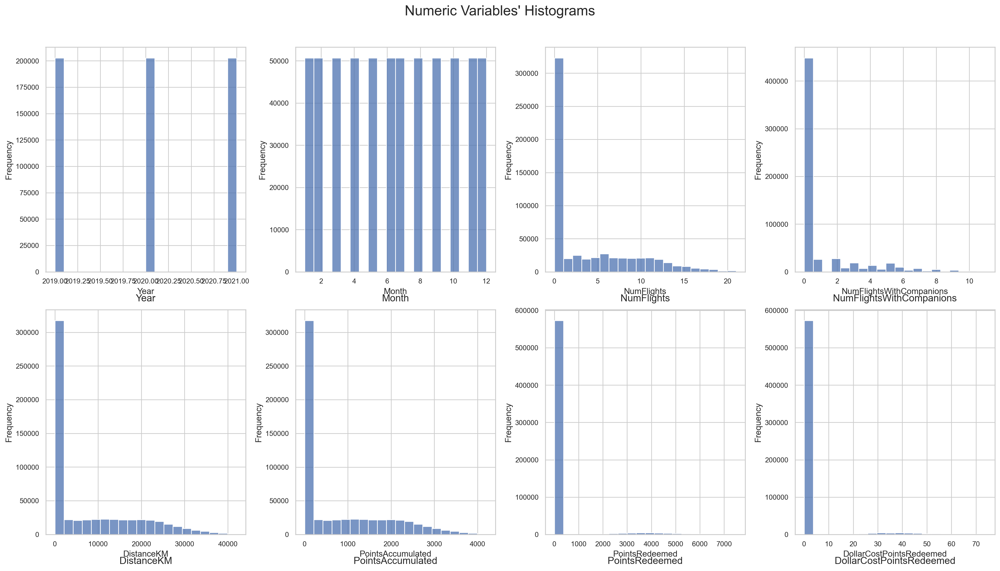

In [176]:
sp_rows = 2
sp_cols = ceil(len(metric_features_flights) / sp_rows)

fig, axes = plt.subplots(
    sp_rows,
    sp_cols,
    figsize=(20, 11),
    tight_layout=True
)

for ax, feat in zip(axes.flatten(), metric_features_flights):
    data = pd.to_numeric(flights[feat], errors="coerce").dropna()
    
    sns.histplot(
        data,
        bins=20,
        ax=ax
    )
    
    ax.set_title(feat, fontsize=14, y=-0.15)
    ax.set_ylabel("Frequency", fontsize=12)
    ax.tick_params(axis="both", which="major", labelsize=10)

# Remove axes extra (se existirem)
for ax in axes.flatten()[len(metric_features_flights):]:
    ax.remove()

plt.suptitle(
    "Numeric Variables' Histograms",
    fontsize=20,
    y=1.02
)

plt.show()

- **'Year'** shows that flights are relatively well distributed across 2019, 2020, and 2021.
- **'Month'** exhibits a similar uniform distribution pattern throughout the year.
- As we did to 'Customer Lifetime Value' in the CustomerDB, we will use a logarithmic histogram to better understand the highly skewed graphics

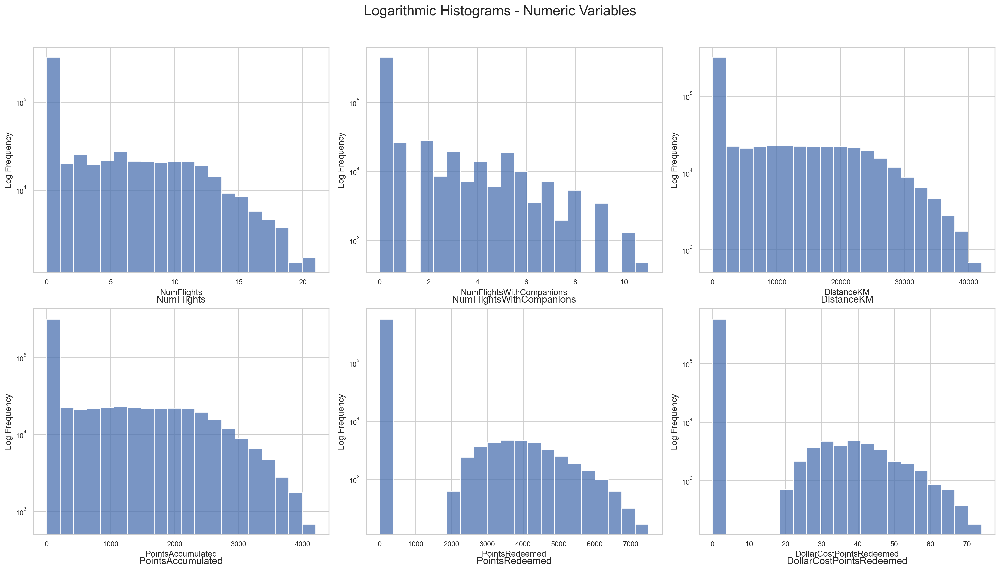

In [ ]:
metric_features_flights_filtered = [
    feat for feat in metric_features_flights if feat not in ["Year", "Month"]
]

sp_rows = 2
sp_cols = ceil(len(metric_features_flights_filtered) / sp_rows)

fig, axes = plt.subplots(sp_rows, sp_cols, figsize=(20, 11), tight_layout=True)

for ax, feat in zip(axes.flatten(), metric_features_flights_filtered):
    data = pd.to_numeric(flights[feat], errors="coerce").dropna()
    sns.histplot(data, bins=20, ax=ax, legend=False)
    ax.set_yscale("log")
    ax.set_title(feat, fontsize=14, y=-0.15)
    ax.set_ylabel("Log Frequency", fontsize=12)
    ax.tick_params(axis="both", which="major", labelsize=10)
    
    # Remover legenda explicitamente
    if ax.get_legend():
        ax.get_legend().remove()

# Remover eixos extra
for ax in axes.flatten()[len(metric_features_flights_filtered):]:
    ax.remove()

plt.suptitle("Logarithmic Histograms - Numeric Variables", fontsize=20, y=1.02)
plt.show()

- As previously observed, **zero values are highly prevalent** across all numeric variables.
- **'PointsRedeemed'** and **'DollarCostPointsRedeemed'** exhibit remarkably similar distributions. Their correlation will be examined below.
- A comparable relationship is apparent between **'DistanceKM'** and **'PointsAccumulated'**.

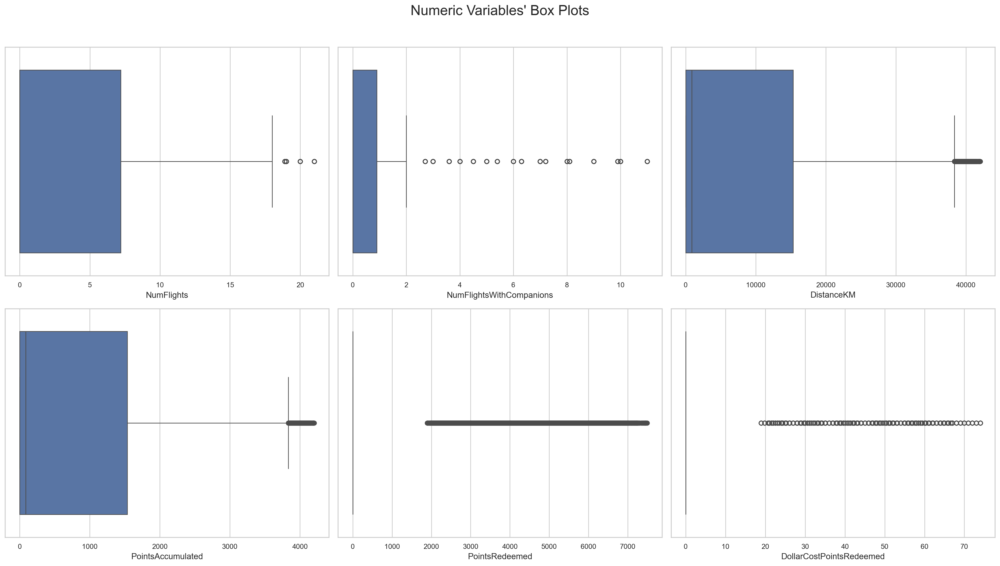

In [184]:
metric_features_flights_filtered = [feat for feat in metric_features_flights if feat not in ['Year', 'Month']]

fig, axes = plt.subplots(sp_rows, 
                         sp_cols, 
                         figsize=(20, 11),
                         tight_layout=True)

for ax, feat in zip(axes.flatten(), metric_features_flights_filtered):
    data = pd.to_numeric(flights[feat], errors='coerce').dropna()
    sns.boxplot(x=data, ax=ax)
    ax.tick_params(axis='both', which='major', labelsize=10)

plt.suptitle("Numeric Variables' Box Plots", fontsize=20, y=1.02)

plt.show()

- Due to the high proportion of zeros (at least 25%) in all numeric variables, the boxplots are heavily skewed to the left.

- Since more than 75% of the values in `PointsRedeemed` and `DollarCostPointsRedeemed` are zeros, the apparent outliers actually represent the most valuable data points and will not be removed.

- For `PointsAccumulated` and `DistanceKM`, the higher values represent our most engaged, long-distance travelers, who are of particular interest for analysis. These observations will also be retained.

- Similarly, for `NumFlights` and `NumFlightsWithCompanions`, the higher values are more informative than the zeros and provide crucial insights into frequent flyers' behavior.

#### 3.2.1.1 Number of Flights

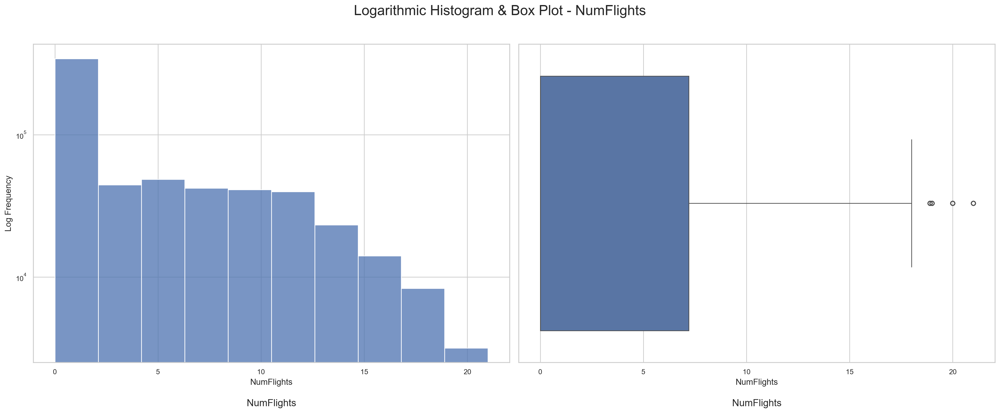

In [188]:
data = pd.to_numeric(flights["NumFlights"], errors="coerce").dropna()

fig, axes = plt.subplots(1, 2, figsize=(20, 8), tight_layout=True)

sns.histplot(data, ax=axes[0], bins=10, legend=False)
axes[0].set_yscale("log")
axes[0].set_title("NumFlights", fontsize=14, y=-0.15)
axes[0].set_ylabel("Log Frequency", fontsize=12)
axes[0].set_xlabel("NumFlights", fontsize=12)
axes[0].tick_params(axis="both", which="major", labelsize=10)

sns.boxplot(x=data, ax=axes[1])
axes[1].set_title("NumFlights", fontsize=14, y=-0.15)
axes[1].set_xlabel("NumFlights", fontsize=12)
axes[1].tick_params(axis="both", which="major", labelsize=10)

plt.suptitle(
    "Logarithmic Histogram & Box Plot - NumFlights",
    fontsize=20,
    y=1.02
)

plt.show()

#### 3.2.1.2 Number of Flights with Companions

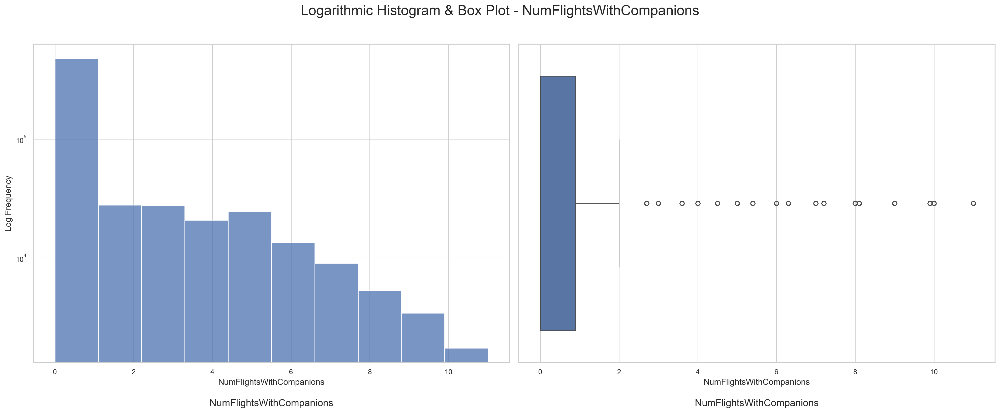

In [187]:
data = pd.to_numeric(flights["NumFlightsWithCompanions"], errors="coerce").dropna()

fig, axes = plt.subplots(1, 2, figsize=(20, 8), tight_layout=True)

sns.histplot(data, ax=axes[0], bins=10, legend=False)
axes[0].set_yscale("log")
axes[0].set_title("NumFlightsWithCompanions", fontsize=14, y=-0.15)
axes[0].set_ylabel("Log Frequency", fontsize=12)
axes[0].set_xlabel("NumFlightsWithCompanions", fontsize=12)
axes[0].tick_params(axis="both", which="major", labelsize=10)

sns.boxplot(x=data, ax=axes[1])
axes[1].set_title("NumFlightsWithCompanions", fontsize=14, y=-0.15)
axes[1].set_xlabel("NumFlightsWithCompanions", fontsize=12)
axes[1].tick_params(axis="both", which="major", labelsize=10)

plt.suptitle(
    "Logarithmic Histogram & Box Plot - NumFlightsWithCompanions",
    fontsize=20,
    y=1.02
)

plt.show()

#### 3.2.1.3 Distance KM

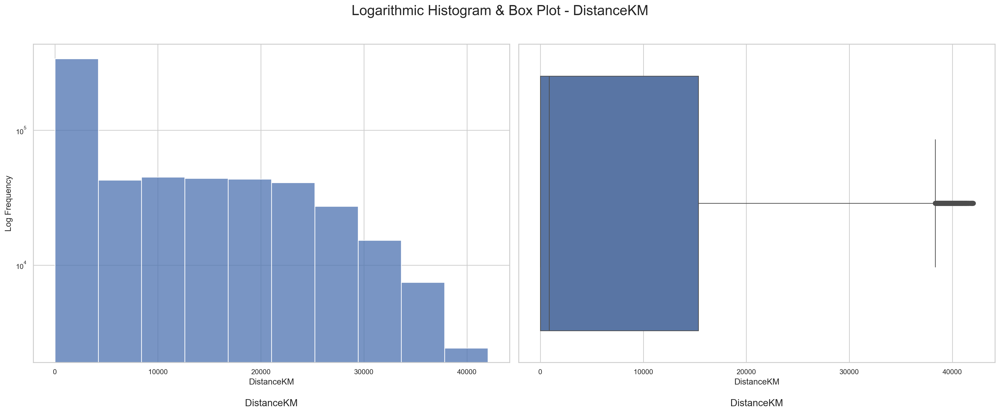

In [189]:
data = pd.to_numeric(flights["DistanceKM"], errors="coerce").dropna()

fig, axes = plt.subplots(1, 2, figsize=(20, 8), tight_layout=True)

sns.histplot(data, ax=axes[0], bins=10, legend=False)
axes[0].set_yscale("log")
axes[0].set_title("DistanceKM", fontsize=14, y=-0.15)
axes[0].set_ylabel("Log Frequency", fontsize=12)
axes[0].set_xlabel("DistanceKM", fontsize=12)
axes[0].tick_params(axis="both", which="major", labelsize=10)

sns.boxplot(x=data, ax=axes[1])
axes[1].set_title("DistanceKM", fontsize=14, y=-0.15)
axes[1].set_xlabel("DistanceKM", fontsize=12)
axes[1].tick_params(axis="both", which="major", labelsize=10)

plt.suptitle(
    "Logarithmic Histogram & Box Plot - DistanceKM",
    fontsize=20,
    y=1.02
)

plt.show()

#### 3.2.1.4 Points Accumulated

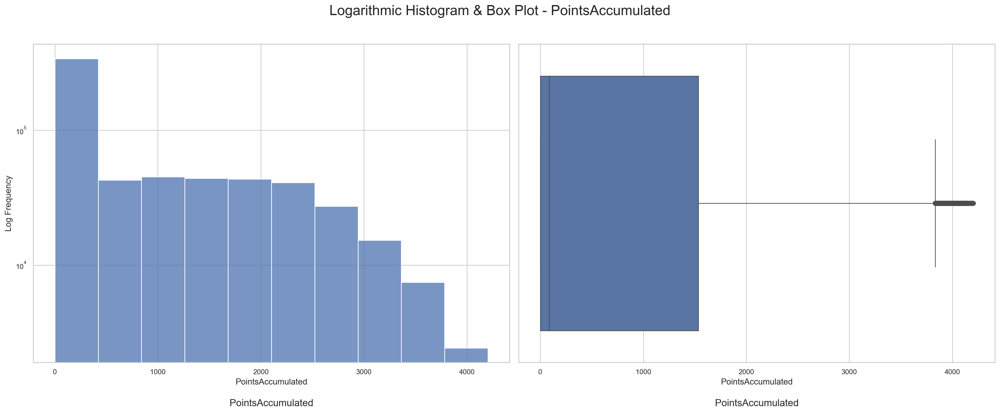

In [191]:
data = pd.to_numeric(flights["PointsAccumulated"], errors="coerce").dropna()

fig, axes = plt.subplots(1, 2, figsize=(20, 8), tight_layout=True)

sns.histplot(data, ax=axes[0], bins=10, legend=False)
axes[0].set_yscale("log")
axes[0].set_title("PointsAccumulated", fontsize=14, y=-0.15)
axes[0].set_ylabel("Log Frequency", fontsize=12)
axes[0].set_xlabel("PointsAccumulated", fontsize=12)
axes[0].tick_params(axis="both", which="major", labelsize=10)

sns.boxplot(x=data, ax=axes[1])
axes[1].set_title("PointsAccumulated", fontsize=14, y=-0.15)
axes[1].set_xlabel("PointsAccumulated", fontsize=12)
axes[1].tick_params(axis="both", which="major", labelsize=10)

plt.suptitle(
    "Logarithmic Histogram & Box Plot - PointsAccumulated",
    fontsize=20,
    y=1.02
)

plt.show()

#### 3.2.1.5 Points Redeemed

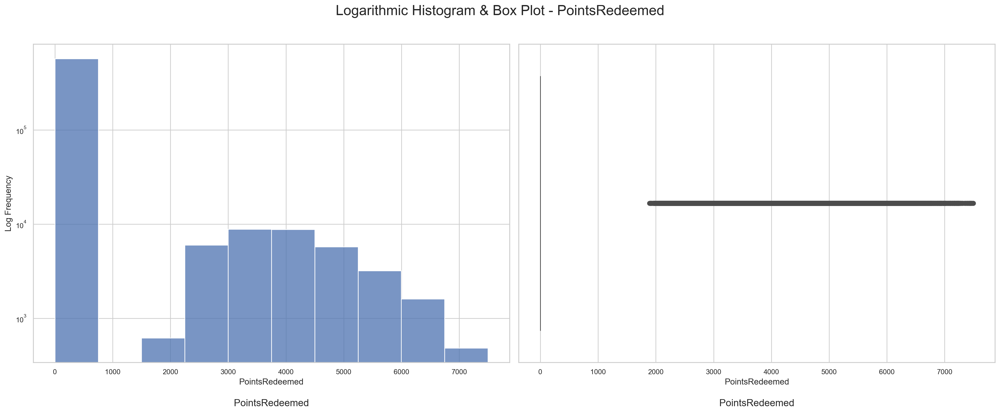

In [192]:
data = pd.to_numeric(flights["PointsRedeemed"], errors="coerce").dropna()

fig, axes = plt.subplots(1, 2, figsize=(20, 8), tight_layout=True)

sns.histplot(data, ax=axes[0], bins=10, legend=False)
axes[0].set_yscale("log")
axes[0].set_title("PointsRedeemed", fontsize=14, y=-0.15)
axes[0].set_ylabel("Log Frequency", fontsize=12)
axes[0].set_xlabel("PointsRedeemed", fontsize=12)
axes[0].tick_params(axis="both", which="major", labelsize=10)

sns.boxplot(x=data, ax=axes[1])
axes[1].set_title("PointsRedeemed", fontsize=14, y=-0.15)
axes[1].set_xlabel("PointsRedeemed", fontsize=12)
axes[1].tick_params(axis="both", which="major", labelsize=10)

plt.suptitle(
    "Logarithmic Histogram & Box Plot - PointsRedeemed",
    fontsize=20,
    y=1.02
)

plt.show()

#### 3.2.1.6 Dollar Cost Points Redeemed

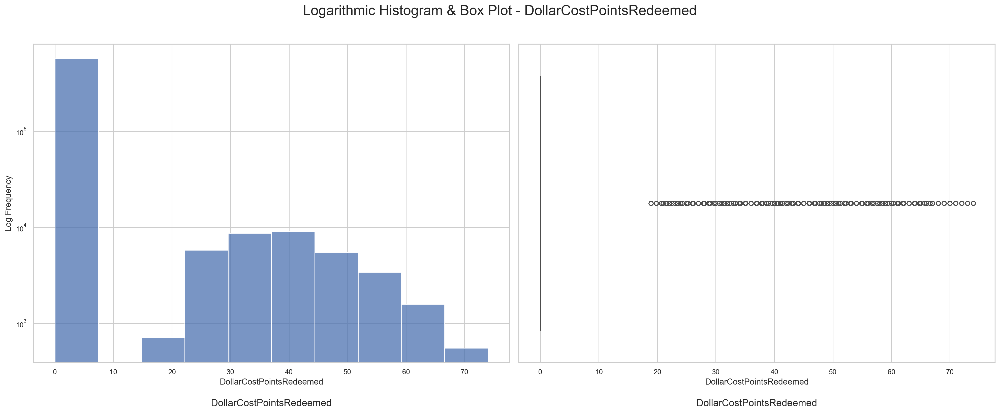

In [194]:
data = pd.to_numeric(flights["DollarCostPointsRedeemed"], errors="coerce").dropna()

fig, axes = plt.subplots(1, 2, figsize=(20, 8), tight_layout=True)

sns.histplot(data, ax=axes[0], bins=10, legend=False)
axes[0].set_yscale("log")
axes[0].set_title("DollarCostPointsRedeemed", fontsize=14, y=-0.15)
axes[0].set_ylabel("Log Frequency", fontsize=12)
axes[0].set_xlabel("DollarCostPointsRedeemed", fontsize=12)
axes[0].tick_params(axis="both", which="major", labelsize=10)

sns.boxplot(x=data, ax=axes[1])
axes[1].set_title("DollarCostPointsRedeemed", fontsize=14, y=-0.15)
axes[1].set_xlabel("DollarCostPointsRedeemed", fontsize=12)
axes[1].tick_params(axis="both", which="major", labelsize=10)

plt.suptitle(
    "Logarithmic Histogram & Box Plot - DollarCostPointsRedeemed",
    fontsize=20,
    y=1.02
)

plt.show()

### 3.2.2 Numerical Variables' Bivariate Analysis

#### 3.2.2.1 Metric Variables' Correlation Matrix

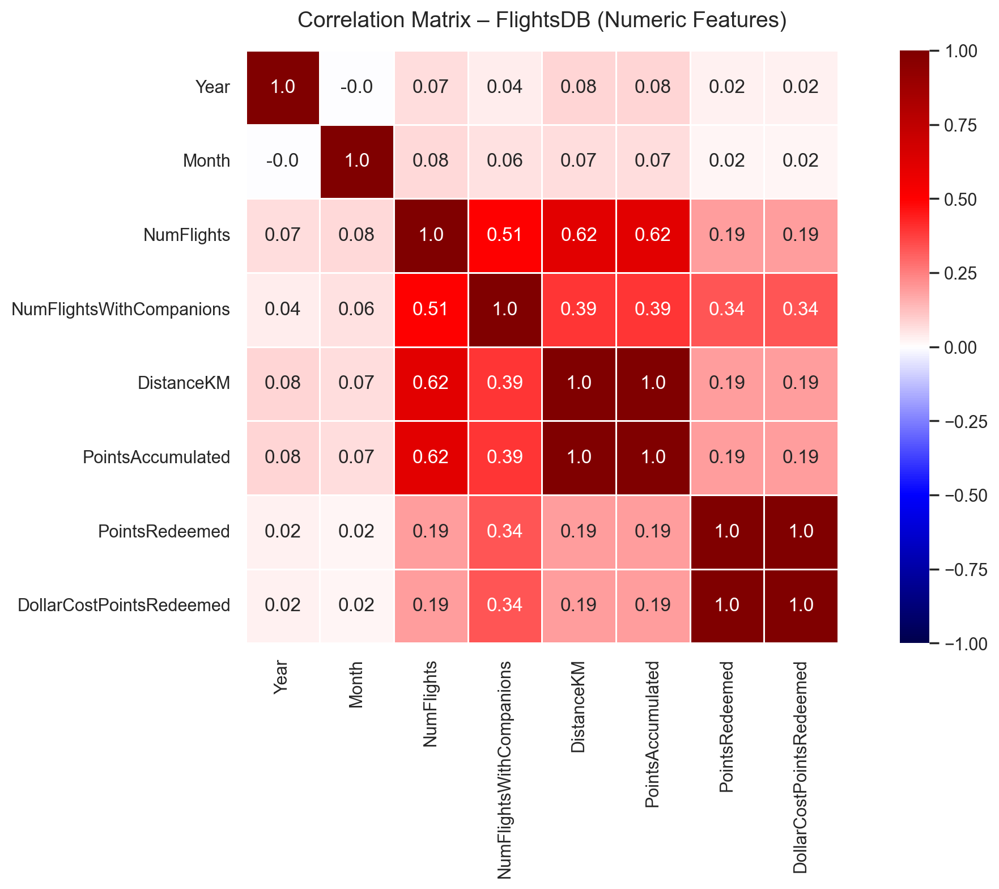

In [ ]:
num_fligths = flights.select_dtypes(include=[np.number])
num_fligths = num_fligths.drop(columns=['Loyalty#'])  
corr = num_fligths.corr(method='pearson')

annot = corr.round(2).astype(str)

plt.figure(figsize=(12, 8))

sns.heatmap(data=corr,
            annot=annot,
            fmt='s',
            vmin=-1, vmax=1,
            center=0,
            square=True,
            linewidths=.5,
            cmap='seismic')

plt.title('Correlation Matrix – FlightsDB (Numeric Features)', fontsize=14, pad=15)
plt.tight_layout()

plt.show()

- There is an exact correlation between 'DollarCostPointsRedeemed' and 'PointsRedeemed' as be previewed before.
- That also happens to 'DistanceKM' and 'PointsAccumulated' which we also previewed.
- There is a high correlation between 'DistanceKM' and 'NumFlightsWithCompanion', between 'PointsRedeemed' and 'NumFlightsWithCompanions'. This extende for the ones perfectly correlated.
- There is also a high correlation between 'NumFlights' and 'NumFlightsWithCompanions' and between 'NumFlights' and 'DistanceKM'.

#### 3.2.2.2 PointsRedeemed vs NumFlights

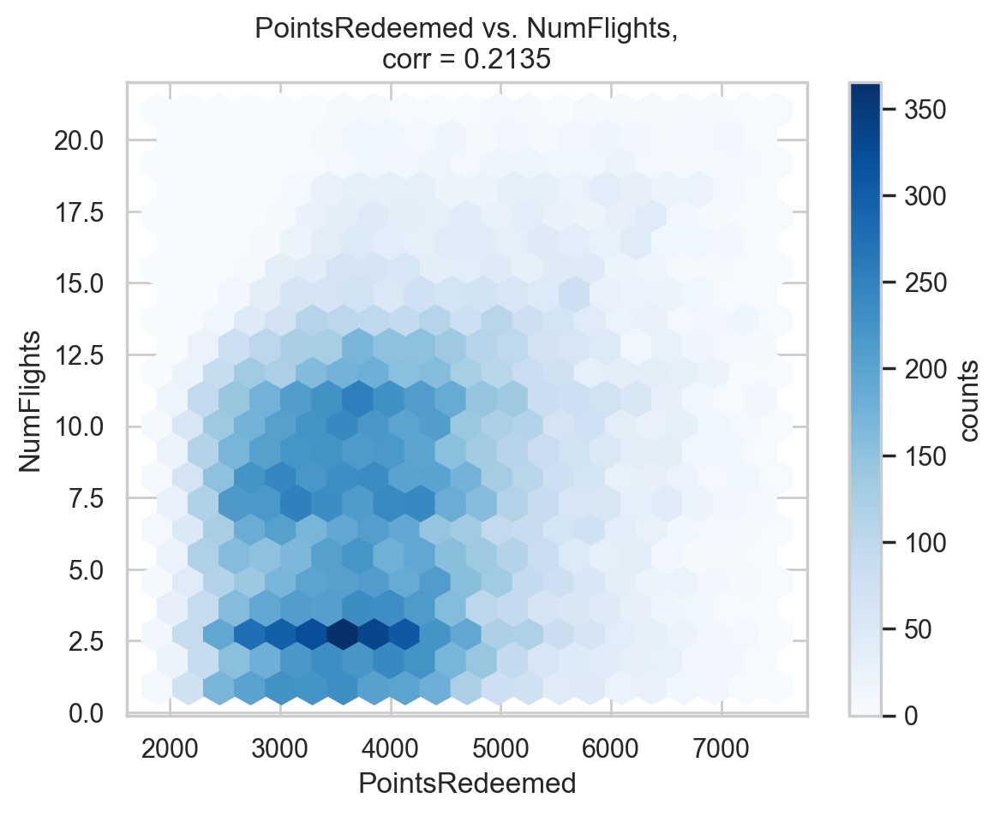

In [198]:

# Filtrar apenas valores > 0
df_active = flights[
    (flights['PointsRedeemed'] > 0) &
    (flights['NumFlights'] > 0)
]

fig, ax = plt.subplots()

hb = ax.hexbin(
    df_active['PointsRedeemed'],
    df_active['NumFlights'],
    gridsize=20,
    cmap='Blues'
)

# Calcular correlação com base apenas nos dados filtrados
corr = df_active[['PointsRedeemed', 'NumFlights']].corr().values[0, 1]

ax.set_title(f"PointsRedeemed vs. NumFlights,\ncorr = {np.round(corr, 4)}")
ax.set_xlabel("PointsRedeemed")
ax.set_ylabel("NumFlights")

cb = fig.colorbar(hb, ax=ax, label='counts')

plt.show()


Only customers with values above zero were included, as entries with null values would cluster around the origin and distort the visualization of the actual relationship between redemption and flight activity. This filtering isolates the behavior of passengers who have both flown and redeemed points, giving a clearer picture of active program engagement.

The plot shows a weak-to-moderate positive relationship (corr ≈ 0.21) between PointsRedeemed and NumFlights, concentrated mainly around 2.5–4 flights and 3000–4500 redeemed points. This indicates that most active customers redeem modest amounts of points relative to a small number of flights, while higher redemption values are progressively less frequent. The trend suggests typical loyalty behavior, where redemption grows with experience but remains uneven across the customer base.

#### 3.2.2.3 Points Accumulated vs NumFlights

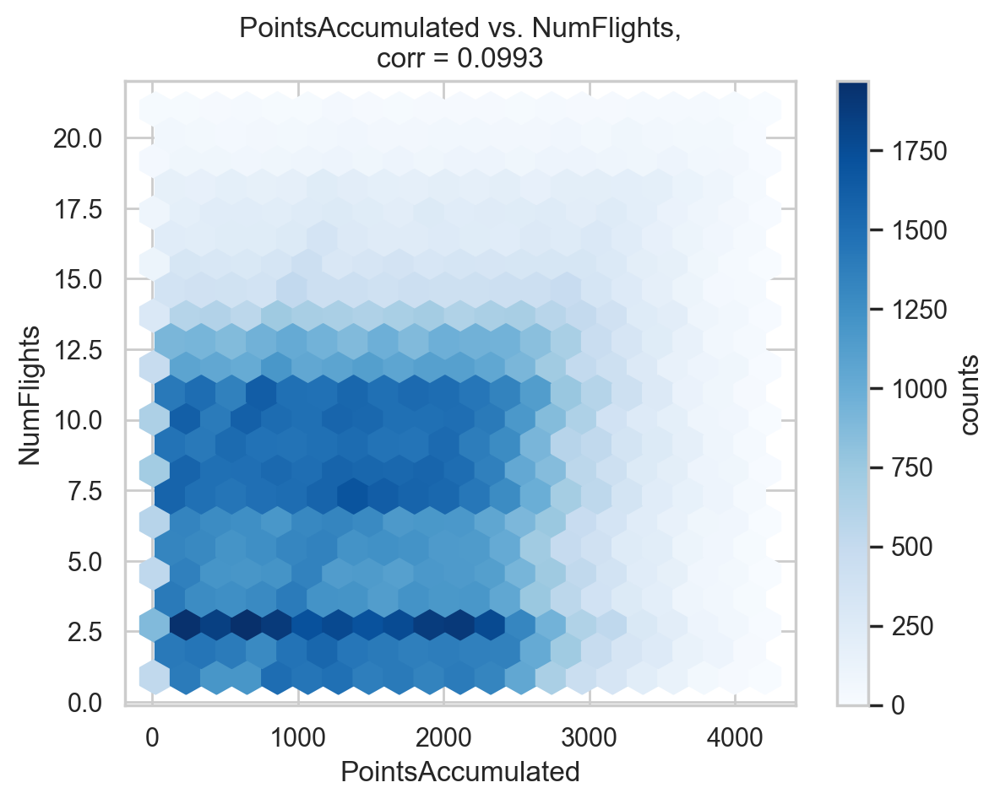

In [199]:
df_active = flights[
    (flights['PointsAccumulated'] > 0) &
    (flights['NumFlights'] > 0)
]

fig, ax = plt.subplots()

hb = ax.hexbin(
    df_active['PointsAccumulated'],
    df_active['NumFlights'],
    gridsize=20,
    cmap='Blues'
)

corr = df_active[['PointsAccumulated', 'NumFlights']].corr().values[0, 1]

ax.set_title(f"PointsAccumulated vs. NumFlights,\ncorr = {np.round(corr, 4)}")
ax.set_xlabel("PointsAccumulated")
ax.set_ylabel("NumFlights")

cb = fig.colorbar(hb, ax=ax, label='counts')

plt.show()


Only customers with nonzero values were included, as null records would cluster near the origin and distort the visualization of the relationship between flight activity and point accumulation. This filtering isolates the subset of active travelers who have both flown and earned points, providing a clearer perspective on program engagement.

The plot reveals a very weak positive correlation (corr ≈ 0.10) between PointsAccumulated and NumFlights, with a pronounced density cluster around 2.5 flights and up to 2000 accumulated points. This concentration suggests that a large share of customers engage with the program through a small number of flights, earning modest point totals before becoming inactive. Beyond this cluster, the data become more dispersed, indicating that higher point accumulation is limited to a smaller group of frequent travelers with more consistent engagement patterns.

# 4. Data quality

## 4.1 CustomerDB

### 4.1.1 Strange Values

Previsouly, it was seen that approximately 25% of records report “0” income, indicating that these likely correspond to missing or unreported values rather than actual income.

In [202]:
# Analyse only the statistics for the population in which the income == 0
customer_zero_income = customer[customer['Income'] == 0]
customer_zero_income.shape

(4273, 20)

In [203]:
customer_zero_income.describe(include='all').T

,count,unique,top,freq,mean,min,25%,50%,75%,max,std
Loyalty#,4273.0,NaN,NaN,NaN,549938.074889,100102.0,331184.0,548244.0,765446.0,999982.0,255481.607337
First Name,4273,2843,Andrew,7,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Last Name,4273,4165,Kesson,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Customer Name,4273,4273,Dayle Menez,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Country,4273,1,Canada,4273,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Province or State,4273,11,Ontario,1398,NaN,NaN,NaN,NaN,NaN,NaN,NaN
City,4273,29,Toronto,845,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Latitude,4273.0,NaN,NaN,NaN,47.180149,42.984924,44.231171,46.087818,49.28273,60.721188,3.291495
Longitude,4273.0,NaN,NaN,NaN,-92.199616,-135.05684,-120.23766,-79.383186,-74.596184,-52.712578,22.263138
Postal code,4273,55,V6E 3D9,240,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [204]:
customer[customer['Income'] == 0]['Marital Status'].value_counts(normalize=True)

Marital Status
Single      0.573134
Married     0.337468
Divorced    0.089399
Name: proportion, dtype: float64

- There are 4,273 customers (25% out of all) with Income = 0, which likely represents missing or unreported data rather than real values.

- Most are from Ontario and Toronto, mainly single (although only 57%, which means 43% are either married or divorced), male, and with College education (above 18 years).

- Their average Customer Lifetime Value is still high, so income zero doesn’t match spending behavior.

- These should be treated as strange(missing) values rather than real income, and will be later imputed.

This short check identifies customers whose cancellation date is earlier than their enrollment date. At first instance, these cases were assumed to be an error. But as noted in section 8.5.2, they could represent customers who canceled their membership and later reactivated it under the same loyalty number.

In [205]:
# Check for cancellation dates earlier than enrollment dates
mask = (
    customer["CancellationDate"].notna()
    & customer["EnrollmentDateOpening"].notna()
    & (customer["CancellationDate"] < customer["EnrollmentDateOpening"])
)

# Select inconsistent records
bad_dates = customer.loc[mask, ["Loyalty#", "EnrollmentDateOpening", "CancellationDate"]]

print("Inconsistent date records found:", len(bad_dates))
print(" ")
print(bad_dates.head())


Inconsistent date records found: 202
 
     Loyalty# EnrollmentDateOpening CancellationDate
72     357549            2021-09-21       2019-05-21
77     265297            2021-07-17       2019-03-17
176    845613            2021-10-13       2019-06-13
210    830547            2021-05-11       2019-01-11
304    514900            2021-07-20       2019-03-20


### 4.1.2 Duplicate Values

In [206]:
num_duplicated = customer['Loyalty#'].duplicated(keep=False).sum()
print(f"Total number of rows with duplicated Loyalty IDs: {num_duplicated}")

Total number of rows with duplicated Loyalty IDs: 327


There are 327 duplicated Loyalty#. As this is the ID for the customers, this number can't be duplicated. On step 5.1.2 this will be dealt with

### 4.1.3 Missing Values

In [207]:
customer.isna().sum()

Loyalty#                       0
First Name                     0
Last Name                      0
Customer Name                  0
Country                        0
Province or State              0
City                           0
Latitude                       0
Longitude                      0
Postal code                    0
Gender                         0
Education                      0
Location Code                  0
Income                        20
Marital Status                 0
LoyaltyStatus                  0
EnrollmentDateOpening          0
CancellationDate           14613
Customer Lifetime Value       20
EnrollmentType                 0
dtype: int64

There are 14613 missing values in CancellationDate (because the customer didn't cancel yet), and 20 missing values in both Income and Customer Lifetime Value.

## 4.2 FlightsDB

### 4.2.1 Duplicate Values

In [208]:
flights.duplicated().sum()

np.int64(2903)

There are 2903 duplicated entries in this dataset. This problem will be solved in Preprocessing (5.2.2).

### 4.2.2 Strange Values

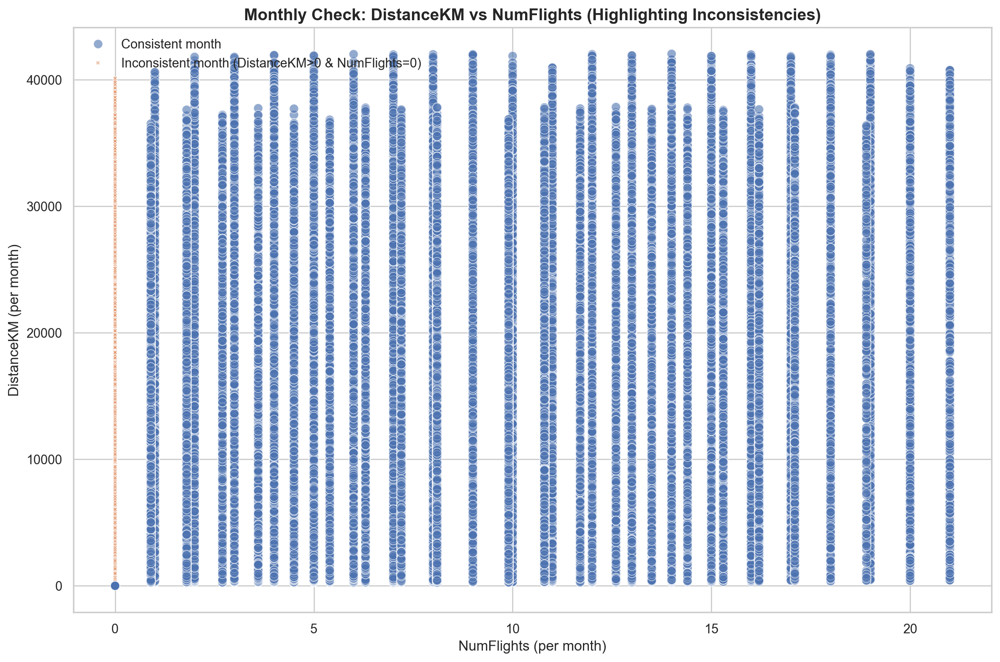

In [209]:
mask_bad = (flights["DistanceKM"] > 0) & (flights["NumFlights"] == 0)

df = flights.assign(
    status=np.where(
        mask_bad,
        "Inconsistent month (DistanceKM>0 & NumFlights=0)",
        "Consistent month"
    )
)

plt.figure(figsize=(12, 8))

sns.scatterplot(
    data=df,
    x="NumFlights",
    y="DistanceKM",
    hue="status",
    style="status",
    size="status",
    sizes=(12, 60),
    alpha=0.6,
    edgecolor="white"
)

plt.title(
    "Monthly Check: DistanceKM vs NumFlights (Highlighting Inconsistencies)",
    fontsize=14,
    fontweight="bold"
)
plt.xlabel("NumFlights (per month)", fontsize=12)
plt.ylabel("DistanceKM (per month)", fontsize=12)
plt.legend(frameon=False, loc="upper left")

plt.tight_layout()
plt.show()

In [210]:
mask = (flights["DistanceKM"] > 0) & (flights["NumFlights"] == 0)
bad_distance = flights.loc[mask].copy()

print("Records with DistanceKM > 0 and NumFlights = 0:", len(bad_distance))
print("Unique customers affected:", bad_distance["Loyalty#"].nunique())

print("\n--- Descriptive Statistics ---")
display(bad_distance.describe())

print("\n--- Sample Records ---")
display(bad_distance.head())

Records with DistanceKM > 0 and NumFlights = 0: 5901
Unique customers affected: 3524

--- Descriptive Statistics ---


,Loyalty#,Year,Month,NumFlights,NumFlightsWithCompanions,DistanceKM,PointsAccumulated,PointsRedeemed,DollarCostPointsRedeemed
count,5901.000000,5901.000000,5901.000000,5901.0,5901.0,5901.000000,5901.000000,5901.0,5901.0
mean,549558.398238,2020.052364,6.630571,0.0,0.0,15777.727300,1577.467680,0.0,0.0
std,259737.647539,0.825527,3.437891,0.0,0.0,9149.305337,914.913266,0.0,0.0
min,100428.000000,2019.000000,1.000000,0.0,0.0,218.700000,21.870000,0.0,0.0
25%,324048.000000,2019.000000,4.000000,0.0,0.0,8528.000000,852.000000,0.0,0.0
50%,556050.000000,2020.000000,7.000000,0.0,0.0,15627.000000,1562.000000,0.0,0.0
75%,767894.000000,2021.000000,10.000000,0.0,0.0,22509.000000,2250.000000,0.0,0.0
max,999982.000000,2021.000000,12.000000,0.0,0.0,40109.000000,4010.000000,0.0,0.0



--- Sample Records ---


,Loyalty#,Year,Month,YearMonthDate,NumFlights,NumFlightsWithCompanions,DistanceKM,PointsAccumulated,PointsRedeemed,DollarCostPointsRedeemed
19,261109,2021,12,12/1/2021,0.0,0.0,13736.0,1373.0,0.0,0.0
93,817609,2021,12,12/1/2021,0.0,0.0,23775.0,2377.0,0.0,0.0
96,192600,2021,12,12/1/2021,0.0,0.0,5119.0,511.0,0.0,0.0
116,883242,2021,12,12/1/2021,0.0,0.0,20681.0,2068.0,0.0,0.0
154,493800,2021,12,12/1/2021,0.0,0.0,17502.0,1750.0,0.0,0.0


There are 11658 entries where the distance a customer travelled is higher than the number of the flights they have taken. This is obsviously a data incosistency and need to be treated.

# 5. Preprocessing

In [211]:
customer.dtypes

Loyalty#                            int64
First Name                         object
Last Name                          object
Customer Name                      object
Country                            object
Province or State                  object
City                               object
Latitude                          float64
Longitude                         float64
Postal code                        object
Gender                             object
Education                          object
Location Code                      object
Income                            float64
Marital Status                     object
LoyaltyStatus                      object
EnrollmentDateOpening      datetime64[ns]
CancellationDate           datetime64[ns]
Customer Lifetime Value           float64
EnrollmentType                     object
dtype: object

## 5.1 CustomerDB

### 5.1.1 Correcting Data Types

In [212]:
cols_to_category = [
    'Gender',
    'LoyaltyStatus',
    'Education',
    'Marital Status',
    'EnrollmentType'
]

customer[cols_to_category] = customer[cols_to_category].astype('category')

customer[cols_to_category].dtypes

Gender            category
LoyaltyStatus     category
Education         category
Marital Status    category
EnrollmentType    category
dtype: object

Low-cardinality variables (Gender, LoyaltyStatus, Education, Marital Status, and EnrollmentType) were converted from object to category data type to improve memory efficiency and computational performance during grouping and modeling operations. High-cardinality fields were intentionally left as object to avoid unnecessary overhead, ensuring a balanced and optimized dataset structure for subsequent analysis.

### 5.1.2 Removing Duplicates

In [213]:
duplicates_active = (
    customer.groupby('Loyalty#')['CancellationDate']
    .apply(lambda x: x.isna().sum())
    .reset_index(name='ActiveCount')
    .query('ActiveCount > 1')
)

# We gave priority to the customers who have active memberships
customer[customer['Loyalty#'].isin(duplicates_active['Loyalty#'])]

,Loyalty#,First Name,Last Name,Customer Name,Country,Province or State,City,Latitude,Longitude,Postal code,Gender,Education,Location Code,Income,Marital Status,LoyaltyStatus,EnrollmentDateOpening,CancellationDate,Customer Lifetime Value,EnrollmentType
5,193662,Leatrice,Hanlin,Leatrice Hanlin,Canada,Yukon,Whitehorse,60.721188,-135.056840,Y2K 6R0,male,Bachelor,Rural,26262.0,Married,Star,2015-05-07,NaT,3844.57,Standard
123,746226,Theodora,Sampieri,Theodora Sampieri,Canada,British Columbia,Whistler,50.116322,-122.957360,V6T 1Y8,female,Bachelor,Urban,43177.0,Married,Star,2021-01-17,NaT,4089.04,Standard
141,279419,Reyes,Sobczak,Reyes Sobczak,Canada,British Columbia,West Vancouver,49.328625,-123.160190,V6V 8Z3,female,College,Urban,0.0,Single,Star,2016-07-03,NaT,4117.37,Standard
161,354438,Maricela,Veals,Maricela Veals,Canada,Quebec,Montreal,45.501690,-73.567253,H2T 2J6,male,College,Rural,0.0,Married,Star,2021-09-01,NaT,4167.09,Standard
370,354438,Marla,Heinicke,Marla Heinicke,Canada,Ontario,Toronto,43.653225,-79.383186,M8Y 4K8,male,Bachelor,Rural,34640.0,Married,Star,2015-07-11,NaT,4530.53,Standard
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16488,373638,Sherryl,Vanduyn,Sherryl Vanduyn,Canada,Quebec,Tremblant,46.118462,-74.596184,H5Y 2S9,female,College,Rural,0.0,Single,Star,2021-07-30,NaT,18898.33,Standard
16625,727507,Marnie,Kisner,Marnie Kisner,Canada,Alberta,Banff,51.178398,-115.570800,T4V 1D4,male,Bachelor,Suburban,93011.0,Divorced,Star,2020-12-26,NaT,22643.83,Standard
16766,278854,Marylee,Villicana,Marylee Villicana,Canada,Quebec,Tremblant,46.118462,-74.596184,H5Y 2S9,female,High School or Below,Urban,20799.0,Single,Star,2017-08-16,NaT,28328.47,Standard
16775,434807,Cira,Nalley,Cira Nalley,Canada,Alberta,Edmonton,53.544388,-113.490930,T9G 1W3,male,Bachelor,Rural,35296.0,Single,Star,2015-08-27,NaT,29194.37,Standard


In [214]:
customer_original[customer_original['Loyalty#'] == 193662][['First Name', 'Last Name', 'City', 'EnrollmentDateOpening']]

,First Name,Last Name,City,EnrollmentDateOpening
5,Leatrice,Hanlin,Whitehorse,5/7/2015
11170,Selena,Marye,Thunder Bay,2/20/2019


In [215]:
len(customer)

16921

In [216]:
_tmp_active = customer['CancellationDate'].isna().astype(int)
_tmp_nonnull = customer.notna().sum(axis=1)

'''
Sort by priority and keep only one per Loyalty#:

The priority is as follows:

    _active — customers with _active = True come first.

    _nonnull — among those with the same _active value, customers with _nonnull = True come first.

    EnrollmentDateOpening — among ties in the previous two, customers with the most recent opening date come first.
'''
customer = (
    customer
    .assign(_active=_tmp_active, _nonnull=_tmp_nonnull)
    .sort_values(['_active', '_nonnull', 'EnrollmentDateOpening'], ascending=[False, False, False])
    .drop_duplicates(subset='Loyalty#', keep='first')
    .drop(columns=['_active', '_nonnull'])
)

dropped = 16921 - len(customer)
print(f"{dropped} entried were dropped.")


164 entried were dropped.


### 5.1.3 Missing Values

In [217]:
print(customer.isna().sum()[customer.isna().sum() > 0])

Income                        20
CancellationDate           14490
Customer Lifetime Value       20
dtype: int64


We will deal with Customer Lifetime Value in this section. We will deal with income in "Strange Values" (to maintain consistency) and with CancellationDate in "New Features".

20 missing values should be imputed using central tendency imputation.

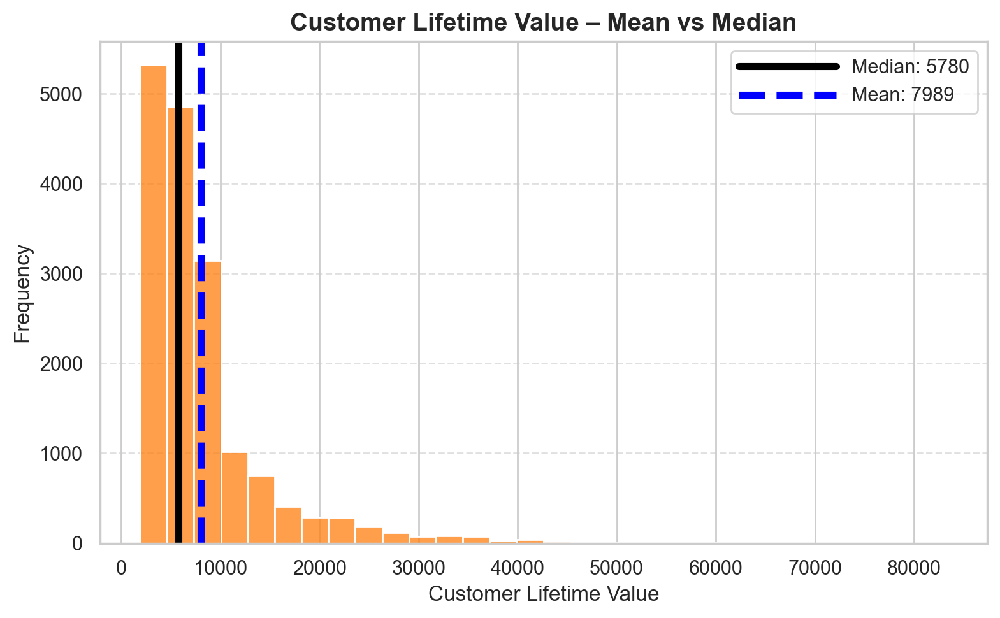

In [219]:
data = pd.to_numeric(customer['Customer Lifetime Value'], errors='coerce').dropna()

clv_mean = data.mean()
clv_median = data.median()


fig, ax = plt.subplots(figsize=(8,5))

sns.histplot(data, bins=30, ax=ax, color='tab:orange')

ax.axvline(clv_median, color='black', linewidth=4, label=f'Median: {int(clv_median)}')
ax.axvline(clv_mean, color='blue', linestyle='dashed', linewidth=4, label=f'Mean: {int(clv_mean)}')

ax.legend(handlelength=5)
ax.set_title("Customer Lifetime Value – Mean vs Median", fontsize=14, weight='bold')
ax.set_xlabel("Customer Lifetime Value", fontsize=12)
ax.set_ylabel("Frequency", fontsize=12)

plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

- The distribution of Customer Lifetime Value (CLV) reveals a pronounced right-skew, where the mean (7,989) is notably higher than the median (5,780). This pattern indicates that a small subset of customers contributes disproportionately to total revenue, while most members generate moderate lifetime value. Consequently, the median serves as a more representative measure of central tendency for this variable.

In [220]:
# These are the ones with missing values in this feature, so we will just impute with 0 (which is the real value, since they have no flights)
ids_customer = set(customer['Loyalty#'])
ids_flights = set(flights['Loyalty#'])

no_flights = ids_customer - ids_flights
print(len(no_flights), "customers with no flight records")

20 customers with no flight records


In [221]:
# Impute missing CLV values with the median (robust to right-skew)
# customer['Customer Lifetime Value'].fillna(customer['Customer Lifetime Value'].median(), inplace=True)

# Initially, we imputed the median in the CLV feauture. However, by analysing the flights dataset, there are 20 people that don't have any flights yet. It makes sense to assume that those 20 IDs not present in the flights dataset are the same as these 20 who have no CLV.
# So, we will fill these values with 0.
customer['Customer Lifetime Value'].fillna(0, inplace=True)

### 5.1.4 Strange Values

In [223]:
# Income: We will compare the results between 2 approaches (KNN Imputer and Median (by LoyaltyStatus))

# 0) Base copy
df_compare = customer.copy()

# Replace zeros with NaN (since they represent missing income)
df_compare['Income'] = df_compare['Income'].replace(0, np.nan)

# 1) KNN IMPUTATION (uses the metric features we defined previously)
imputer = KNNImputer(n_neighbors=5, weights='uniform')
df_knn = df_compare.copy()
df_knn[metric_features_customer] = imputer.fit_transform(df_knn[metric_features_customer])

# 2) MEDIAN IMPUTATION (by LoyaltyStatus)
df_median = df_compare.copy()
df_median['Income'] = df_median.groupby('LoyaltyStatus')['Income'].transform(
    lambda x: x.fillna(x.median())
)

# 3) BUILD COMPARISON DATAFRAME
# Ensure original shows only true positives (>0); NaN otherwise
income_original = customer['Income'].where(customer['Income'] > 0, np.nan)

df_income_compare = pd.DataFrame({
    'Income_original': income_original,
    'Income_knn': df_knn['Income'],
    'Income_median': df_median['Income']
})

display(df_income_compare.describe())
df_income_compare.head()

,Income_original,Income_knn,Income_median
count,12500.000000,16757.000000,16757.000000
mean,50548.670080,49803.844531,49891.474578
std,24257.224274,22160.195396,21000.484025
min,10037.000000,10037.000000,10037.000000
25%,28513.000000,30855.000000,34498.000000
50%,48259.000000,48237.000000,48197.000000
75%,70258.000000,65247.000000,62370.000000
max,99981.000000,99981.000000,99981.000000


,Income_original,Income_knn,Income_median
434,28264.0,28264.0,28264.0
5546,NaN,40632.8,48995.5
7930,94303.0,94303.0,94303.0
8146,NaN,46336.2,48995.5
9683,14072.0,14072.0,14072.0


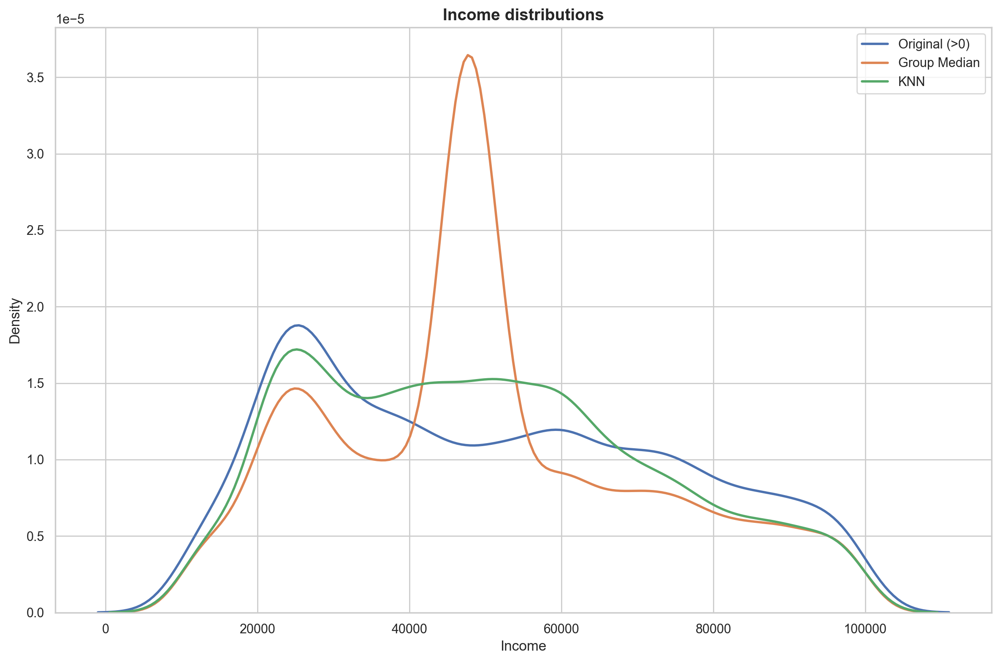

In [224]:
plt.figure(figsize=(12, 8))

sns.kdeplot(
    df_income_compare["Income_original"].dropna(),
    label="Original (>0)",
    lw=2
)

sns.kdeplot(
    df_income_compare["Income_median"],
    label="Group Median",
    lw=2
)

sns.kdeplot(
    df_income_compare["Income_knn"],
    label="KNN",
    lw=2
)

plt.title("Income distributions", fontsize=14, fontweight="bold")
plt.xlabel("Income")
plt.ylabel("Density")
plt.legend()
plt.tight_layout()
plt.show()

Between the two imputation strategies tested, the KNN approach was retained as it preserves both the variance structure of the original income distribution and a more meaningful correlation with customer value, avoiding the over-smoothing effect observed with median-based imputation.

In [225]:
customer['Income'] = df_knn['Income'].values
customer['Income'].describe()

count    16757.000000
mean     49803.844531
std      22160.195396
min      10037.000000
25%      30855.000000
50%      48237.000000
75%      65247.000000
max      99981.000000
Name: Income, dtype: float64

In [226]:
# CancelLationDate before EnrollmentDateOpening

# Identify inconsistent cancellation dates in the original CustomerDB
mask = (
    customer["CancellationDate"].notna()
    & customer["EnrollmentDateOpening"].notna()
    & (customer["CancellationDate"] < customer["EnrollmentDateOpening"])
)

# Replace invalid cancellation dates with NaN
customer.loc[mask, "CancellationDate"] = np.nan

print(f"{mask.sum()} records in CustomerDB updated (invalid cancellation dates replaced with NaN)")

199 records in CustomerDB updated (invalid cancellation dates replaced with NaN)


### 5.1.6 Removing Redundant Values

In [227]:
customer.drop(columns=['Country'], inplace=True)
customer.drop(columns=['Customer Name'], inplace=True)
customer.drop(columns=['First Name'], inplace=True)
customer.drop(columns=['Last Name'], inplace=True)
customer.drop(columns=['City'], inplace=True)
customer.drop(columns=['Postal code'], inplace=True)
customer.drop(columns=['Latitude'], inplace=True)
customer.drop(columns=['Longitude'], inplace=True)
customer.head()

,Loyalty#,Province or State,Gender,Education,Location Code,Income,Marital Status,LoyaltyStatus,EnrollmentDateOpening,CancellationDate,Customer Lifetime Value,EnrollmentType
434,123928,Quebec,male,Bachelor,Rural,28264.0,Divorced,Star,2021-12-30,NaT,4624.56,Standard
5546,857845,Newfoundland,male,College,Suburban,40632.8,Single,Nova,2021-12-30,NaT,3945.59,Standard
7930,948961,Ontario,male,Bachelor,Urban,94303.0,Married,Nova,2021-12-30,NaT,7908.45,Standard
8146,647393,Quebec,male,College,Rural,46336.2,Married,Nova,2021-12-30,NaT,8356.18,Standard
9683,170982,Quebec,male,High School or Below,Rural,14072.0,Divorced,Nova,2021-12-30,NaT,24127.50,Standard


## 5.2 FlightsDB

### 5.2.1 Correcting Data Types

In [228]:
flights.dtypes

Loyalty#                      int64
Year                          int64
Month                         int64
YearMonthDate                object
NumFlights                  float64
NumFlightsWithCompanions    float64
DistanceKM                  float64
PointsAccumulated           float64
PointsRedeemed              float64
DollarCostPointsRedeemed    float64
dtype: object

After reviewing variable types, NumFlights and NumFlightsWithCompanions were identified as float values even though they represent discrete flight counts. Both will be converted to integers to ensure logical consistency, rounding down any decimals to avoid overestimating flight activity.
Additionally, YearMonthDate is currently stored as an object and will be converted to a datetime format to enable proper time-based aggregation and trend analysis across flight records.

In [229]:
flights['YearMonthDate'] = pd.to_datetime(flights['YearMonthDate'], errors='coerce')

In [230]:
flights['NumFlights'] = np.floor(flights['NumFlights'].astype(int))
flights['NumFlightsWithCompanions'] = np.floor(flights['NumFlightsWithCompanions'].astype(int))

### 5.2.2 Removing Duplicates

In [231]:
flights.duplicated().sum()

np.int64(2903)

In [232]:
# Each line reprents a combination loyalty# + year + month
flights = flights.drop_duplicates(subset=['Loyalty#', 'Year', 'Month'])

### 5.2.3 Removing Redundant Values

In [233]:
flights.drop(columns=['DollarCostPointsRedeemed'], inplace=True)
flights.drop(columns=['DistanceKM'], inplace=True)
flights.drop(columns=['YearMonthDate'], inplace=True)

- The feature 'DollarCostPointsRedeemed' has an exact correlation (1) with 'PointsRedeemed' and 'DistanceKM' the exact same perfect correlation with 'PointsAccumulated', which means that one of each pair should be dropped, because these give the same information and are redundant. So, we chose to drop 'DollarCostPointsRedeemed' and 'DistanceKM' to keep the consistency with 'PointsAccumulated' and 'PointsRedeemed' - both are measured in points.

# 6. Feature Engineering

## 6.1 New Features

In [234]:
# Create a new column "IsActive" that states if the customer has an active membership
today = pd.Timestamp.today()
customer["IsActive"] = customer["CancellationDate"].map(
    lambda d: True if pd.isna(d) or d > today else False
)

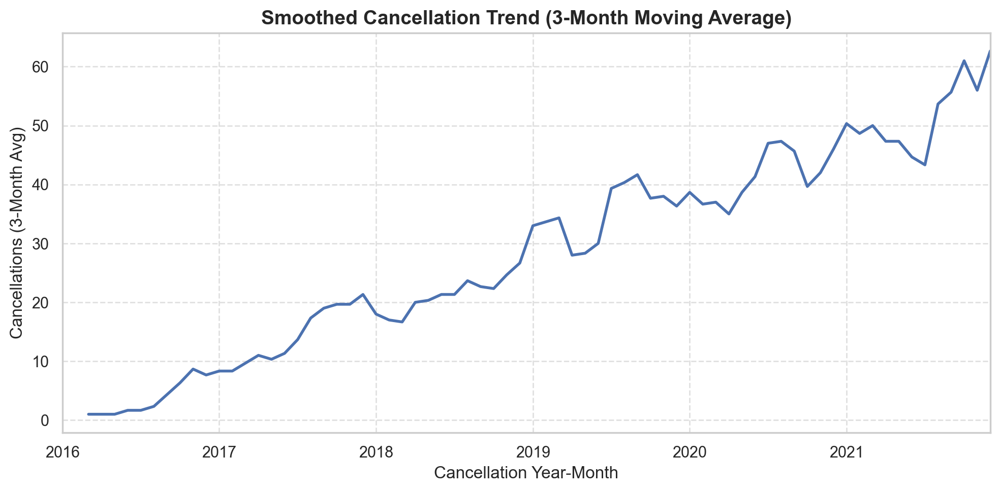

In [235]:
# Filter customers who have cancelled their membership
cancelled = customer[customer['CancellationDate'].notna()].copy()

# Keep only cancellations from 2016 onwards
cancelled = cancelled[cancelled['CancellationDate'] >= pd.Timestamp("2016-01-01")]

# Create the Year-Month period temporarily (without adding a column)
cancel_per_month = (
    cancelled['CancellationDate']
    .dt.to_period('M')
    .value_counts()
    .sort_index()
)

# Plot 3-month moving average of cancellations
plt.figure(figsize=(10,5))
cancel_per_month.rolling(3).mean().plot(lw=2)

plt.title('Smoothed Cancellation Trend (3-Month Moving Average)', fontsize=14, weight='bold')
plt.xlabel('Cancellation Year-Month', fontsize=12)
plt.ylabel('Cancellations (3-Month Avg)', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()


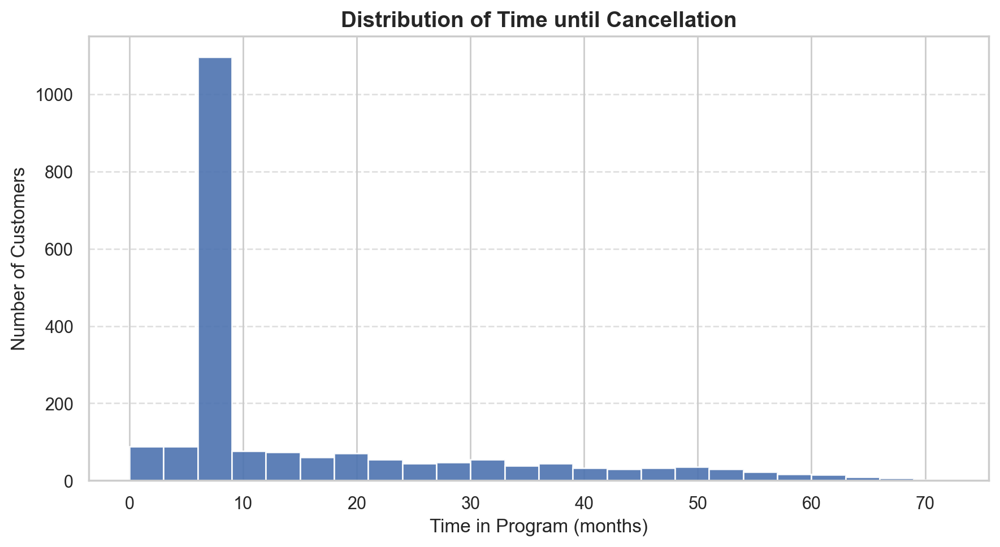

In [236]:
# Calculate the number of months between enrollment and cancellation
cancelled['MonthsToCancel'] = (
    (cancelled['CancellationDate'] - cancelled['EnrollmentDateOpening']).dt.days / 30
).round(0)

# Plot the histogram of time until cancellation
plt.figure(figsize=(9,5))
plt.hist(cancelled['MonthsToCancel'], 
         bins=range(0, int(cancelled['MonthsToCancel'].max()) + 3, 3),
         edgecolor='white', alpha=0.9)

plt.title('Distribution of Time until Cancellation', fontsize=14, weight='bold')
plt.xlabel('Time in Program (months)', fontsize=12)
plt.ylabel('Number of Customers', fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

The analysis of cancellation behavior highlights two complementary insights. The temporal trend shows that cancellations increased steadily until a sharp spike around 2019, after which the pattern stabilized but remained above previous levels. This evolution suggests that specific structural or policy changes may have temporarily intensified churn, possibly due to adjustments in program benefits, communication gaps, or membership conditions. The histogram of time until cancellation reinforces this interpretation, showing that most customers terminate their membership within the first ten months - a clear indication of weak early engagement and limited perceived value during the onboarding stage.

From a business perspective, these findings are crucial because they pinpoint when and why loyalty deteriorates. Early cancellations reduce the return on investment from customer acquisition and diminish overall lifetime value, meaning that resources are being spent to attract members who disengage before becoming profitable. Improving onboarding, personalizing early incentives, and monitoring customer reactions to policy changes can significantly increase retention rates and program profitability. Ultimately, addressing this early-stage churn strengthens customer loyalty, stabilizes revenue streams, and enhances the long-term effectiveness of the loyalty program.

In [237]:
customer['Tenure'] = (
    (customer['CancellationDate'].fillna(pd.Timestamp('2021-12-31'))
     - customer['EnrollmentDateOpening'])
    .dt.days / 365
).round(1)


The Tenure variable provides a temporal dimension to customer analysis by quantifying how long each individual has remained engaged with AIAI’s loyalty program. This duration offers valuable insight into the customer lifecycle, helping distinguish between newly enrolled members and long-term loyal clients. By examining tenure distributions, analysts can uncover patterns such as early attrition, sustained loyalty, or reactivation trends, which can reveal hidden behavioral dynamics across different customer tiers and demographics.

From a business perspective, tenure is a powerful indicator of customer stability and retention effectiveness. Understanding how tenure correlates with spending, redemption behavior, and lifetime value allows AIAI to design targeted retention strategies, adjust loyalty incentives, and forecast revenue more accurately. In essence, this metric bridges operational data with strategic insight, enabling the airline to proactively manage customer relationships and strengthen long-term profitability.

## 6.2 New Features for merging 

This step was designed to consolidate the monthly flight records into customer-level aggregates that reflect engagement, loyalty behavior, and temporal patterns. The goal was to create a single, interpretable dataset summarizing each customer’s flight activity over the entire observation period. Aggregations such as total flights, companion flights, and total points (earned and redeemed) provide direct indicators of frequency, sociability, and value generation. The RedeemRatio captures reward utilization efficiency, with safeguards against division by zero to ensure data consistency. Monthly and yearly flight pivots (January–December, 2019–2021) were added to retain the temporal structure.

Merging all these components into a unified per-customer table simplifies the integration with the CustomerDB, ensuring that every loyalty member has a complete and comparable activity profile. Integer casting and zero-filling preserve semantic integrity, explicitly distinguishing inactivity from missing data. Overall, this process transforms a granular transactional dataset into a structured and feature-rich foundation suitable for exploratory analysis, feature engineering, and subsequent clustering - enabling meaningful differentiation between high-value, consistent, and seasonal travelers.

In [239]:
# --- Base aggregation per customer ---
flights_agg = flights.groupby('Loyalty#').agg(
    TotalFlights=('NumFlights', 'sum'),
    TotalFlightsWithCompanions=('NumFlightsWithCompanions', 'sum'),
    TotalPointsAccumulated=('PointsAccumulated', 'sum'),
    TotalPointsRedeemed=('PointsRedeemed', 'sum')
).reset_index()

# --- Redeem ratio: guard against division by zero ---
flights_agg['RedeemRatio'] = (
    flights_agg['TotalPointsRedeemed'] / flights_agg['TotalPointsAccumulated']
).replace([np.inf, -np.inf], np.nan)

# ======================================================================
# Monthly flight counts: one column per month (January ... December)
# ======================================================================

# Pivot to get flights by Month per customer
monthly = (flights
           .groupby(['Loyalty#', 'Month'])['NumFlights']
           .sum()
           .unstack(fill_value=0))

# Ensure we have 1..12 in correct order
month_order = list(range(1, 12 + 1))
for m in month_order:
    if m not in monthly.columns:
        monthly[m] = 0
monthly = monthly[month_order]

# Rename columns to friendly month names
month_map = {
    1: 'Flights_January', 2: 'Flights_February', 3: 'Flights_March',
    4: 'Flights_April', 5: 'Flights_May', 6: 'Flights_June',
    7: 'Flights_July', 8: 'Flights_August', 9: 'Flights_September',
    10: 'Flights_October', 11: 'Flights_November', 12: 'Flights_December'
}
monthly.columns = [month_map[m] for m in monthly.columns]
monthly = monthly.reset_index()

# Yearly flight counts: one column per requested year (2019, 2020, 2021)

# Pivot to get flights by Year per customer
yearly = (flights
          .groupby(['Loyalty#', 'Year'])['NumFlights']
          .sum()
          .unstack(fill_value=0))

# Ensure columns for 2019, 2020, 2021 exist (fill 0 if not present)
for y in [2019, 2020, 2021]:
    if y not in yearly.columns:
        yearly[y] = 0

yearly = yearly[[2019, 2020, 2021]].copy()
yearly.columns = ['Flights_2019', 'Flights_2020', 'Flights_2021']
yearly = yearly.reset_index()

# Merge everything into a single per-customer table

flights_agg = (flights_agg
               .merge(monthly, on='Loyalty#', how='left')
               .merge(yearly, on='Loyalty#', how='left'))

# Optional: enforce integer dtype for count columns
count_cols = [c for c in flights_agg.columns
              if c.startswith('Flights_')] + ['TotalFlights', 'TotalFlightsWithCompanions']
for c in count_cols:
    flights_agg[c] = flights_agg[c].fillna(0).astype(int)

# Final sanity check
print(flights_agg.shape)
flights_agg.head()

(16737, 21)


,Loyalty#,TotalFlights,TotalFlightsWithCompanions,TotalPointsAccumulated,TotalPointsRedeemed,RedeemRatio,Flights_January,Flights_February,Flights_March,Flights_April,Flights_May,Flights_June,Flights_July,Flights_August,Flights_September,Flights_October,Flights_November,Flights_December,Flights_2019,Flights_2020,Flights_2021
0,100018,225,45,53014.30,20562.8,0.387873,6,9,33,12,0,7,28,19,31,17,35,28,68,81,76
1,100102,245,55,33903.96,18760.6,0.553345,19,6,28,26,7,8,14,26,27,20,30,34,72,83,90
2,100140,211,51,43192.58,4896.0,0.113353,20,0,14,22,19,14,22,11,38,4,19,28,59,72,80
3,100214,108,17,36453.77,12908.6,0.354109,0,12,3,0,0,8,0,8,24,20,3,30,29,37,42
4,100272,181,50,42953.25,10891.4,0.253564,4,5,30,26,7,41,11,16,1,4,16,20,54,66,61


## 6.3 New Feature Summary

| Feature Name | Source | Description | Formula / Logic | Reason |
|---------------|---------|-------------|------------------|---------|
| **IsActive** | CustomerDB | Indicates whether the customer’s membership is still active. | `True` if \`CancellationDate\` is `NaN`; `False` otherwise. | To identify currently active members vs churned ones. |
| **Tenure** | CustomerDB | Duration (in years) since the customer joined the loyalty program until the cancellation date, or 31/12/2021 if still active. | `(CancellationDate.fillna(2021-12-31)−EnrollmentDateOpening).days/365` | To estimate customer loyalty length and maturity. |
| **TotalFlights** | FlightsDB (aggregated) | Total number of flights taken by the customer over the entire period. | `sum(NumFlights)` | To measure engagement and travel frequency. |
| **TotalFlightsWithCompanions** | FlightsDB (aggregated) | Total number of flights taken with companions. | `sum(NumFlightsWithCompanions)` | To identify social or family-oriented travelers. |
| **TotalPointsAccumulated** | FlightsDB (aggregated) | Total loyalty points earned by the customer. | `sum(PointsAccumulated)` | To measure customer earning behavior and activity level. |
| **TotalPointsRedeemed** | FlightsDB (aggregated) | Total loyalty points redeemed or spent by the customer. | `sum(PointsRedeemed)` | To evaluate how customers use their earned benefits. |
| **RedeemRatio** | FlightsDB (derived) | Efficiency of point redemption relative to points accumulated. | `TotalPointsRedeemed / TotalPointsAccumulated` (replace inf with NaN) | To measure loyalty engagement and reward utilization. |
| **Flights_January … Flights_December** | FlightsDB (pivot) | Total number of flights per month; each column represents a month (1–12). | `groupby(['Loyalty#','Month'])['NumFlights'].sum().unstack(fill_value=0)` | To detect seasonal or temporal travel patterns. |


# 7. Merge

In [240]:
flights['Loyalty#'].value_counts().describe()

count    16737.0
mean        36.0
std          0.0
min         36.0
25%         36.0
50%         36.0
75%         36.0
max         36.0
Name: count, dtype: float64

In [241]:
print(customer['Loyalty#'].dtype)
print(flights['Loyalty#'].dtype)

print(customer['Loyalty#'].nunique(), "Unique IDs in CustomerDB")
print(flights['Loyalty#'].nunique(), "Unique IDs in FlightsDB")


int64
int64
16757 Unique IDs in CustomerDB
16737 Unique IDs in FlightsDB


In [242]:
flights.info()

<class 'pandas.core.frame.DataFrame'>
Index: 602532 entries, 0 to 608435
Data columns (total 7 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Loyalty#                  602532 non-null  int64  
 1   Year                      602532 non-null  int64  
 2   Month                     602532 non-null  int64  
 3   NumFlights                602532 non-null  int64  
 4   NumFlightsWithCompanions  602532 non-null  int64  
 5   PointsAccumulated         602532 non-null  float64
 6   PointsRedeemed            602532 non-null  float64
dtypes: float64(2), int64(5)
memory usage: 36.8 MB


This means that:

- There are 20 customers registered in the loyalty program (CustomerDB) who have no flight activity records in FlightsDB. We assumed that these are the ones with 0 in Customer Lifetime Value - let's check.

- On the other hand, all IDs in FlightsDB exist in CustomerDB, meaning there are no flight records without a valid customer( which is good).

In [243]:
merged = customer.merge(flights_agg, on='Loyalty#', how='left')

print(f"Merged dataset shape: {merged.shape}")
merged.head()

Merged dataset shape: (16757, 34)


,Loyalty#,Province or State,Gender,Education,Location Code,Income,Marital Status,LoyaltyStatus,EnrollmentDateOpening,CancellationDate,Customer Lifetime Value,EnrollmentType,IsActive,Tenure,TotalFlights,TotalFlightsWithCompanions,TotalPointsAccumulated,TotalPointsRedeemed,RedeemRatio,Flights_January,Flights_February,Flights_March,Flights_April,Flights_May,Flights_June,Flights_July,Flights_August,Flights_September,Flights_October,Flights_November,Flights_December,Flights_2019,Flights_2020,Flights_2021
0,123928,Quebec,male,Bachelor,Rural,28264.0,Divorced,Star,2021-12-30,NaT,4624.56,Standard,True,0.0,0.0,0.0,0.00,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,857845,Newfoundland,male,College,Suburban,40632.8,Single,Nova,2021-12-30,NaT,3945.59,Standard,True,0.0,196.0,29.0,39169.57,0.0,0.0,15.0,9.0,21.0,3.0,5.0,38.0,3.0,18.0,22.0,15.0,3.0,44.0,49.0,59.0,88.0
2,948961,Ontario,male,Bachelor,Urban,94303.0,Married,Nova,2021-12-30,NaT,7908.45,Standard,True,0.0,0.0,0.0,0.00,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,647393,Quebec,male,College,Rural,46336.2,Married,Nova,2021-12-30,NaT,8356.18,Standard,True,0.0,0.0,0.0,0.00,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,170982,Quebec,male,High School or Below,Rural,14072.0,Divorced,Nova,2021-12-30,NaT,24127.50,Standard,True,0.0,0.0,0.0,0.00,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [244]:
added_cols = [c for c in flights_agg.columns if c != 'Loyalty#' and c in merged.columns]
nan_report = merged[added_cols].isna().sum().sort_values(ascending=False).head(10)
print(nan_report)

RedeemRatio          1518
TotalFlights           20
Flights_July           20
Flights_2020           20
Flights_2019           20
Flights_December       20
Flights_November       20
Flights_October        20
Flights_September      20
Flights_August         20
dtype: int64


During the merge operation between CustomerDB and FlightsDB, a set of 20 customers were identified in the loyalty database who had no corresponding flight activity records. These individuals appear in the customer dataset but are completely absent from the flight logs, resulting in missing values for all flight-related attributes. This finding emerged naturally from the left join process and reflects a genuine aspect of the underlying business data.

The value of 1518 is totally possible, once that when a customer has never accumulated points (TotalPointsAccumulated = 0), the denominator becomes zero, making the ratio undefined.

From an analytical perspective, this situation is not a data inconsistency, but a representation of customer inactivity within the observation period. These customers may correspond to newly enrolled members who have not yet taken a flight, or to dormant accounts that never engaged in flight activity after registration. Their absence in FlightsDB therefore captures an authentic behavioral state rather than a missing data problem.

Including these customers in the dataset is strategically valuable for a comprehensive segmentation approach. They represent the inactive segment of the loyalty program, whose understanding can inform activation campaigns, retention efforts, and early engagement strategies. Preserving them in the merged dataset ensures that the analysis reflects the full diversity of the customer base, aligning with the business objective of identifying both active and passive members in the loyalty ecosystem of Amazing International Airlines Inc.

In [246]:
clv_zero = merged[merged['Customer Lifetime Value'] == 0]

tf = clv_zero['TotalFlights'].fillna(0)

print(f"Customers with CLV = NaN: {len(clv_zero)}")
print(f"…of which have zero flights: {(tf == 0).sum()}")

if (tf == 0).all():
    print("All CLV=NaN customers have no recorded flights (TotalFlights == 0 or missing).")
else:
    print("Some CLV=NaN customers do have flights — investigate inconsistencies.")


Customers with CLV = NaN: 20
…of which have zero flights: 20
All CLV=NaN customers have no recorded flights (TotalFlights == 0 or missing).


The results confirm that the twenty customers with CLV = 0 correspond exactly to those without any recorded flight activity in the FlightsDB. This outcome is expected, since the missing CLV values were previously imputed as zero for customers who never accumulated or redeemed points. These entries represent inactive profiles that exist in the customer registry but have not generated any transactional data.

## 7.1 Data Types

In [247]:
merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16757 entries, 0 to 16756
Data columns (total 34 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   Loyalty#                    16757 non-null  int64         
 1   Province or State           16757 non-null  object        
 2   Gender                      16757 non-null  category      
 3   Education                   16757 non-null  category      
 4   Location Code               16757 non-null  object        
 5   Income                      16757 non-null  float64       
 6   Marital Status              16757 non-null  category      
 7   LoyaltyStatus               16757 non-null  category      
 8   EnrollmentDateOpening       16757 non-null  datetime64[ns]
 9   CancellationDate            2068 non-null   datetime64[ns]
 10  Customer Lifetime Value     16757 non-null  float64       
 11  EnrollmentType              16757 non-null  category  

As the flights columns should not be float, these will be converted to int by using the floor operation, so the results aren't biased.

In [249]:
int_columns = [
    'TotalFlights', 'TotalFlightsWithCompanions',
    'Flights_January', 'Flights_February', 'Flights_March', 'Flights_April',
    'Flights_May', 'Flights_June', 'Flights_July', 'Flights_August',
    'Flights_September', 'Flights_October', 'Flights_November', 'Flights_December',
    'Flights_2019', 'Flights_2020', 'Flights_2021'
]

for col in int_columns:
    if col in merged.columns:
        merged[col] = merged[col].fillna(0).astype(int)

merged[int_columns].dtypes

TotalFlights                  int64
TotalFlightsWithCompanions    int64
Flights_January               int64
Flights_February              int64
Flights_March                 int64
Flights_April                 int64
Flights_May                   int64
Flights_June                  int64
Flights_July                  int64
Flights_August                int64
Flights_September             int64
Flights_October               int64
Flights_November              int64
Flights_December              int64
Flights_2019                  int64
Flights_2020                  int64
Flights_2021                  int64
dtype: object

## 7.2 Strange Values

Some customers show more points redeemed than accumulated, which is logically impossible. At first, when the monthly records were checked, it was assumed that it was normal to have some months where customers spend more points than they earned, but as a whole, it is not possible to spend more than they earned.
First, we identify and display these inconsistent records; then, we correct them by capping TotalPointsRedeemed to match TotalPointsAccumulated. This ensures RedeemRatio ≤ 1 while keeping all other information intact.

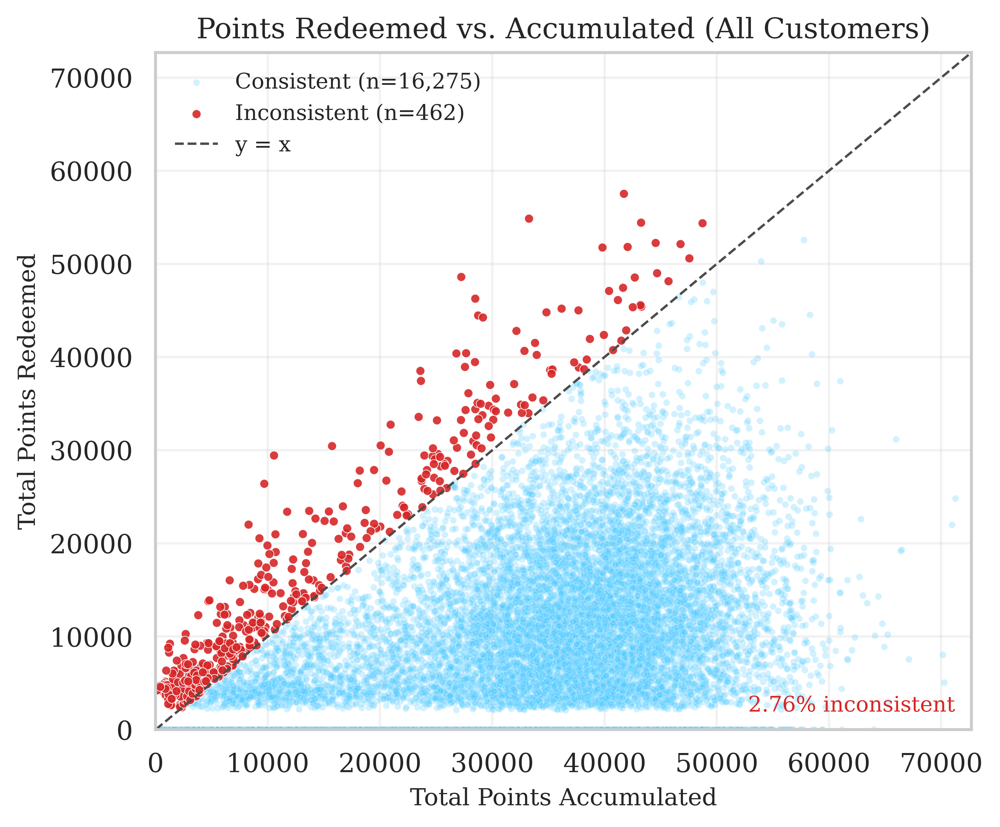

In [250]:
data = merged[["TotalPointsAccumulated", "TotalPointsRedeemed"]].dropna().copy()
data["is_inconsistent"] = data["TotalPointsRedeemed"] > data["TotalPointsAccumulated"]

n_bad = int(data["is_inconsistent"].sum())
n_all = int(len(data))

plt.rcParams.update({
    "font.family": "serif",
    "axes.labelsize": 10,
    "axes.titlesize": 12,
    "legend.fontsize": 9,
    "figure.dpi": 300
})

fig, ax = plt.subplots(figsize=(6, 5))

sns.scatterplot(
    data=data[~data["is_inconsistent"]],
    x="TotalPointsAccumulated",
    y="TotalPointsRedeemed",
    s=8,
    alpha=0.25,
    color="#4CCAFF",
    label=f"Consistent (n={n_all - n_bad:,})",
    ax=ax
)

sns.scatterplot(
    data=data[data["is_inconsistent"]],
    x="TotalPointsAccumulated",
    y="TotalPointsRedeemed",
    s=14,
    alpha=0.9,
    color="#D62728",
    edgecolor="white",
    linewidth=0.3,
    label=f"Inconsistent (n={n_bad:,})",
    ax=ax
)

lims_min = 0
lims_max = float(
    max(
        data["TotalPointsAccumulated"].max(),
        data["TotalPointsRedeemed"].max()
    )
) * 1.02

ax.plot(
    [lims_min, lims_max],
    [lims_min, lims_max],
    ls="--",
    lw=1,
    color="0.3",
    label="y = x"
)

ax.set_xlim(lims_min, lims_max)
ax.set_ylim(lims_min, lims_max)
ax.set_title("Points Redeemed vs. Accumulated (All Customers)")
ax.set_xlabel("Total Points Accumulated")
ax.set_ylabel("Total Points Redeemed")
ax.grid(True, alpha=0.25)
ax.legend(frameon=False, loc="upper left")

pct_bad = n_bad / n_all * 100
ax.text(
    0.98, 0.02,
    f"{pct_bad:.2f}% inconsistent",
    transform=ax.transAxes,
    ha="right",
    va="bottom",
    fontsize=9,
    color="#D62728"
)

plt.tight_layout()
plt.show()

In [251]:
mask = (
    merged["TotalPointsRedeemed"].notna()
    & merged["TotalPointsAccumulated"].notna()
    & (merged["TotalPointsRedeemed"] > merged["TotalPointsAccumulated"])
)

bad_points = merged.loc[
    mask, ["Loyalty#", "TotalPointsAccumulated", "TotalPointsRedeemed", "RedeemRatio"]
].copy()

print("Inconsistent records (redeemed > accumulated):", int(mask.sum()))
print(bad_points.head())

Inconsistent records (redeemed > accumulated): 462
     Loyalty#  TotalPointsAccumulated  TotalPointsRedeemed  RedeemRatio
97     781797                30304.89              35547.1     1.172982
209    211755                33248.89              54870.1     1.650284
265    439068                 2768.00               6122.0     2.211705
279    298098                  851.00               5159.0     6.062280
301    692936                 2802.00               3894.0     1.389722


Correcting the values:

In [252]:
mask = (
    merged["TotalPointsRedeemed"].notna()
    & merged["TotalPointsAccumulated"].notna()
    & (merged["TotalPointsRedeemed"] > merged["TotalPointsAccumulated"])
)

# Apply cap
merged.loc[mask, "TotalPointsRedeemed"] = merged.loc[mask, "TotalPointsAccumulated"]

# Recompute RedeemRatio safely
merged["RedeemRatio"] = (
    merged["TotalPointsRedeemed"] / merged["TotalPointsAccumulated"]
).replace([float("inf"), float("-inf")], pd.NA)

print(f"{int(mask.sum())} records corrected (redeemed capped at accumulated).")

462 records corrected (redeemed capped at accumulated).


In [253]:
merged.to_csv('data/Customer_Flights_merged.csv', index=False)

# 8. Data Visualization After the Merge

After preprocessing and aggregation, the unified dataset now integrates demographic, loyalty, and flight activity information at the customer level. The CustomerDB portion is primarily composed of categorical attributes such as Gender, Education, Marital Status, LoyaltyStatus, and EnrollmentType, while maintaining a few numerical fields - Income and Customer Lifetime Value as key economic indicators. In contrast, the FlightsDB-derived features contribute a wide range of continuous numerical variables, including TotalFlights, TotalPointsAccumulated, TotalPointsRedeemed, RedeemRatio, and detailed monthly and yearly flight counts.

This structure provides a balanced mix of categorical and numerical data, enabling a richer analysis of customer behavior. The merge may facilitate exploration of how demographic and program-related factors interact with flight activity and loyalty performance. Before progressing to segmentation, it is therefore appropriate to examine how these numerical features relate to one another, identifying potential correlations that may reveal underlying behavioral or value-driven patterns across the customer base.

## 8.1 Merged Dataset Profiling Report

In [254]:
# Using the merged dataframe
df = merged.copy()

# Convert relevant categorical columns (for better correlation detection)
categorical_cols = [
    'Gender', 'Education', 'Location Code',
    'Marital Status', 'LoyaltyStatus', 'EnrollmentType',
    'Province or State'
]
for c in categorical_cols:
    if c in df.columns:
        df[c] = df[c].astype('category')

# ID-like columns (excluded from correlations)
id_like = ['Loyalty#']

# Generate profile report
profile = ProfileReport(
    df,
    title="AIAI – Merged Dataset Profiling Report",
    explorative=True,
    minimal=True,
    correlations={
        "pearson": {"calculate": True},   # numeric ↔ numeric (linear)
        "spearman": {"calculate": True},  # numeric ↔ numeric (monotonic)
        "kendall": {"calculate": False},
        "phi_k": {"calculate": True},     # categorical ↔ numeric/categorical
        "cramers": {"calculate": True},   # categorical ↔ categorical
    },
    missing_diagrams={"heatmap": True, "dendrogram": True},
    samples={"head": 15, "tail": 15},
    duplicates={"head": 10}
)

profile.to_notebook_iframe()

# --- Export to HTML ---
output_path = "AIAI_Merged_Profile_Report.html"
profile.to_file(output_path)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 34/34 [00:00<00:00, 384.65it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## 8.2 Metric Variables' Correlation Matrix

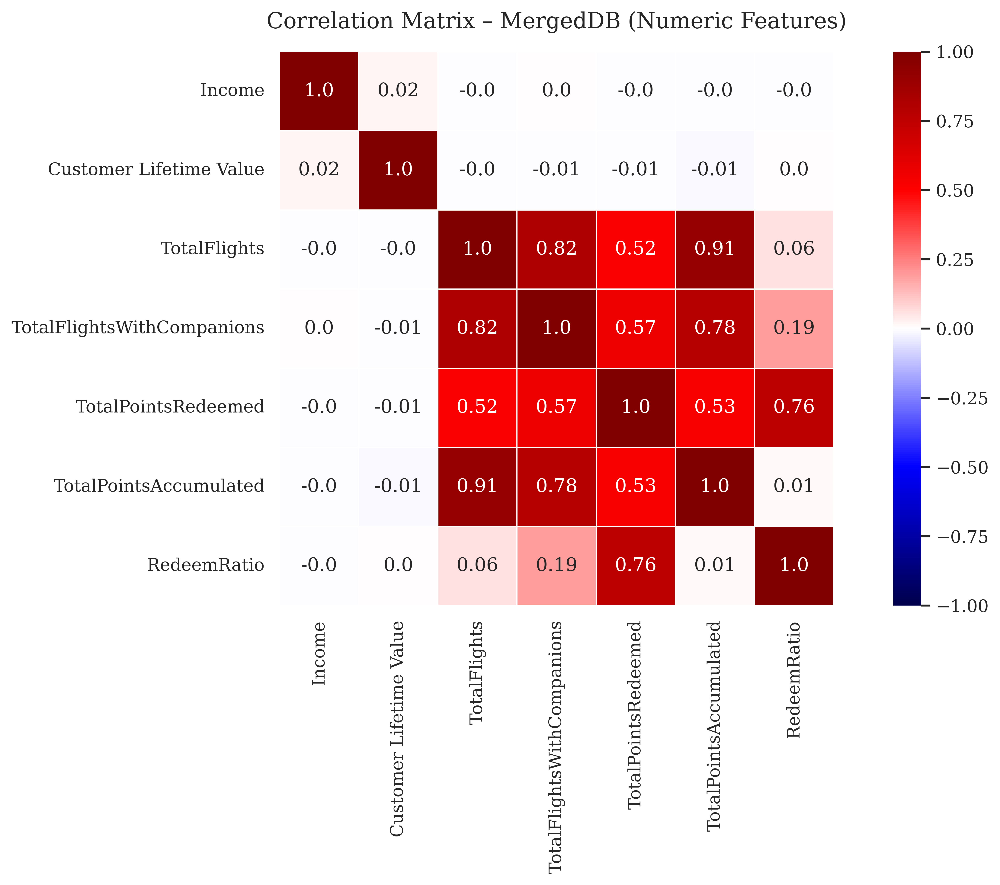

In [256]:
metric_features = ['Income', 'Customer Lifetime Value', 'TotalFlights', 
                     'TotalFlightsWithCompanions', 'TotalPointsRedeemed', 
                     'TotalPointsAccumulated', 'RedeemRatio']
aux = merged[metric_features]

corr = aux.corr(method='pearson')

annot = corr.round(2).astype(str)

plt.figure(figsize=(12, 8))

sns.heatmap(data=corr,
            annot=annot,
            fmt='s',
            vmin=-1, vmax=1,
            center=0,
            square=True,
            linewidths=.5,
            cmap='seismic')

plt.title('Correlation Matrix – MergedDB (Numeric Features)', fontsize=14, pad=15)
plt.tight_layout()

plt.show()

The correlation analysis reveals several strong relationships among flight-related variables:

- **TotalFlights** shows the highest correlations:
  - With TotalPointsAccumulated: **91%** (very strong positive relationship)
  - With TotalFlightsWithCompanions: **82%** (notably higher than the 81% observed in the pre-merge monthly data)
  - With TotalPointsRedeemed: **51%**

- **TotalFlightsWithCompanions** demonstrates strong associations with:
  - TotalPointsAccumulated: **78%**
  - TotalPointsRedeemed: **56%**

These findings suggest that aggregating to customer-level totals (rather than monthly granularity) has strengthened certain relationships, particularly between total flights and companion travel patterns.

With this information, we will drop 'TotalPointsAccumulated', being "represented" by 'TotalFlights'

## 8.3 Categorical / Numerical Variables' Correlation Matrix

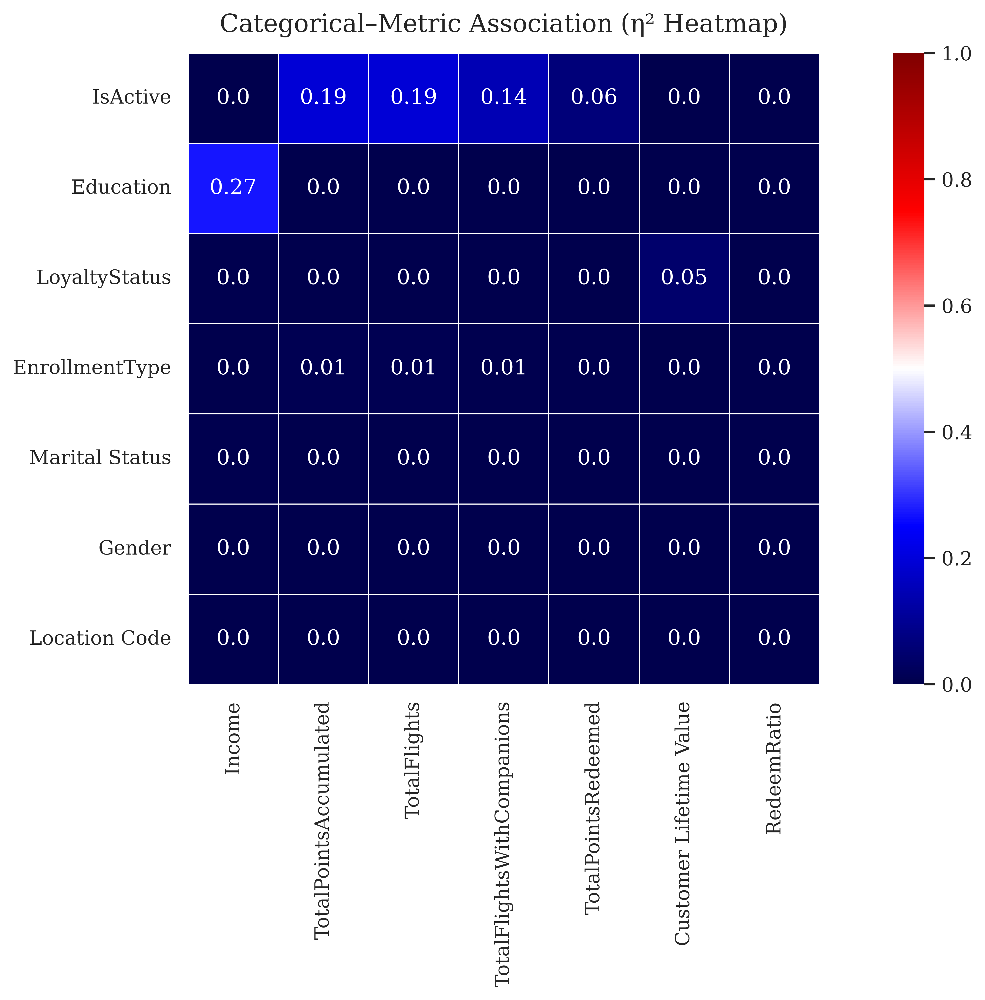

In [260]:

categorical_features = [
    'Gender', 'Education', 'Marital Status',
    'LoyaltyStatus', 'EnrollmentType', 'IsActive', 'Location Code'
]

for col in categorical_features:
    if col in merged.columns and merged[col].dtype == 'object':
        merged[col] = merged[col].astype('category')

def eta_squared_pair(df, category, numeric):
    sub = df[[category, numeric]].dropna()
    if sub.empty or sub[category].nunique() < 2 or sub[numeric].nunique() < 2:
        return np.nan
    groups = sub.groupby(category)[numeric]
    mean_total = sub[numeric].mean()
    ss_between = np.sum(groups.size() * (groups.mean() - mean_total) ** 2)
    ss_total = np.sum((sub[numeric] - mean_total) ** 2)
    return (ss_between / ss_total) if ss_total != 0 else np.nan

eta_matrix = pd.DataFrame(index=categorical_features, columns=metric_features, dtype=float)
for cat in categorical_features:
    for num in metric_features:
        if cat in merged.columns and num in merged.columns:
            eta_matrix.loc[cat, num] = eta_squared_pair(merged, cat, num)

row_order = eta_matrix.mean(axis=1, skipna=True).sort_values(ascending=False).index
col_order = eta_matrix.mean(axis=0, skipna=True).sort_values(ascending=False).index
eta_sorted = eta_matrix.loc[row_order, col_order]

plt.figure(figsize=(12, 8))
sns.heatmap(
    eta_sorted,
    annot=eta_sorted.round(2),
    fmt="",
    cmap="seismic",
    vmin=0, vmax=1,
    linewidths=0.4,
    linecolor='white',
    square=True,
    mask=eta_sorted.isna()
)
plt.title('Categorical–Metric Association (η² Heatmap)', fontsize=14, pad=12)
plt.tight_layout()
plt.show()

The η² heatmap highlights that Education presents a strong association with Income (η² = 0.27), confirming that higher education levels tend to correspond to higher income brackets within the customer base. IsActive also shows moderate relationships with several behavioral variables: TotalFlights (η² = 0.19), TotalFlightsWithCompanions (η² = 0.19), and TotalPointsRedeemed (η² = 0.14), indicating that active members display consistently higher engagement and reward redemption patterns. Additionally, EnrollmentType demonstrates a moderate association with Tenure (η² = 0.07), suggesting that the method of joining the program may influence customer retention duration. Overall, these associations confirm that both educational background and activity status are key differentiators driving customer value and program involvement.

## 8.4 Categorical / Numerical Variables' Bivariate Analysis

After the plot shown on 6.1, the idea is now to see what are the distribution of time on the loyalty program for the customers who have Customer Lifetime Value = 0. This is to understand if these are new joiners, or simply unactive customers.

Zero CLV customers: 20


count    20.000000
mean     44.105000
std      22.622985
min       9.300000
25%      23.350000
50%      46.100000
75%      59.200000
max      84.300000
Name: EnrollmentDateOpening, dtype: float64

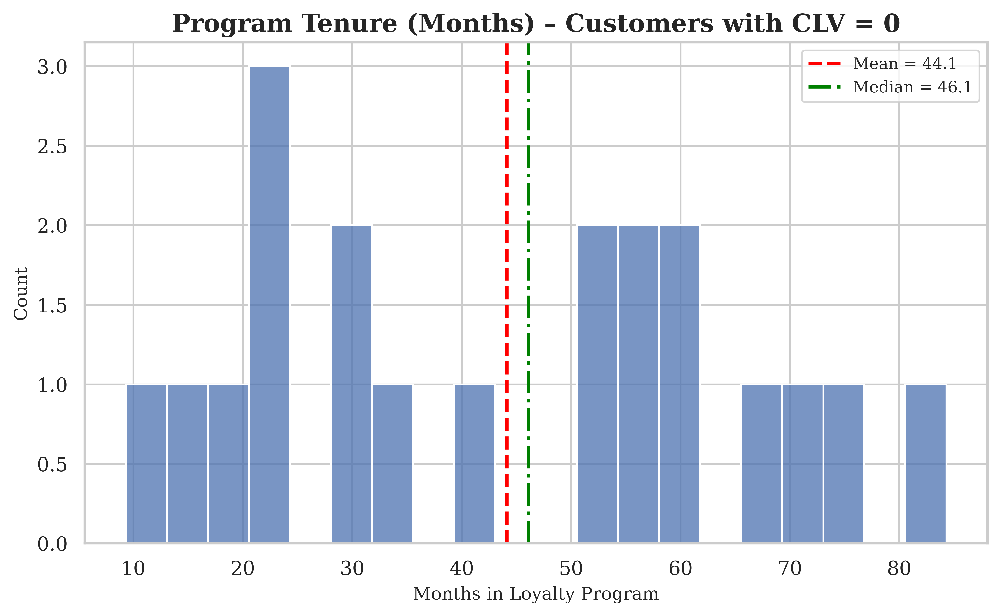

In [262]:
today = pd.Timestamp("2021-12-31") 

zero_clv = merged.loc[merged["Customer Lifetime Value"] == 0].copy()

tenure_months = ((today - zero_clv["EnrollmentDateOpening"]) / pd.Timedelta(days=30)).round(1)

print("Zero CLV customers:", len(zero_clv))
display(tenure_months.describe())

plt.figure(figsize=(8, 5))
sns.histplot(
    tenure_months,
    bins=20,
    kde=False
)

mean_val = tenure_months.mean()
median_val = tenure_months.median()

plt.axvline(mean_val, color="red", linestyle="--", linewidth=2, label=f"Mean = {mean_val:.1f}")
plt.axvline(median_val, color="green", linestyle="-.", linewidth=2, label=f"Median = {median_val:.1f}")

plt.title("Program Tenure (Months) – Customers with CLV = 0", fontsize=14, fontweight="bold")
plt.xlabel("Months in Loyalty Program")
plt.ylabel("Count")
plt.legend()
plt.tight_layout()
plt.show()

The tenure distribution of customers with CLV = 0 is notably dispersed, ranging from less than 10 to over 80 months, with an average around 44 months. This indicates that zero-value members are not recent joiners but rather long-standing participants who have failed to generate measurable value. The absence of concentration at early tenure stages suggests structural inactivity or disengagement rather than recency-driven low value.

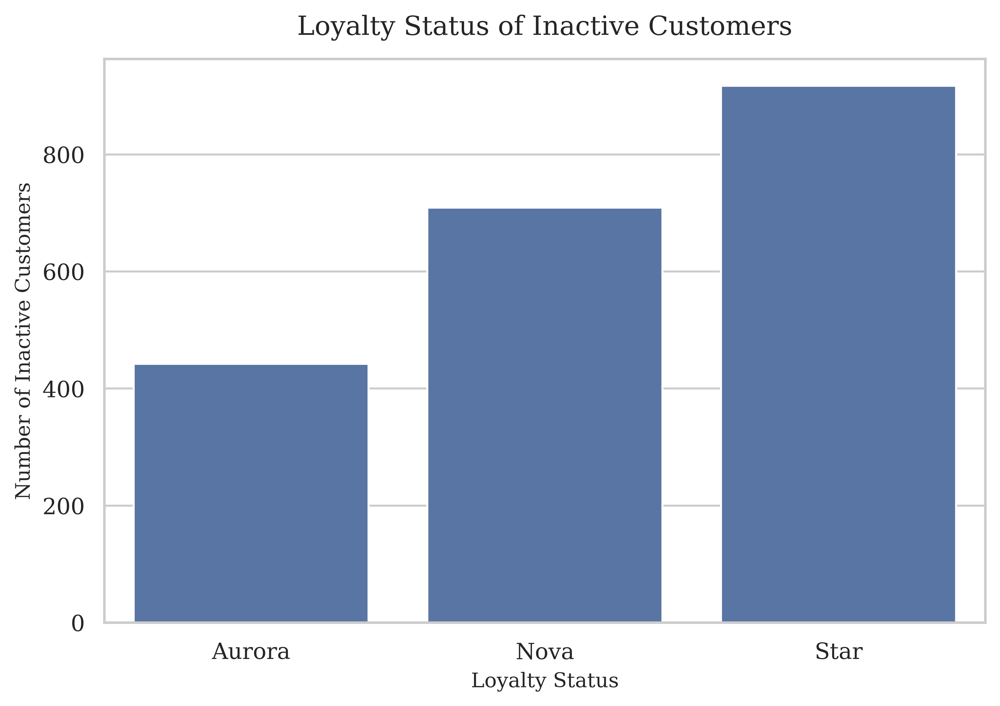

In [264]:
plt.figure(figsize=(7, 5))
sns.countplot(
    data=merged.loc[merged['IsActive'] == 0],
    x='LoyaltyStatus',
    order=['Aurora', 'Nova', 'Star'],
)
plt.title('Loyalty Status of Inactive Customers', fontsize=13, pad=12)
plt.xlabel('Loyalty Status')
plt.ylabel('Number of Inactive Customers')
plt.tight_layout()
plt.show()


The distribution of inactive customers reveals a notable concentration among higher-tier members, particularly within the Star and Nova levels, while Aurora (the entry tier) accounts for the smallest share of inactivity. This outcome is counterintuitive, as one would typically expect disengagement to be stronger among newly enrolled or low-status customers.

A plausible interpretation is that high-status members may have accumulated substantial benefits or point balances and temporarily paused their activity, or that travel frequency shifts after loyalty maturation led to inactivity despite past engagement. In practical terms, this pattern suggests that AIAI’s churn risk extends into its premium customer base, signaling the need for retention initiatives aimed specifically at maintaining engagement among long-term, high-value members.

## 8.5 Univariate Distributions by Categorical Feature

'Province or State' was not used in this graphic due to it's high cardinality.

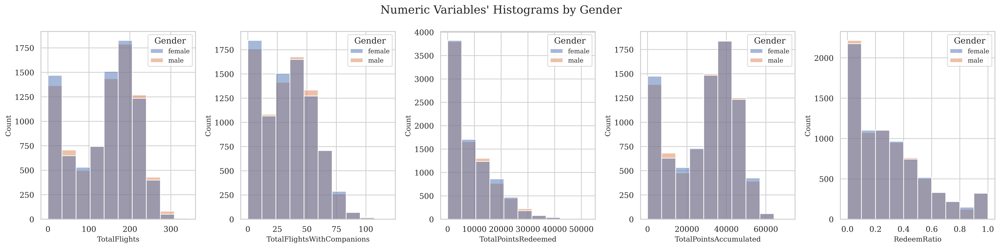

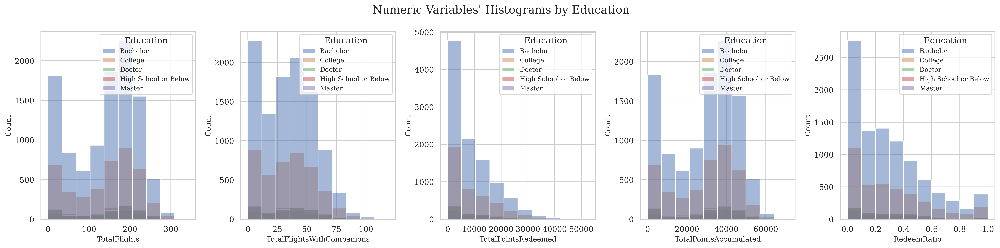

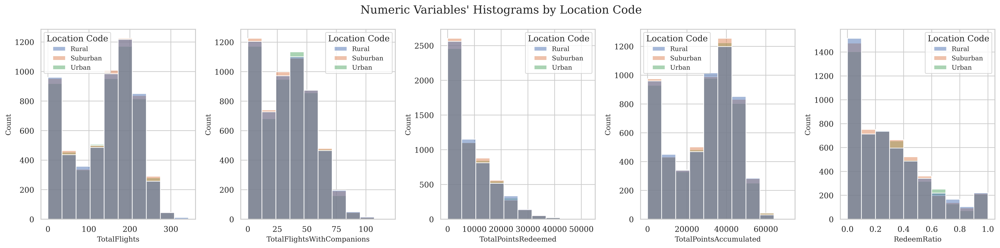

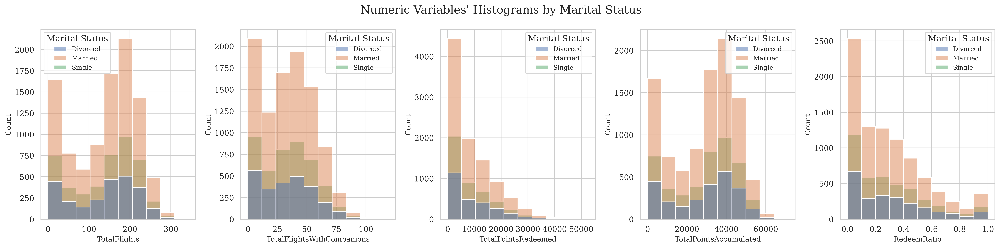

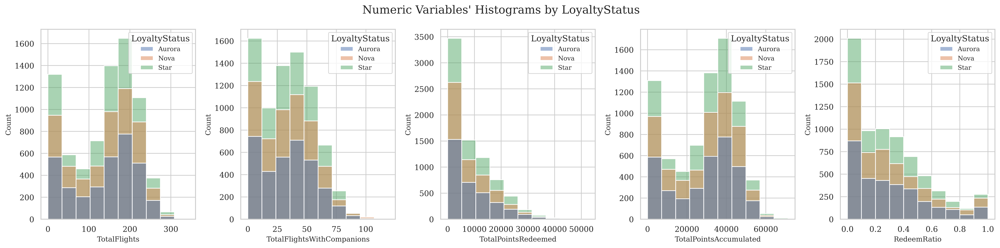

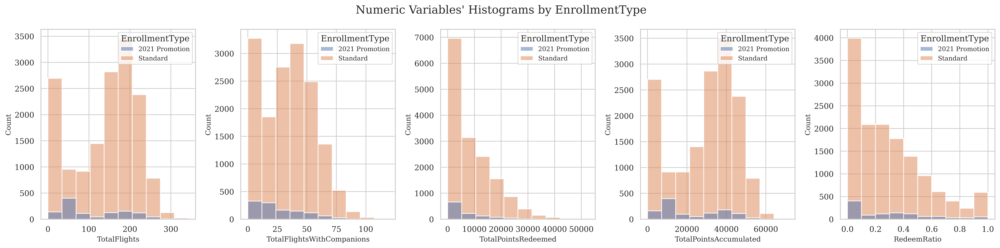

In [269]:
sp_rows = 2
sp_cols = 6

metric_features = ['TotalFlights', 
                     'TotalFlightsWithCompanions', 'TotalPointsRedeemed', 
                     'TotalPointsAccumulated', 'RedeemRatio']
categorical_features = ['Gender', 'Education', 'Location Code', 
                       'Marital Status', 'LoyaltyStatus', 'EnrollmentType']

n_features = len(metric_features)
sp_rows = 1
sp_cols = n_features

for cat_feature in categorical_features:
    fig, axes = plt.subplots(sp_rows, sp_cols, figsize=(4*n_features, 5))
    
    for ax, feat in zip(axes.flatten(), metric_features): 
        sns.histplot(merged, x=feat, ax=ax, bins=10, hue=cat_feature)
    
    title = f"Numeric Variables' Histograms by {cat_feature}"
    plt.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()

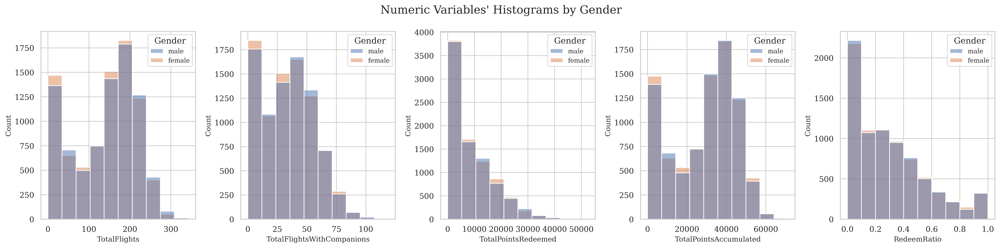

In [270]:

n_features = len(metric_features)
sp_rows = 1
sp_cols = n_features

fig, axes = plt.subplots(sp_rows, sp_cols, figsize=(4 * n_features, 5))

for ax, feat in zip(axes.flatten(), metric_features):
    sns.histplot(
        data=merged,
        x=feat,
        ax=ax,
        bins=10,
        hue='Gender',
        hue_order=['male', 'female']
    )

title = "Numeric Variables' Histograms by Gender"
plt.suptitle(title, fontsize=16)
plt.tight_layout()
plt.show()

The distributions show high overlap between genders across all numeric variables. This aligns with our earlier observation that gender was also well-balanced across categorical features, making gender a poor discriminator for customer segmentation or differentiation.

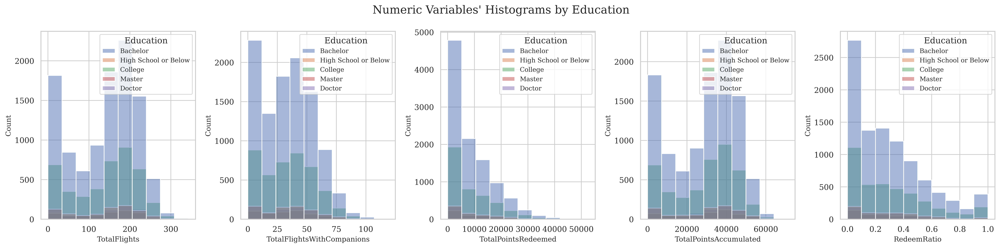

In [266]:

n_features = len(metric_features)
sp_rows = 1
sp_cols = n_features

fig, axes = plt.subplots(sp_rows, sp_cols, figsize=(4*n_features, 5))

for ax, feat in zip(axes.flatten(), metric_features): 
    sns.histplot(merged, x=feat, ax=ax, bins=10, hue='Education',
                hue_order=['Bachelor','High School or Below', 'College', 'Master', 'Doctor'])
    
title = "Numeric Variables' Histograms by Education"
plt.suptitle(title, fontsize=16)
plt.tight_layout()
plt.show()

These histograms display how flight-related numerical variables vary by education level. The distributions follow similar shapes across all groups, yet a mild positive gradient is visible - customers with higher education levels tend to accumulate more flights and loyalty points. The differences, however, are gradual rather than distinct, suggesting that education contributes modestly to behavioral variation rather than serving as a clear segmentation boundary.

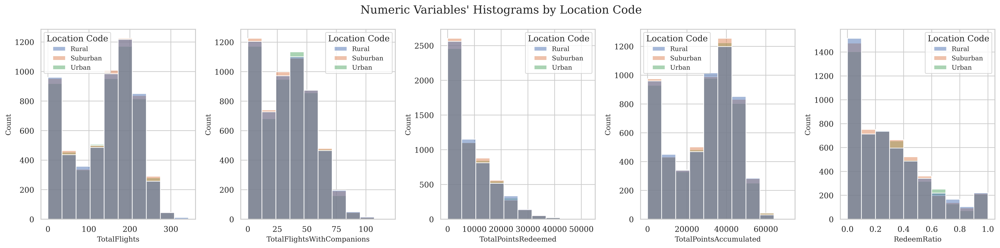

In [272]:
n_features = len(metric_features)
sp_rows = 1
sp_cols = n_features

fig, axes = plt.subplots(sp_rows, sp_cols, figsize=(4*n_features, 5))

for ax, feat in zip(axes.flatten(), metric_features): 
    sns.histplot(merged, x=feat, ax=ax, bins=10, hue='Location Code',
                hue_order=['Rural', 'Suburban', 'Urban'])
    
title = "Numeric Variables' Histograms by Location Code"
plt.suptitle(title, fontsize=16)
plt.tight_layout()
plt.show()

The differences are subtle, implying that geographic location contributes some behavioral variance but does not strongly segment customer activity on its own.

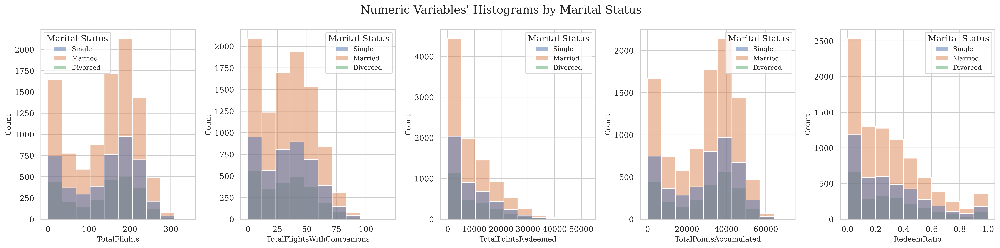

In [271]:
n_features = len(metric_features)
sp_rows = 1
sp_cols = n_features

fig, axes = plt.subplots(sp_rows, sp_cols, figsize=(4*n_features, 5))

for ax, feat in zip(axes.flatten(), metric_features): 
    sns.histplot(merged, x=feat, ax=ax, bins=10, hue='Marital Status',
                hue_order=['Single', 'Married', 'Divorced'])
     
title = "Numeric Variables' Histograms by Marital Status"
plt.suptitle(title, fontsize=16)
plt.tight_layout()
plt.show()

Married customers show slightly higher flight frequency and points accumulation, indicating somewhat greater travel engagement than single or divorced individuals.

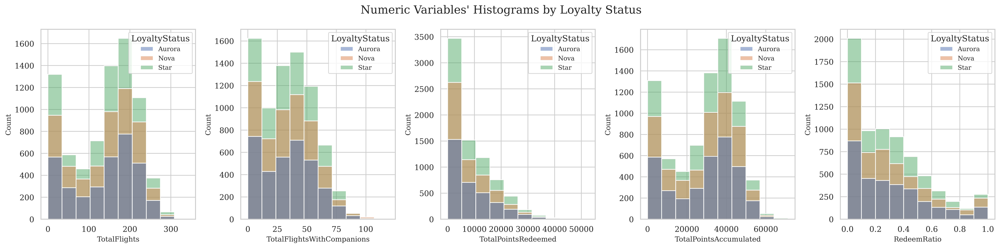

In [273]:

n_features = len(metric_features)
sp_rows = 1
sp_cols = n_features

fig, axes = plt.subplots(sp_rows, sp_cols, figsize=(4*n_features, 5))

for ax, feat in zip(axes.flatten(), metric_features): 
    sns.histplot(merged, x=feat, ax=ax, bins=10, hue='LoyaltyStatus')
    
title = "Numeric Variables' Histograms by Loyalty Status"
plt.suptitle(title, fontsize=16)
plt.tight_layout()
plt.show()

As expected, higher loyalty tiers (particularly Star members) exhibit greater flight and points activity, while other distributions overlap substantially, offering no additional differentiation beyond tier level.

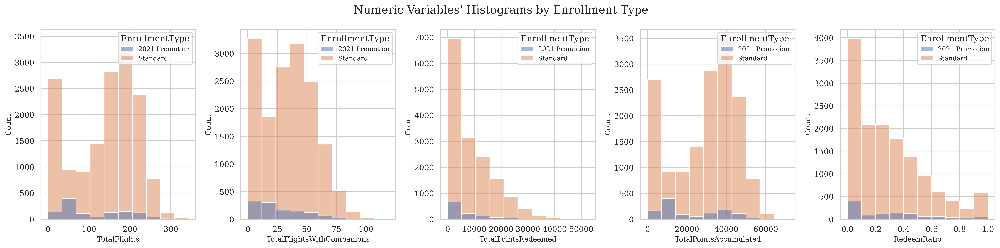

In [274]:
n_features = len(metric_features)
sp_rows = 1
sp_cols = n_features

fig, axes = plt.subplots(sp_rows, sp_cols, figsize=(4*n_features, 5))

for ax, feat in zip(axes.flatten(), metric_features): 
    sns.histplot(merged, x=feat, ax=ax, bins=10, hue='EnrollmentType')
    
title = "Numeric Variables' Histograms by Enrollment Type"
plt.suptitle(title, fontsize=16)
plt.tight_layout()
plt.show()

Distributions for Enrollment Type show that Standard members dominate across all activity metrics, while the 2021 Promotion group remains a small, low-activity subset with no distinctive behavioral pattern.

In [275]:
fig, axes = plt.subplots(2, 2, figsize=(15, 10))

for ax, num_feat in zip(axes.flatten(), metric_features):
    sns.boxplot(data=merged, x='EnrollmentType', y=num_feat, ax=ax)
    ax.set_title(f'{num_feat} by Enrollment Type')
    ax.tick_params(axis='x', rotation=45)

plt.suptitle('Boxplots by Enrollment Type', fontsize=16, y=1.00)
plt.tight_layout()
plt.show()

Boxplots confirm that Standard enrollments consistently exhibit higher medians and wider ranges across all flight and points metrics, while the 2021 Promotion group remains smaller and less active, showing no distinctive behavioral deviation.

## 8.6 Multivariate Analysis

### 8.6.1 Evolution of the number of Flights over the years

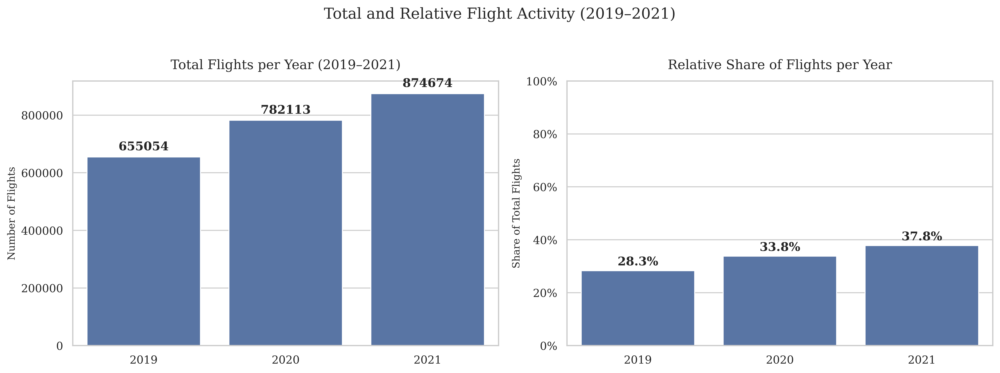

In [276]:
cols = ['Flights_2019', 'Flights_2020', 'Flights_2021']
df = merged[cols].copy()

totals = df.sum().reset_index()
totals.columns = ['Year', 'TotalFlights']
totals['Year'] = totals['Year'].str.replace('Flights_', '')

total_sum = totals['TotalFlights'].sum()
totals['Share'] = totals['TotalFlights'] / total_sum

fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.barplot(
    data=totals,
    x='Year', y='TotalFlights',
    ax=axes[0]
)
axes[0].set_title('Total Flights per Year (2019–2021)', fontsize=13, pad=12)
axes[0].set_ylabel('Number of Flights')
axes[0].set_xlabel('')
for i, v in enumerate(totals['TotalFlights']):
    axes[0].text(i, v + (0.01 * total_sum), f'{int(v)}', ha='center', fontweight='bold')

sns.barplot(
    data=totals,
    x='Year', y='Share',
    ax=axes[1]
)
axes[1].set_title('Relative Share of Flights per Year', fontsize=13, pad=12)
axes[1].set_ylabel('Share of Total Flights')
axes[1].set_xlabel('')
axes[1].set_ylim(0, 1)
axes[1].yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: f'{y*100:.0f}%'))

for i, v in enumerate(totals['Share']):
    axes[1].text(i, v + 0.02, f'{v*100:.1f}%', ha='center', fontweight='bold')

plt.suptitle('Total and Relative Flight Activity (2019–2021)', fontsize=15, y=1.03)
plt.tight_layout()
plt.show()


The figure shows the evolution of flight activity between 2019 and 2021, combining total and relative perspectives. The left panel indicates a steady increase in the overall number of flights, from approximately 655 k in 2019 to 782 k in 2020, and 874 k in 2021. Despite the onset of the pandemic, the rise in 2020 suggests that its operational impact was partially absorbed, likely due to strong performance in the early months or the persistence of frequent flyers sustaining travel patterns.

The right panel reinforces this progression, with annual shares shifting from 28.3 % to 33.8 % and 37.8 % respectively. This gradual redistribution highlights a continued expansion of flight activity and a recovery trend sustained through 2021. The pattern supports prior evidence of resilience among loyal customers, signaling a solid post-pandemic normalization of demand within the airline’s core segments.

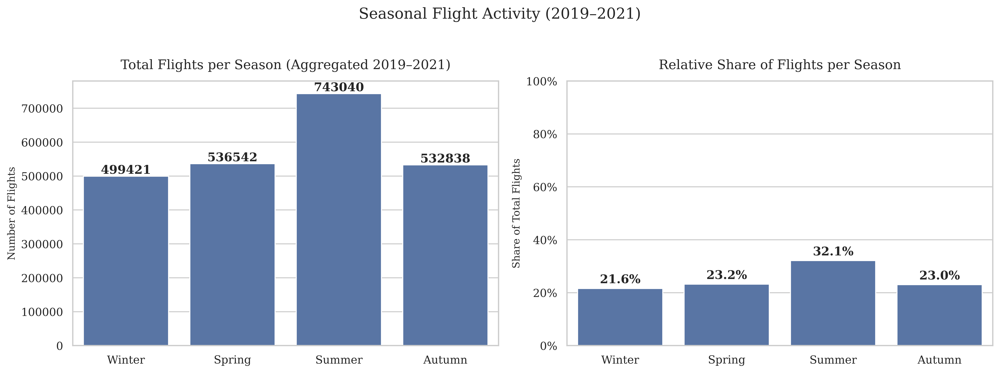

In [277]:
seasons = {
    'Winter': ['Flights_January', 'Flights_February', 'Flights_December'],
    'Spring': ['Flights_March', 'Flights_April', 'Flights_May'],
    'Summer': ['Flights_June', 'Flights_July', 'Flights_August'],
    'Autumn': ['Flights_September', 'Flights_October', 'Flights_November'],
}
season_order = ['Winter', 'Spring', 'Summer', 'Autumn']

season_totals = []
for season, month_cols in seasons.items():
    total = merged[month_cols].sum().sum()
    season_totals.append((season, total))

season_df = pd.DataFrame(season_totals, columns=['Season', 'TotalFlights'])
season_df['Share'] = season_df['TotalFlights'] / season_df['TotalFlights'].sum()
season_df = season_df.set_index('Season').loc[season_order].reset_index()

fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.barplot(
    data=season_df,
    x='Season', y='TotalFlights',
    ax=axes[0]
)
axes[0].set_title('Total Flights per Season (Aggregated 2019–2021)', fontsize=13, pad=12)
axes[0].set_ylabel('Number of Flights')
axes[0].set_xlabel('')
y_offset = 0.01 * season_df['TotalFlights'].max()
for i, v in enumerate(season_df['TotalFlights']):
    axes[0].text(i, v + y_offset, f'{int(v)}', ha='center', fontweight='bold')

sns.barplot(
    data=season_df,
    x='Season', y='Share',
    ax=axes[1]
)
axes[1].set_title('Relative Share of Flights per Season', fontsize=13, pad=12)
axes[1].set_ylabel('Share of Total Flights')
axes[1].set_xlabel('')
axes[1].set_ylim(0, 1)
axes[1].yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: f'{y*100:.0f}%'))
for i, v in enumerate(season_df['Share']):
    axes[1].text(i, v + 0.02, f'{v*100:.1f}%', ha='center', fontweight='bold')

plt.suptitle('Seasonal Flight Activity (2019–2021)', fontsize=15, y=1.03)
plt.tight_layout()
plt.show()

Seasonal flight distribution exhibits a clear and expected seasonal effect. Summer dominates the activity profile, concentrating roughly 32% of all flights across 2019–2021, significantly above the remaining seasons. This peak likely corresponds to the typical high-demand travel period linked to vacation behavior and favorable weather conditions.

In contrast, Winter records the lowest activity share (≈21.6%), consistent with lower leisure travel and potential weather-related constraints. Spring and Autumn maintain relatively balanced volumes (≈23%), suggesting these periods are transitional but still relevant for business and moderate leisure travel. Overall, the pattern confirms the seasonal elasticity of customer behavior, with implications for loyalty campaigns and resource planning—marketing efforts could intensify pre-summer to capture the surge in flight demand.

### 8.6.2 Evolution of the number of Flights over the years by Categorial Features

In [279]:
group_vars = [
    'Gender', 'Education', 'Location Code',
    'Marital Status', 'LoyaltyStatus',
    'EnrollmentType', 'Province or State'
]

year_cols = ['Flights_2019', 'Flights_2020', 'Flights_2021']

df = merged[group_vars + year_cols].copy()

df_m = df.melt(
    id_vars=group_vars,
    value_vars=year_cols,
    var_name='Year',
    value_name='Flights'
)
df_m['Year'] = df_m['Year'].str.replace('Flights_', '')

def plot_relative_grid(vars_list=group_vars, top_k=5, ncols=3, height=4, width=5):
    n = len(vars_list)
    nrows = math.ceil(n / ncols)
    fig, axes = plt.subplots(nrows, ncols, figsize=(width*ncols, height*nrows))
    axes = axes.flatten() if n > 1 else [axes]

    for ax_idx, var in enumerate(vars_list):
        ax = axes[ax_idx]

        sub = (
            df_m.groupby([var, 'Year'], as_index=False)
                .agg({'Flights': 'sum'})
        )

        if top_k is not None:
            order = (
                sub.groupby(var, as_index=False)['Flights']
                   .sum()
                   .sort_values('Flights', ascending=False)[var]
                   .head(top_k)
                   .tolist()
            )
            sub = sub[sub[var].isin(order)]
        else:
            order = (
                sub.groupby(var, as_index=False)['Flights']
                   .sum()
                   .sort_values('Flights', ascending=False)[var]
                   .tolist()
            )

        sub['Share'] = sub.groupby(var)['Flights'].transform(lambda x: x / x.sum())

        sns.barplot(
            data=sub,
            x='Year', y='Share', hue=var,
            hue_order=order,
            palette='Blues',
            ax=ax
        )
        ax.set_title(f'Relative Share by {var}', fontsize=12, pad=10)
        ax.set_ylabel('Share of Total Flights within Group')
        ax.set_xlabel('')
        ax.set_ylim(0, 1)
        ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: f'{y*100:.0f}%'))

        ax.legend(title=var, fontsize=8, title_fontsize=9, loc='upper left', bbox_to_anchor=(1.02, 1))

    for j in range(ax_idx + 1, len(axes)):
        fig.delaxes(axes[j])

    fig.suptitle('Relative Share of Flights per Year (2019–2021) by Dimension', fontsize=14, y=1.02)
    plt.tight_layout()
    plt.show()

plot_relative_grid(vars_list=group_vars, top_k=5, ncols=3, height=4, width=5)

The figure presents the relative evolution of flight activity between 2019 and 2021 across multiple demographic and loyalty dimensions. Most variables, such as Gender, Education, Marital Status, Location Code, Loyalty Status, and Province or State, display parallel and stable growth patterns, indicating that the recovery in flight activity was consistent across the customer base rather than driven by specific subgroups.

The most distinctive variation appears in Enrollment Type, where the 2021 Promotion segment shows a steeper increase in relative flight share during 2021 compared to the Standard group. This pattern suggests that the promotion program launched in 2021 effectively reactivated travel behavior among certain customers.

However, it is a little strange that there are many customers with EnrollmentType = 2021 Promotion with flights pre 2021. This can be plausible if we consider that some individuals classified under 2021 Promotion were previous members who were re-engaged through the campaign or existing customers who migrated to a new plan. This interpretation highlights that the observed growth likely reflects both successful customer recovery efforts and internal program realignments within the loyalty system.

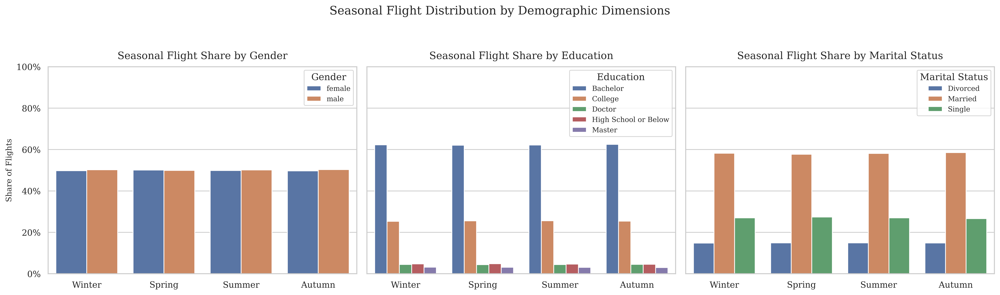

In [280]:
seasons = {
    'Winter': ['Flights_January', 'Flights_February', 'Flights_December'],
    'Spring': ['Flights_March', 'Flights_April', 'Flights_May'],
    'Summer': ['Flights_June', 'Flights_July', 'Flights_August'],
    'Autumn': ['Flights_September', 'Flights_October', 'Flights_November'],
}
season_order = ['Winter', 'Spring', 'Summer', 'Autumn']

def seasonal_summary(df, cat_col):
    out = []
    for season, months in seasons.items():
        tmp = df.groupby(cat_col)[months].sum().sum(axis=1).reset_index(name='TotalFlights')
        tmp['Season'] = season
        out.append(tmp)
    return pd.concat(out, ignore_index=True)

gender_df = seasonal_summary(merged, 'Gender')
education_df = seasonal_summary(merged, 'Education')
marital_df = seasonal_summary(merged, 'Marital Status')

def normalize(df):
    denom = df.groupby('Season')['TotalFlights'].transform('sum')
    df['Share'] = df['TotalFlights'] / denom
    return df

gender_df = normalize(gender_df)
education_df = normalize(education_df)
marital_df = normalize(marital_df)

def order_seasons(df):
    return df.set_index('Season').loc[season_order].reset_index()

gender_df = order_seasons(gender_df)
education_df = order_seasons(education_df)
marital_df = order_seasons(marital_df)

fig, axes = plt.subplots(1, 3, figsize=(18, 5), sharey=True)

plots = [
    (gender_df, 'Gender', axes[0]),
    (education_df, 'Education', axes[1]),
    (marital_df, 'Marital Status', axes[2]),
]

for df, cat, ax in plots:
    sns.barplot(
        data=df,
        x='Season', y='Share', hue=cat,
        order=season_order,
        ax=ax
    )
    ax.set_title(f'Seasonal Flight Share by {cat}', fontsize=13, pad=10)
    ax.set_ylabel('Share of Flights')
    ax.set_xlabel('')
    ax.set_ylim(0, 1)
    ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: f'{y*100:.0f}%'))
    ax.legend(title=cat, loc='upper right', frameon=True)

plt.suptitle('Seasonal Flight Distribution by Demographic Dimensions', fontsize=15, y=1.05)
plt.tight_layout()

The intention behind this analysis was to determine whether certain demographic groups - such as families (married customers) or highly educated individuals - displayed distinct seasonal travel patterns, for example, higher flight volumes during summer vacations or the Christmas period. This would indicate a behavioral segmentation where family or professional factors influence travel timing and loyalty activity.

However, the results show that seasonal variation is largely homogeneous across all demographic groups. Gender, education, and marital status present very similar seasonal distributions, suggesting that travel intensity follows a collective market trend rather than personal or household characteristics. In other words, families do not seem to travel disproportionately more during Summer or Winter, nor do education levels correspond to particular flight peaks. Seasonality thus appears to reflect industry-wide demand cycles rather than differences in customer profile or lifestyle.

### 8.6.3 Evolution of the number of Flights over the years by Numerical Features

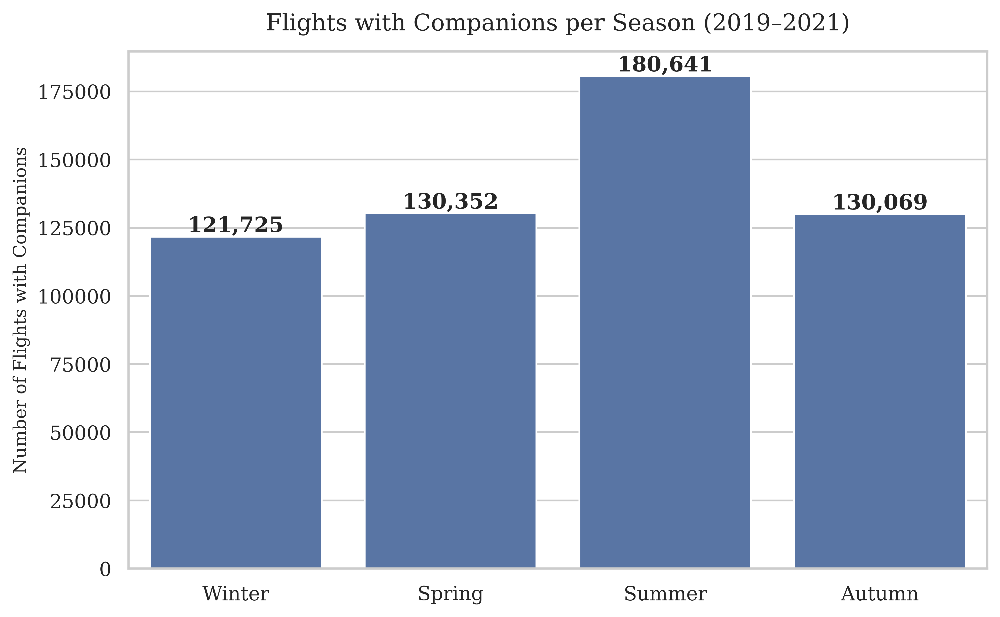

In [281]:
seasons = {
    'Winter': ['Flights_January', 'Flights_February', 'Flights_December'],
    'Spring': ['Flights_March', 'Flights_April', 'Flights_May'],
    'Summer': ['Flights_June', 'Flights_July', 'Flights_August'],
    'Autumn': ['Flights_September', 'Flights_October', 'Flights_November'],
}
season_order = ['Winter', 'Spring', 'Summer', 'Autumn']

season_data = []
for season, months in seasons.items():
    total_flights = merged[months].sum().sum()
    flights_with_companions = (
        merged['TotalFlightsWithCompanions'] *
        merged[months].sum(axis=1) / merged['TotalFlights'].replace(0, pd.NA)
    ).sum(skipna=True)
    season_data.append((season, flights_with_companions))

season_df = pd.DataFrame(season_data, columns=['Season', 'FlightsWithCompanions'])
season_df = season_df.set_index('Season').loc[season_order].reset_index()

plt.figure(figsize=(8, 5))
ax = sns.barplot(
    data=season_df,
    x='Season', y='FlightsWithCompanions',
    order=season_order
)

ax.set_title('Flights with Companions per Season (2019–2021)', fontsize=13, pad=12)
ax.set_ylabel('Number of Flights with Companions')
ax.set_xlabel('')

for i, v in enumerate(season_df['FlightsWithCompanions']):
    ax.text(i, v + (0.01 * season_df['FlightsWithCompanions'].max()), f'{int(v):,}', 
            ha='center', fontweight='bold')

plt.tight_layout()
plt.show()

The seasonal distribution of flights with companions follows almost the exact same pattern as the overall flight activity observed earlier (with a clear peak during Summer (≈180k flights) and lower values in Winter). This similarity indicates that the rise in accompanied flights is not driven by a particular behavioral preference for traveling with others during specific seasons, but rather reflects the general increase in total flight volume during the high-demand months.

In other words, the relationship between accompanied and total flights is proportional, suggesting that when overall air traffic grows — as in Summer — the number of flights with companions naturally rises as well. There is therefore no strong correlation implying that customers are more inclined to travel with company in certain seasons; instead, the variation is purely structural and follows the same cyclical demand pattern seen across the full dataset.